In [2]:
import tensorflow as tf
import pandas as pd
import matplotlib.pyplot as plt

In [3]:
!pip install scipy==1.5.2

In [4]:
import scipy

In [5]:
scipy.__version__

'1.5.2'

In [6]:
import pkg_resources
pkg_resources.get_distribution('pymatgen').version

'2020.10.9'

In [7]:
!pip install pymatgen==2020.10.09

In [8]:
!pip install rdkit-pypi

In [9]:
pip install --upgrade numpy

Note: you may need to restart the kernel to use updated packages.


In [10]:
import pymatgen
import rdkit


In [11]:
pymatgen.__version__

'2020.10.9'

In [12]:
!pip install xenonpy==0.4.1

In [13]:
import xenonpy

In [14]:
print(xenonpy.__version__)

0.4.1


In [15]:
data = pd.read_csv("iQSPR_sample_data.csv")

In [16]:
data.info

<bound method DataFrame.info of        Unnamed: 0                               SMILES        E  HOMO-LUMO gap
0               1     CC(=O)OC(CC(=O)[O-])C[N+](C)(C)C  177.577       4.352512
1               2        CC(=O)OC(CC(=O)O)C[N+](C)(C)C  185.735       7.513497
2               3             C1=CC(C(C(=C1)C(=O)O)O)O   98.605       4.581348
3               4                              CC(CN)O   83.445       8.034841
4               5                 C(C(=O)COP(=O)(O)O)N   90.877       5.741310
...           ...                                  ...      ...            ...
16669       24994                       CC(CC(OC)OC)OC  153.870       9.082426
16670       24995                 C(C(C(=O)O)N)C(Cl)Cl   81.319       7.022901
16671       24997  CN(C)CCOC1C2=CC=CC=C2CCC3=CC=CC=C13  251.782       5.787295
16672       24998                      CC(=O)OC(CCl)Cl   68.939       7.507783
16673       24999                      CCOC(=O)CCCCCCl  149.883       7.718933

[16674 rows x 4 col

#MEAN CHARACTER LENGTH IS 30

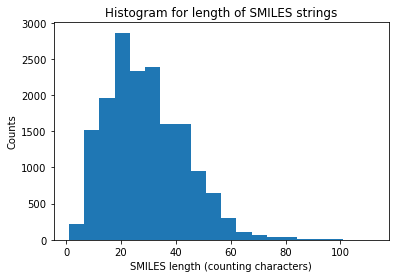

In [17]:
count = [len(x) for x in data['SMILES']]
plt.hist(count, bins=20)  # arguments are passed to np.histogram
plt.title('Histogram for length of SMILES strings')
plt.xlabel('SMILES length (counting characters)')
plt.ylabel('Counts')
plt.show()


In [18]:
# populate the region of HOMO-LUMO gap less than 3 
#and internal energy less than 200

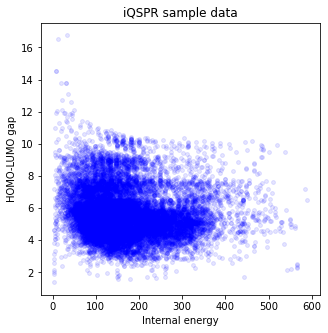

In [23]:
plt.figure(figsize=(5,5))
plt.scatter(data['E'],data['HOMO-LUMO gap'],s=15,c='b',alpha = 0.1)
plt.title('iQSPR sample data')
plt.xlabel('Internal energy')
plt.ylabel('HOMO-LUMO gap')
plt.show()

   index  Unnamed: 0                               SMILES        E  \
0  16101       23630            CC(C)CN1CC(C1)C2=CC=CC=C2  193.542   
1  13275       19222               C1=CC(=CN=C1)C(=O)OCCO  110.998   
2  13879       20189  C1=CC(=CC=C1CC(C(=O)O)N)N(CCCl)CCCl  202.960   
3   5313        7775                    CCCCCC(=O)OCC(C)C  191.230   
4   8254       11881         C1=CC(=C(C=C1O)C(=O)O)C(=O)O   91.482   

   HOMO-LUMO gap  
0       5.914093  
1       5.186226  
2       5.400097  
3       7.727368  
4       4.856441  


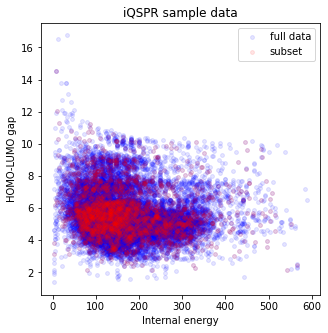

In [24]:
import numpy as np
np.random.seed(201903) # fix the random seed

# extract a subset from the full data set
data_ss = data.sample(3000).reset_index()
print(data_ss.head())

# check target properties: E & HOMO-LUMO gap
plt.figure(figsize=(5,5))
plt.scatter(data['E'],data['HOMO-LUMO gap'],s=15,c='b',alpha = 0.1,label="full data")
plt.scatter(data_ss['E'],data_ss['HOMO-LUMO gap'],s=15,c='r',alpha = 0.1,label="subset")
plt.legend(loc='upper right')
plt.title('iQSPR sample data')
plt.xlabel('Internal energy')
plt.ylabel('HOMO-LUMO gap')
plt.show()

In [25]:
from xenonpy.descriptor import Fingerprints

RDKit_FPs = Fingerprints(featurizers=['ECFP', 'MACCS'], input_type='smiles')

In [26]:
tmp_FPs = RDKit_FPs.transform(data_ss['SMILES'])
print(tmp_FPs.head())

RDKit WARNING: [00:43:57] WARNING: not removing hydrogen atom without neighbors
[00:43:57] WARNING: not removing hydrogen atom without neighbors
RDKit WARNING: [00:43:59] WARNING: not removing hydrogen atom without neighbors
[00:43:59] WARNING: not removing hydrogen atom without neighbors


   maccs:0  maccs:1  maccs:2  maccs:3  maccs:4  maccs:5  maccs:6  maccs:7  \
0        0        0        0        0        0        0        0        0   
1        0        0        0        0        0        0        0        0   
2        0        0        0        0        0        0        0        0   
3        0        0        0        0        0        0        0        0   
4        0        0        0        0        0        0        0        0   

   maccs:8  maccs:9  ...  ecfp3:2038  ecfp3:2039  ecfp3:2040  ecfp3:2041  \
0        1        0  ...           0           0           0           0   
1        0        0  ...           0           0           0           0   
2        0        0  ...           0           0           0           0   
3        0        0  ...           0           0           0           0   
4        0        0  ...           0           0           0           0   

   ecfp3:2042  ecfp3:2043  ecfp3:2044  ecfp3:2045  ecfp3:2046  ecfp3:2047  
0   

In [27]:
# Forward model template in XenonPy-iQSPR
from xenonpy.inverse.iqspr import GaussianLogLikelihood

# write down list of property name(s) for forward models and decide the target region
# (they will be used as a key in whole iQSPR run)
prop = ['E','HOMO-LUMO gap']
target_range = {'E': (0,200), 'HOMO-LUMO gap': (-np.inf, 3)}

# import descriptor class to iQSPR and set the target of region of the properties
prd_mdls = GaussianLogLikelihood(descriptor=RDKit_FPs, targets = target_range)

# train forward models inside iQSPR
prd_mdls.fit(data_ss['SMILES'], data_ss[prop])

# target region can also be updated afterward
prd_mdls.update_targets(reset=True,**target_range)

/opt/conda/lib/python3.7/site-packages/sklearn/base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)
RDKit WARNING: [00:44:03] WARNING: not removing hydrogen atom without neighbors
[00:44:03] WARNING: not removing hydrogen atom without neighbors
RDKit WARNING: [00:44:05] WARNING: not removing hydrogen atom without neighbors
[00:44:05] WARNING: not removing hydrogen atom without neighbors


In [28]:
%%time

pred = prd_mdls.predict(data_ss['SMILES'])
print(pred.head())

RDKit WARNING: [00:44:33] WARNING: not removing hydrogen atom without neighbors
[00:44:33] WARNING: not removing hydrogen atom without neighbors
RDKit WARNING: [00:44:35] WARNING: not removing hydrogen atom without neighbors
[00:44:35] WARNING: not removing hydrogen atom without neighbors


      E: mean     E: std  HOMO-LUMO gap: mean  HOMO-LUMO gap: std
0  216.536505  30.798743             6.448873            0.665549
1  149.048033  30.669020             5.069425            0.662847
2  196.936252  29.520508             5.396384            0.642558
3  223.675992  29.193763             7.784497            0.634831
4   87.747905  30.040543             4.707319            0.648994
CPU times: user 6.1 s, sys: 877 ms, total: 6.98 s
Wall time: 7.09 s


In [29]:
%%time

# calculate log-likelihood for a given target property region
tmp_ll = prd_mdls(data_ss['SMILES'], **target_range)
print(tmp_ll.head())

RDKit WARNING: [00:44:40] WARNING: not removing hydrogen atom without neighbors
[00:44:40] WARNING: not removing hydrogen atom without neighbors
RDKit WARNING: [00:44:43] WARNING: not removing hydrogen atom without neighbors
[00:44:43] WARNING: not removing hydrogen atom without neighbors


          E  HOMO-LUMO gap
0 -1.218542     -16.024975
1 -0.049529      -7.015274
2 -0.613727      -9.251676
3 -1.566933     -31.356100
4 -0.001840      -5.458423
CPU times: user 6.15 s, sys: 947 ms, total: 7.1 s
Wall time: 7.32 s


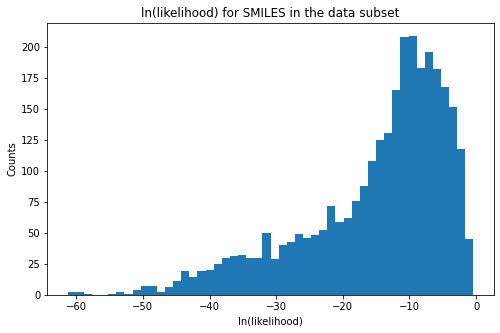

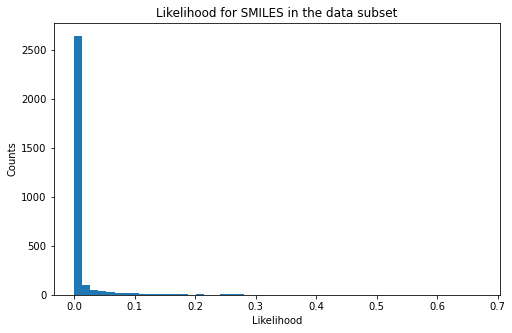

In [30]:
# plot histogram of log-likelihood values
tmp = tmp_ll.sum(axis = 1, skipna = True)

plt.figure(figsize=(8,5))
plt.hist(tmp, bins=50)
plt.title('ln(likelihood) for SMILES in the data subset')
plt.xlabel('ln(likelihood)')
plt.ylabel('Counts')
plt.show()

# plot histogram of likelihood values
plt.figure(figsize=(8,5))
plt.hist(np.exp(tmp), bins=50)
plt.title('Likelihood for SMILES in the data subset')
plt.xlabel('Likelihood')
plt.ylabel('Counts')
plt.show()


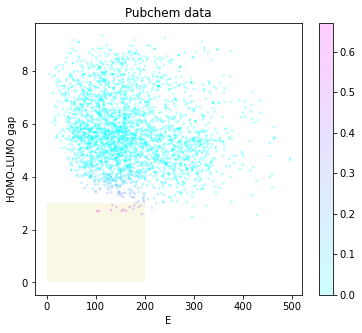

In [31]:
# check the predicted likelihood
dot_scale = 0.1
l_std = np.sqrt(pred['E: std']**2+pred['HOMO-LUMO gap: std']**2)

plt.figure(figsize=(6,5))
rectangle = plt.Rectangle((0,0),200,3,fc='y',alpha=0.1)
plt.gca().add_patch(rectangle)
im = plt.scatter(pred['E: mean'], pred['HOMO-LUMO gap: mean'], s=l_std*dot_scale, c=np.exp(tmp),alpha = 0.2,cmap=plt.get_cmap('cool'))
plt.title('Pubchem data')
plt.xlabel('E')
plt.ylabel('HOMO-LUMO gap')
plt.colorbar(im)
plt.show()

In [32]:
# N-gram library in XenonPy-iQSPR
from xenonpy.inverse.iqspr import NGram

In [33]:
from rdkit.Chem import AllChem

RDKit WARNING: [00:44:47] WARNING: not removing hydrogen atom without neighbors
[00:44:47] WARNING: not removing hydrogen atom without neighbors
RDKit ERROR: [00:44:50] Explicit valence for atom # 1 Br, 5, is greater than permitted
[00:44:50] Explicit valence for atom # 1 Br, 5, is greater than permitted
RDKit WARNING: [00:44:50] WARNING: not removing hydrogen atom without neighbors
[00:44:50] WARNING: not removing hydrogen atom without neighbors
RDKit WARNING: [00:44:50] WARNING: not removing hydrogen atom without neighbors
[00:44:50] WARNING: not removing hydrogen atom without neighbors


FBr(F)(F)(F)F


RDKit WARNING: [00:44:51] WARNING: not removing hydrogen atom without neighbors
[00:44:51] WARNING: not removing hydrogen atom without neighbors


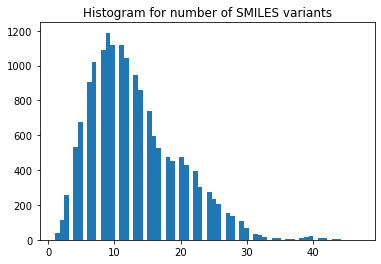

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [34]:
%%time
import numpy as np
# N-gram library in XenonPy-iQSPR
from xenonpy.inverse.iqspr import NGram

np.random.seed(201906) # fix the random seed

# Method 2: expand n-gram training set with randomly reordered SMILES
# (we show one of the many possible ways of doing it)
n_reorder = 15 # pick a fixed number of re-ordering

# convert the SMILES to canonical SMILES in RDKit (not necessary in general)
cans = []
i = 0
for smi in data['SMILES']:
    # remove some molecules in the full SMILES list that may lead to error
    try:
        cans.append(AllChem.MolToSmiles(AllChem.MolFromSmiles(smi)))
    except:
        i+=1
        print(smi)
        pass
#print(cans)
#print(i)
mols = [AllChem.MolFromSmiles(smi) for smi in cans]
smi_reorder_all = []
smi_reorder = []
for mol in mols:
    idx = list(range(mol.GetNumAtoms()))
    tmp = [AllChem.MolToSmiles(mol,rootedAtAtom=x) for x in range(len(idx))]
    smi_reorder_all.append(np.array(list(set(tmp))))
    smi_reorder.append(np.random.choice(smi_reorder_all[-1],n_reorder,
                                        replace=(len(smi_reorder_all[-1]) < n_reorder)))

n_uni = [len(x) for x in smi_reorder_all]
plt.hist(n_uni, bins='auto')  # arguments are passed to np.histogram
plt.title("Histogram for number of SMILES variants")
plt.show()
print(smi_reorder)

In [35]:
import sklearn
print(sklearn.__version__)

0.22


In [36]:
!pip install -U scikit-learn==0.22.0

In [37]:
import pickle as pk
with open('ngram_pubchem_ikebata_reO15_O10.obj', 'rb') as f:
    n_gram = pk.load(f)

# load a pre-trained n-gram from the pickle file
with open('ngram_pubchem_ikebata_reO15_O11to20.obj', 'rb') as f:
    n_gram2 = pk.load(f)

k = n_gram.merge_table(n_gram2)

In [38]:
n_gram2._table

[[[Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: []],
  [Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: []]],
 [[Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   Index: [],
   Empty DataFrame
   Columns: []
   

In [39]:
print(n_gram)
print(n_gram2)

NGram(del_range=(1, 10), max_len=1000, min_len=1, ngram_tab=None,
      reorder_prob=0.5, sample_order=(1, 10))
NGram(del_range=(1, 10), max_len=1000, min_len=11, ngram_tab=None,
      reorder_prob=0.5, sample_order=(11, 10))


/opt/conda/lib/python3.7/site-packages/sklearn/base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


In [40]:
np.random.seed(201903) # fix the random seed

# perform pure iQSPR molecule generation starting with 5 initial molecules
n_loop = 5
tmp = data_ss['SMILES'][:5]
print(tmp)
for i in range(n_loop):
    tmp = k.proposal(tmp)
    print('Round %i' % i,tmp)

/opt/conda/lib/python3.7/site-packages/pandas/core/series.py:1169: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_values(loc, value)
/opt/conda/lib/python3.7/site-packages/xenonpy/inverse/iqspr/modifier.py:404: RuntimeWarning: get_prob: ['C', '&', '=C', 'C', '(', '=C', 'N', '=C', 0] not found in NGram, iB=1, iR=0
  warnings.warn('get_prob: %s not found in NGram, iB=%i, iR=%i' % (tmp_str, iB, iR), RuntimeWarning)
RDKit ERROR: [00:45:45] Explicit valence for atom # 12 N, 4, is greater than permitted
[00:45:45] Explicit valence for atom # 12 N, 4, is greater than permitted
/opt/conda/lib/python3.7/site-packages/xenonpy/inverse/iqspr/modifier.py:527: RuntimeWarning: can not convert C1=CC(=CC=C1CC(C(=O)O)N)N(CC(=O)[O-])(C)C to Mol
  warnings.warn('can not convert %s to Mol' % new_smi, RuntimeWarnin

0              CC(C)CN1CC(C1)C2=CC=CC=C2
1                 C1=CC(=CN=C1)C(=O)OCCO
2    C1=CC(=CC=C1CC(C(=O)O)N)N(CCCl)CCCl
3                      CCCCCC(=O)OCC(C)C
4           C1=CC(=C(C=C1O)C(=O)O)C(=O)O
Name: SMILES, dtype: object
Round 0 ['C1C(c2ccccc2)CN1CC(CC(=O)O)OC(C)=O', 'C1=CC(=CN=C1)C(=O)OCCO', 'C1=CC(=CC=C1CC(C(=O)O)N)N(CCCl)CCCl', 'CCCCCC(=O)OC(CC(=O)[O-])C[N+](C)(C)C', 'C1=CC(=C(C=C1O)C(CC(=O)O)=O)O']
Round 1 ['C1C(c2ccccc2)CN1CC(CC(=O)O)OC(C)=O', 'OCCOC(=O)c1cc([N+](=O)[O-])ccc1Cl', 'C(c1ccc(N(CCCl)CCCl)cc1)C(C[N+](C)(C)C)C[N+](C)(C)C', 'CCCCCC(=O)OC(CC(=O)[O-])C[N+](C)(C)C', 'O=C(O)CC(=O)c1cc(O)ccc1Cl']
Round 2 ['C1C(c2ccccc2)CN1CC(CC(=O)O)OC(C)=O', 'OCCOC(=O)c1cc([N+](=O)[O-])ccc1Cl', 'C(c1ccc(N(CCCl)CCCl)cc1)C(C[N+](C)(C)C)C[N+](C)(C)C', 'CCCCCC(=O)OC(CC(=O)[O-])C[N+](C)(C)C', 'O=C(O)CC(=O)c1cc([N+](=O)[O-])ccc1Cl']
Round 3 ['C1C(c2ccccc2)CN1CC(CC(=O)O)OC(C)=O', 'OCCOC(=O)c1cc([N+](=O)[O-])ccc1Cl', 'C(c1ccc(N(CCCl)CCCl)cc1)C(C[N+](C)(C)C)C[N+](C)(C)C', 'CCCCCC(=O)OC(CC

/opt/conda/lib/python3.7/site-packages/xenonpy/inverse/iqspr/modifier.py:404: RuntimeWarning: get_prob: ['O', '(', 'C', ')', 'C', '(', 'C', ')', 'C', 'N', '&', 'C', 'C', '(', 'c', '&', 'c', 'c'] not found in NGram, iB=1, iR=2
  warnings.warn('get_prob: %s not found in NGram, iB=%i, iR=%i' % (tmp_str, iB, iR), RuntimeWarning)


Round 4 ['C1C(c2ccccc2)CN1CC(CC(=O)O)OC(C)=O', 'OCCOC(=O)c1cc([N+](=O)[O-])ccc1Cl', 'C(c1ccc(N(CCCl)CCCl)cc1)C(C[N+](C)(C)C)C[N+](C)(C)C', 'CCCCCC(=O)OC(CC(=O)[O-])C[N+](C)(C)C', 'c1(Cl)ccc([N+](=O)[O-])cc1Cl']


RDKit ERROR: [00:45:45] Can't kekulize mol.  Unkekulized atoms: 0 13 14 15 23 24 25
[00:45:45] Can't kekulize mol.  Unkekulized atoms: 0 13 14 15 23 24 25

RDKit ERROR: 
/opt/conda/lib/python3.7/site-packages/xenonpy/inverse/iqspr/modifier.py:527: RuntimeWarning: can not convert c1(CC(C[N+](C)(C)C)C[N+](C)(C)C)ccc(N(CCCl)CCCl)ccc1Cl to Mol
  warnings.warn('can not convert %s to Mol' % new_smi, RuntimeWarning)
RDKit ERROR: [00:45:45] Can't kekulize mol.  Unkekulized atoms: 0 2 3 4 8 9 10
[00:45:45] Can't kekulize mol.  Unkekulized atoms: 0 2 3 4 8 9 10

RDKit ERROR: 
/opt/conda/lib/python3.7/site-packages/xenonpy/inverse/iqspr/modifier.py:527: RuntimeWarning: can not convert c1(Cl)ccc([N+](=O)[O-])ccc1Cl to Mol
  warnings.warn('can not convert %s to Mol' % new_smi, RuntimeWarning)


In [70]:
smiles_list = []
for i in data_ss['SMILES'][:5]:
    smiles_list.append(i)
    

In [71]:
round_2= ['C1C(c2ccccc2)CN1CC(CC(=O)O)OC(C)=O', 'OCCOC(=O)c1cc([N+](=O)[O-])ccc1Cl', 'C(c1ccc(N(CCCl)CCCl)cc1)C(C[N+](C)(C)C)C[N+](C)(C)C', 'CCCCCC(=O)OC(CC(=O)[O-])C[N+](C)(C)C', 'O=C(O)CC(=O)c1cc([N+](=O)[O-])ccc1Cl']

In [75]:
mol_list = [AllChem.MolFromSmiles(smiles) for smiles in round_2]
print(mol_list)
img = Draw.MolsToGridImage(mol_list)

[<rdkit.Chem.rdchem.Mol object at 0x7f73d8407ad0>, <rdkit.Chem.rdchem.Mol object at 0x7f73d7d33bc0>, <rdkit.Chem.rdchem.Mol object at 0x7f73d7d33b20>, <rdkit.Chem.rdchem.Mol object at 0x7f73d7d337b0>, <rdkit.Chem.rdchem.Mol object at 0x7f73d7d33260>]


In [79]:
for i in mol_list:
    print(Draw.MolToImage(i))

<PIL.PngImagePlugin.PngImageFile image mode=RGB size=300x300 at 0x7F73D8822790>
<PIL.PngImagePlugin.PngImageFile image mode=RGB size=300x300 at 0x7F73D88229D0>
<PIL.PngImagePlugin.PngImageFile image mode=RGB size=300x300 at 0x7F73D8822890>
<PIL.PngImagePlugin.PngImageFile image mode=RGB size=300x300 at 0x7F73D8822B90>
<PIL.PngImagePlugin.PngImageFile image mode=RGB size=300x300 at 0x7F73D8822C90>


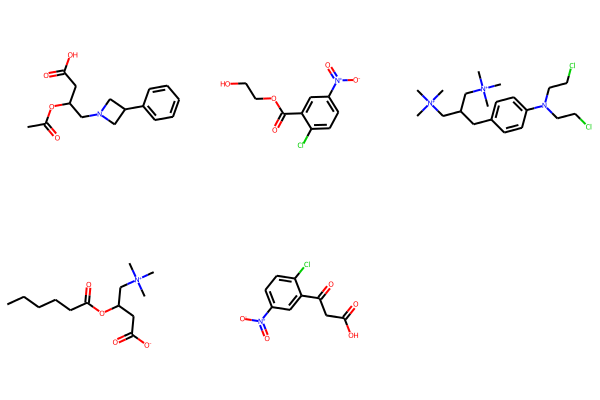

In [76]:
img

In [ ]:
AllChem.MolFromSmiles(AllChem.MolFromSmiles("CC(C)CN1CC(C1)C2=CC=CC=C2"))

In [44]:
from rdkit.Chem import Draw

In [ ]:
img

In [ ]:
k._table[0][1]

In [48]:
np.random.seed(201908)  # fix the random seed

cans = [AllChem.MolToSmiles(AllChem.MolFromSmiles(smi)) for i, smi in enumerate(data_ss['SMILES'])
       if (data_ss['HOMO-LUMO gap'].iloc[i] > 4)]

init_samples = np.random.choice(cans, 25)

print(init_samples)

['C=COCCCCCC' 'Cc1cnc[nH]1' 'COC(=O)c1ccccc1NC(C)=O'
 'CCCCCCNC(=O)n1cc(F)c(=O)[nH]c1=O' 'O=C(CO)COP(=O)(O)O'
 'O=c1oc2ccc([N+](=O)[O-])cc2cc1-c1ccncc1'
 'CC(C)C(CCCN1CCCC1)(C(N)=O)c1cccc2ccccc12'
 'NC(=NCCCCCCN=C(N)N=C(N)Nc1ccc(Cl)cc1)N=C(N)Nc1ccc(Cl)cc1' 'O=C1CCCCCN1'
 'CCCCCCCCCCCCCCCC(=O)OCCCCCC(C)C' 'Cc1ccccc1CCl'
 'CC(=O)Nc1ccc(Oc2ccc(N)cc2)cc1' 'OC1CCOC1'
 'CCN1CCCC1CCOC(=O)C(OC)(c1ccccc1)c1ccccc1' 'NC(=O)CCc1ccccc1'
 'CCOC(=O)Nc1nc2ccccc2[nH]1' 'Brc1c(Br)c(Br)c2n[nH]nc2c1Br'
 'c1ccc2c(c1)c1ccccc1c1ccccc21' 'C=CC1CCCCC1' 'Oc1cc(O)c2ccccc2c1'
 'CCC1(C2=CCCCCC2)C(=O)NC(=O)NC1=O' 'CCCNN1CCCCCC1' 'NC1CCCC1c1ccccc1'
 'O=C(Nc1cc(Cl)ccc1Cl)c1cc(Cl)cc(-c2ccccc2)c1O' 'CC(C)NC(N)=O']


RDKit WARNING: [00:48:48] WARNING: not removing hydrogen atom without neighbors
[00:48:48] WARNING: not removing hydrogen atom without neighbors


In [49]:
print(init_samples)

['C=COCCCCCC' 'Cc1cnc[nH]1' 'COC(=O)c1ccccc1NC(C)=O'
 'CCCCCCNC(=O)n1cc(F)c(=O)[nH]c1=O' 'O=C(CO)COP(=O)(O)O'
 'O=c1oc2ccc([N+](=O)[O-])cc2cc1-c1ccncc1'
 'CC(C)C(CCCN1CCCC1)(C(N)=O)c1cccc2ccccc12'
 'NC(=NCCCCCCN=C(N)N=C(N)Nc1ccc(Cl)cc1)N=C(N)Nc1ccc(Cl)cc1' 'O=C1CCCCCN1'
 'CCCCCCCCCCCCCCCC(=O)OCCCCCC(C)C' 'Cc1ccccc1CCl'
 'CC(=O)Nc1ccc(Oc2ccc(N)cc2)cc1' 'OC1CCOC1'
 'CCN1CCCC1CCOC(=O)C(OC)(c1ccccc1)c1ccccc1' 'NC(=O)CCc1ccccc1'
 'CCOC(=O)Nc1nc2ccccc2[nH]1' 'Brc1c(Br)c(Br)c2n[nH]nc2c1Br'
 'c1ccc2c(c1)c1ccccc1c1ccccc21' 'C=CC1CCCCC1' 'Oc1cc(O)c2ccccc2c1'
 'CCC1(C2=CCCCCC2)C(=O)NC(=O)NC1=O' 'CCCNN1CCCCCC1' 'NC1CCCC1c1ccccc1'
 'O=C(Nc1cc(Cl)ccc1Cl)c1cc(Cl)cc(-c2ccccc2)c1O' 'CC(C)NC(N)=O']


In [50]:
# set up annealing schedule in iQSPR
beta = np.hstack([np.linspace(0.01,0.2,20),np.linspace(0.21,0.4,10),np.linspace(0.4,1,10),np.linspace(1,1,10)])
print('Number of steps: %i' % len(beta))
print(beta)

Number of steps: 50
[0.01       0.02       0.03       0.04       0.05       0.06
 0.07       0.08       0.09       0.1        0.11       0.12
 0.13       0.14       0.15       0.16       0.17       0.18
 0.19       0.2        0.21       0.23111111 0.25222222 0.27333333
 0.29444444 0.31555556 0.33666667 0.35777778 0.37888889 0.4
 0.4        0.46666667 0.53333333 0.6        0.66666667 0.73333333
 0.8        0.86666667 0.93333333 1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         1.        ]


In [46]:
print(iqspr_reorder)

NameError: name 'iqspr_reorder' is not defined

In [51]:
%%time

# library for running iQSPR in XenonPy-iQSPR
from xenonpy.inverse.iqspr import IQSPR

# update NGram parameters for this exampleHOMO-LUMO gap
n_gram.set_params(del_range=[1,20],max_len=500, reorder_prob=0.5, sample_order=(1,20))

# set up likelihood and n-gram models in iQSPR
iqspr_reorder = IQSPR(estimator=prd_mdls, modifier=n_gram)

np.random.seed(201908) # fix the random seed
# main loop of iQSPR
iqspr_samples1, iqspr_loglike1, iqspr_prob1, iqspr_freq1 = [], [], [], []
for s, ll, p, freq in iqspr_reorder(init_samples, beta, yield_lpf=True):
    iqspr_samples1.append(s)
    iqspr_loglike1.append(ll)
    iqspr_prob1.append(p)
    iqspr_freq1.append(freq)
# record all outputs
iqspr_results_reorder = {
    "samples": iqspr_samples1,
    "loglike": iqspr_loglike1,
    "prob": iqspr_prob1,
    "freq": iqspr_freq1,
    "beta": beta
}
# save results
with open('iQSPR_results_reorder.obj', 'wb') as f:
    pk.dump(iqspr_results_reorder, f)

/opt/conda/lib/python3.7/site-packages/pandas/core/series.py:1169: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_values(loc, value)
RDKit ERROR: [00:48:55] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20
[00:48:55] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20

RDKit ERROR: 
/opt/conda/lib/python3.7/site-packages/xenonpy/inverse/iqspr/modifier.py:527: RuntimeWarning: can not convert c1ccc2c3ccccc3c3cc4ccccc4cc3c12 to Mol
  warnings.warn('can not convert %s to Mol' % new_smi, RuntimeWarning)
RDKit ERROR: [00:48:57] Explicit valence for atom # 2 C, 5, is greater than permitted
[00:48:57] Explicit valence for atom # 2 C, 5, is greater than permitted
/opt/conda/lib/python3.7/site-packages/xenonpy/inverse/i

CPU times: user 2min 31s, sys: 27.3 s, total: 2min 58s
Wall time: 2min 47s


In [52]:
with open('iQSPR_results_reorder.obj', 'rb') as f:
    iqspr_results_reorder = pk.load(f)

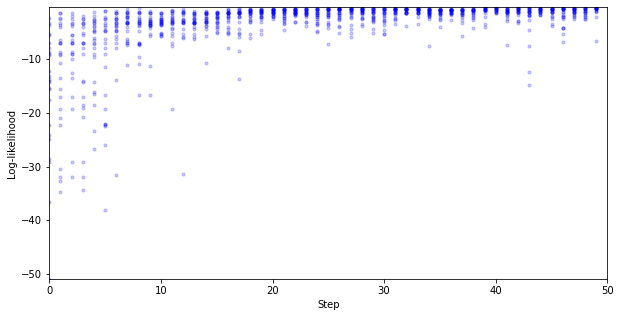

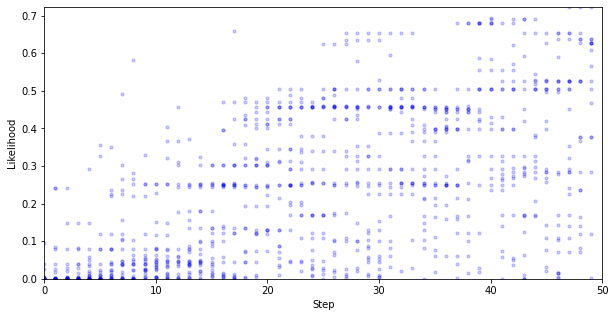

In [53]:
# plot the likelihood evolution

# set up the min and max boundary for the plots
tmp_list = [x.sum(axis = 1, skipna = True).values for x in iqspr_results_reorder["loglike"]]
flat_list = np.asarray([item for sublist in tmp_list for item in sublist])
y_max, y_min = max(flat_list), min(flat_list)

plt.figure(figsize=(10,5))
plt.xlim(0,len(iqspr_results_reorder["loglike"]))
plt.ylim(y_min,y_max)
plt.xlabel('Step')
plt.ylabel('Log-likelihood')
for i, ll in enumerate(tmp_list):
    plt.scatter([i]*len(ll), ll ,s=10, c='b', alpha=0.2)
plt.show()
#plt.savefig('iqspr_loglike_reorder.png',dpi = 500)
#plt.close()

y_max, y_min = np.exp(y_max), np.exp(y_min)
plt.figure(figsize=(10,5))
plt.xlim(0,len(iqspr_results_reorder["loglike"]))
plt.ylim(y_min,y_max)
plt.xlabel('Step')
plt.ylabel('Likelihood')
for i, ll in enumerate(tmp_list):
    plt.scatter([i]*len(ll), np.exp(ll) ,s=10, c='b', alpha=0.2)
plt.show()
#plt.savefig('iqspr_like_reorder.png',dpi = 500)
#plt.close()


In [54]:
%%time

# re-calculate the property values for the proposed molecules
x_mean, x_std, y_mean, y_std = [], [], [], []
r_std = []
FPs_samples = []
for i, smis in enumerate(iqspr_results_reorder["samples"]):
    tmp_fps = RDKit_FPs.transform(smis)
    #print(tmp_fps)
    FPs_samples.append(tmp_fps)
    smis = smis.reshape(-1,1)
    tmp1, *tmp2 = prd_mdls["E"].predict(tmp_fps)
    #print(tmp1)
    x_mean.append(tmp1)
    x_std.append(tmp2)

    tmp1, *tmp2 = prd_mdls["HOMO-LUMO gap"].predict(tmp_fps)
    #print(tmp1)
    y_mean.append(tmp1)
    y_std.append(tmp2)
    #print(y_mean)
    r_std.append([np.sqrt(x_std[-1][i]**2 + y_std[-1][i]**2) for i in range(len(x_std[-1]))])
    #print(r_std)
#print(r_std)
#print(y_std)
# flatten the list for max/min calculation
flat_list = [item for sublist in r_std for item in sublist]
print('Range of std. dev.: (%.4f,%.4f)' % (min(flat_list),max(flat_list)))

Range of std. dev.: (25.1993,434.6119)
CPU times: user 5.2 s, sys: 12.1 s, total: 17.3 s
Wall time: 29.2 s


[159.28182734 165.90065618 168.80255761 ... 197.22760815 174.17572259
 170.34203719]
[[159.2818273430767, 165.90065618433266, 168.80255760894948, 333.3406709505726, 108.34706245604038, 216.9956674440595, 373.88655557961437, 214.049634420512, 184.25161106537118, 310.15613860528026, 130.82628235866878, 131.12659787088919, 85.51270232225299, 80.62286365244613, 322.9838785470436, 122.20338922901635, 161.0356703896896, 79.61807466400013, 174.91345761417216, 120.16020116051011, 125.2389375111859, 92.06436300049927, 101.68839412408242, 112.25479172643746], [38.47290373843303, 106.21209104349839, 130.62885521071823, 111.28042872912566, 93.58233118864987, 253.70084239921272, 216.9956674440595, 214.049634420512, 310.15613860528026, 130.82628235866878, 48.777877586744985, 168.75855971055645, 66.17551939063742, 174.91345761417216, 29.763885997033388, 126.80284528233922, 53.12430209854407, 111.28042872912566, 168.37963297789193, 101.68839412408242, 126.80284528233922, 121.47122358732402, 112.254791

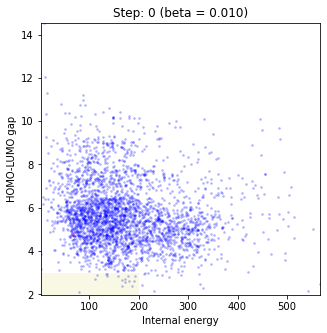

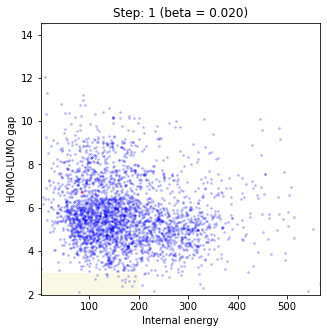

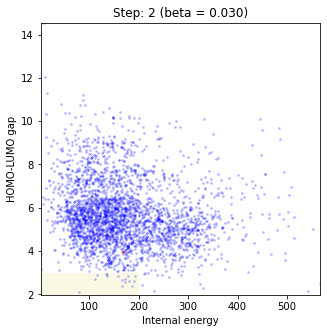

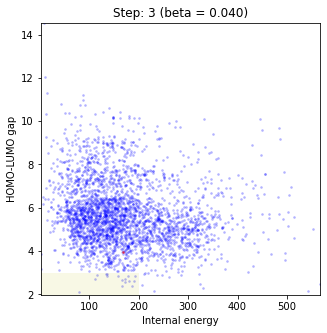

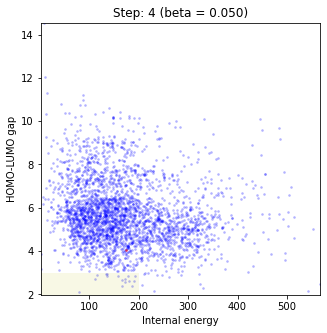

...

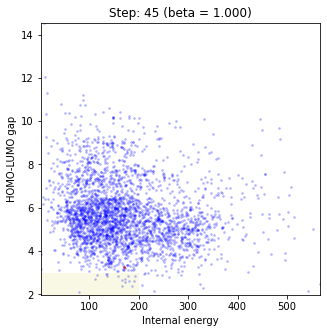

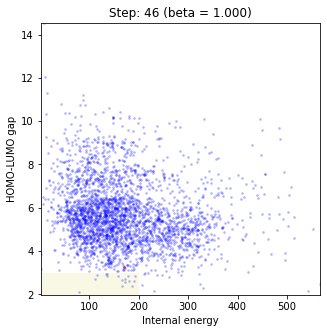

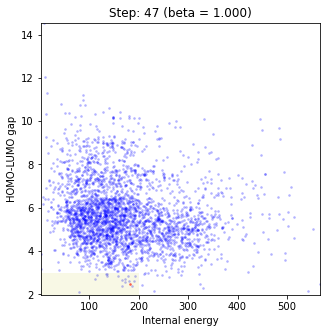

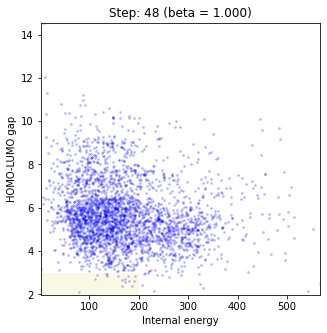

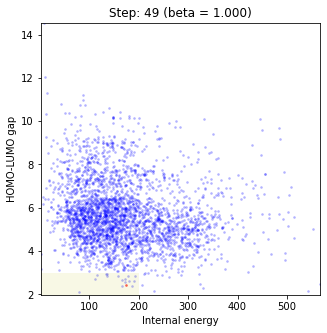

CPU times: user 27.6 s, sys: 5.99 s, total: 33.6 s
Wall time: 21.9 s


In [92]:
%%time

import os

# prepare a folder to save all the figures
ini_dir = './iQSPR_tutorial_prd_2/'
if not os.path.exists(ini_dir):
    os.makedirs(ini_dir)

flat_list = np.asarray([item for sublist in r_std for item in sublist])
print(flat_list)
print(r_std)
s_max, s_min = max(flat_list), min(flat_list)
flat_list = np.concatenate((data_ss["E"],
    np.asarray([item for sublist in [x_mean] for item in sublist])))
print(flat_list)
x_max, x_min = max(flat_list), min(flat_list)
flat_list = np.concatenate((data_ss["HOMO-LUMO gap"],
    np.asarray([item for sublist in [y_mean] for item in sublist])))
y_max, y_min = max(flat_list), min(flat_list)
tmp_beta = iqspr_results_reorder["beta"]

for i in range(len(r_std)):
    dot_size = 45*((np.asarray(r_std[i])-s_min)/(s_max-s_min)) + 5
    plt.figure(figsize=(5,5))
    rectangle = plt.Rectangle((0,0),200,3,fc='y',alpha=0.1)
    plt.gca().add_patch(rectangle)
    plt.scatter(data_ss["E"], data_ss["HOMO-LUMO gap"],s=3, c='b', alpha=0.2)
    plt.scatter(x_mean[i], y_mean[i],s=3, c='r', alpha=0.5)
    plt.title('Step: %i (beta = %.3f)' % (i,tmp_beta[i]))
    plt.xlim(x_min,x_max)
    plt.ylim(y_min,y_max)
    plt.xlabel('Internal energy')
    plt.ylabel('HOMO-LUMO gap')
    plt.show()
    plt.savefig(ini_dir+'Step_%02i.png' % i,dpi = 500)
    plt.close()

['O=c1oc2ccc([N+](=O)[O-])cc2cc1-c1ccncc1'
 'O=C(Nc1cc(Cl)ccc1Cl)c1cc(Cl)cc(-c2ccccc2)c1O' 'Oc1cc(O)c2ccccc2c1'
 'CC(=O)Nc1ccc(Oc2ccc(N)cc2)cc1' 'Brc1c(Br)c(Br)c2n[nH]nc2c1Br'
 'CCOC(=O)Nc1nc2ccccc2[nH]1' 'COC(=O)c1ccccc1NC(C)=O'
 'c1ccc2c(c1)c1ccccc1c1ccccc21' 'CCC1(C2=CCCCCC2)C(=O)NC(=O)NC1=O'
 'CCCCCCNC(=O)n1cc(F)c(=O)[nH]c1=O' 'Cc1ccccc1CCl' 'NC(=O)CCc1ccccc1'
 'NC1CCCC1c1ccccc1' 'CC(C)C(CCCN1CCCC1)(C(N)=O)c1cccc2ccccc12'
 'NC(=NCCCCCCN=C(N)N=C(N)Nc1ccc(Cl)cc1)N=C(N)Nc1ccc(Cl)cc1'
 'O=C(CO)COP(=O)(O)O' 'CCN1CCCC1CCOC(=O)C(OC)(c1ccccc1)c1ccccc1'
 'Cc1cnc[nH]1' 'O=C1CCCCCN1' 'CCCNN1CCCCCC1' 'C=CC1CCCCC1' 'CC(C)NC(N)=O'
 'C=COCCCCCC' 'OC1CCOC1' 'CCCCCCCCCCCCCCCC(=O)OCCCCCC(C)C']


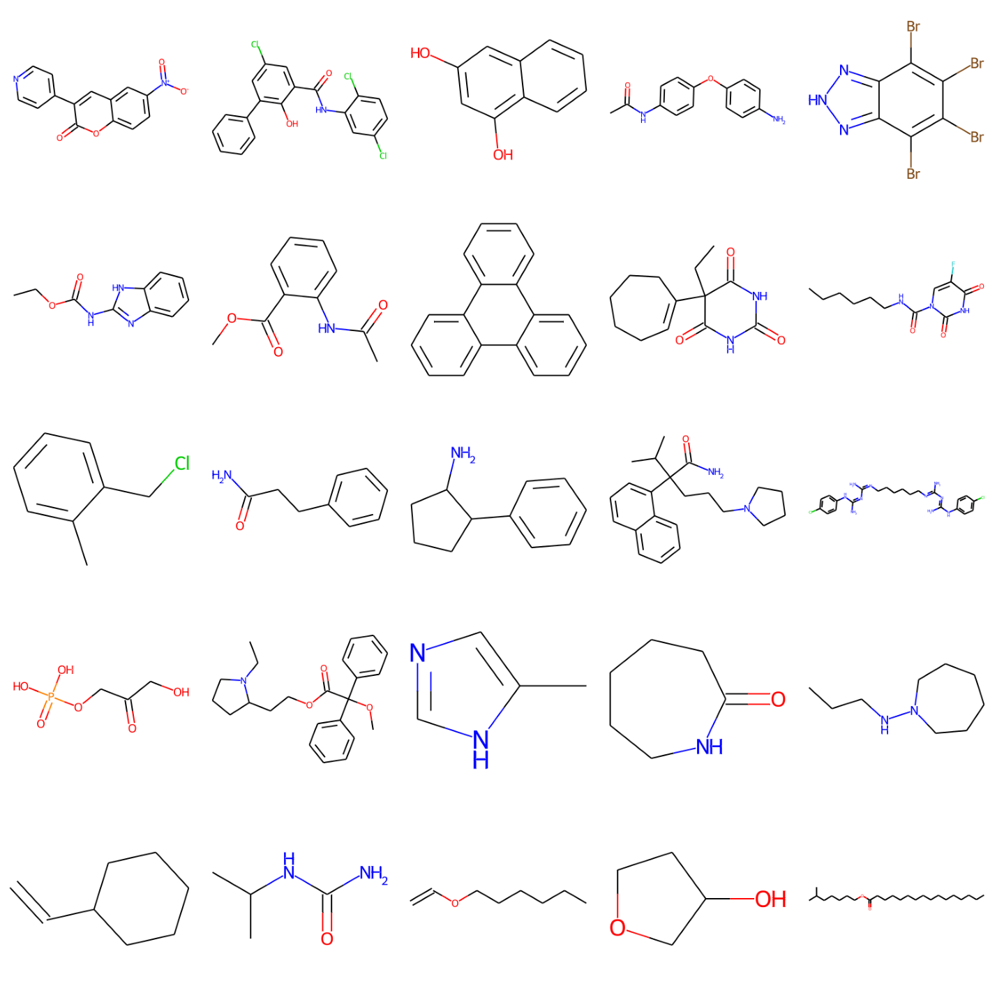

['c1cc([N+](=O)[O-])cc2cc(-c3ccccn3)c(=O)oc12'
 'O=c1oc2ccc([N+](=O)[O-])cc2cc1-c1ccccn1'
 'COC(=O)c1ccccc1NC(=O)C=Cc1ccccc1'
 'c1c(Cl)ccc(Cl)c1NC(=O)c1cc(Cl)cc(-c2ccc(Cl)cc2)c1O'
 'Clc1ccc(Cl)cc1NC(=O)c1cc(Cl)cc(-c2ccccc2)c1O' 'c1c(O)cc(O)c2ccccc12'
 'c1cc([N+](=O)[O-])ccc1Oc1c(Cl)cc(Cl)cc1Cl'
 'C1CCCN(NCC(O)O)C=CC=C(C(=O)O)C1' 'c1(C(=O)O)=CC=CC(O)C1O'
 'C1(C(=O)O)=CC=CC(O)C1O' 'CCOC(=O)Nc1nc2ccccc2[nH]1'
 'c1ccc2c(c1)c1ccccc1c1ccccc21' 'CCC1(C2=CCCCCC2)C(=O)NC(=O)NC1=O'
 'CCCCCCNC(=O)n1cc(F)c(=O)[nH]c1=O'
 'c1ccccc1C(OC)(C(=O)OCCC(C)N(C)C)c1ccccc1'
 'C(OP(=O)(O)OP(=O)(O)O)C(=O)CN'
 'CCN1CCCC1CCOC(=O)C(OC)(c1ccccc1)c1ccccc1' 'C(OP(=O)(O)O)C(=O)CN'
 'C(=O)COP(=O)(O)O' 'C(C)=O' 'C1CC=CC1O' 'OP(=O)(O)O' 'N' 'CN'
 'COP(=O)(O)O']


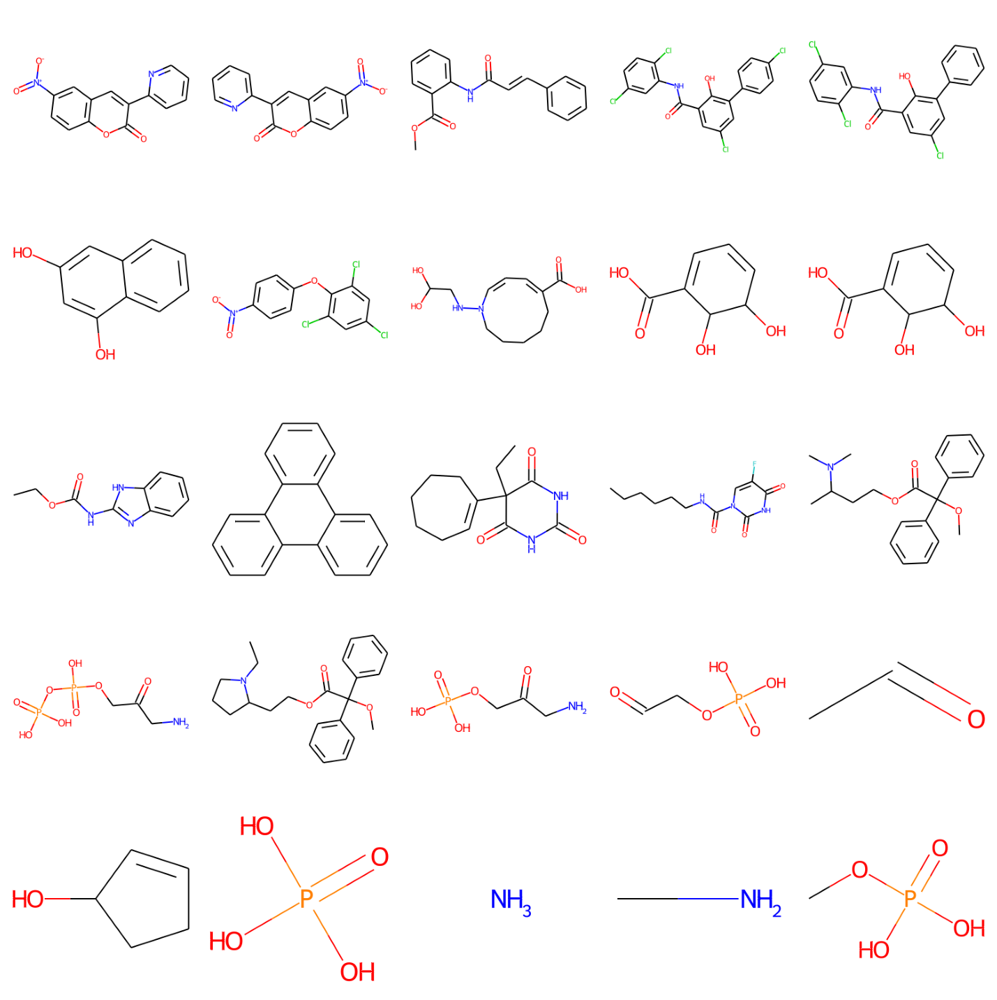

['O=c1oc2ccc([N+](=O)[O-])cc2cc1-c1ccccn1'
 'c1cc([N+](=O)[O-])cc2cc3ccccc3cc12'
 'C(=O)(Nc1cc(Cl)ccc1Cl)c1cc(Cl)cc(-c2ccc(Cl)cc2)c1O'
 'Clc1ccc(Cl)cc1NC(=O)c1cc(Cl)cc(-c2ccccc2)c1O' 'C(=O)C1=CC=CC(O)C1O'
 'c1ccc2c(c1)c1ccccc1c1c3ccccc3ccc21'
 'C(=O)(Nc1nc2ccccc2[nH]1)OC(C)(C)C#C' 'c1cc([N+](=O)[O-])ccc1OC'
 'N(CC(O)O)N1C=CC=C(C(=O)O)C1O' 'c1(C(=O)O)=CC=CC(O)C1O'
 'COC(=O)c1ccccc1O' 'CCOC(=O)Nc1nc2ccccc2[nH]1'
 'c1ccc2c(c1)c1ccccc1c1ccccc21' 'C(C)C1(C2=CCCCCC2)C(=O)NC(=O)NC1=O'
 'CCC1(C2=CCCCCC2)C(=O)NC(=O)NC1=O' 'C1=C(C(=O)O)C(O)CC(C(=C)C)C1'
 'OP(=O)(OCC(=O)CN)OP(=O)(O)N(CC)CC' 'C(OP(=O)(O)OP(=O)(O)O)C(=O)CN'
 'O=C(CN)COP(=O)(O)O' 'C(=O)COP(=O)(O)O' 'C(C)OC(C)=O' 'N']
skipped
skipped
skipped


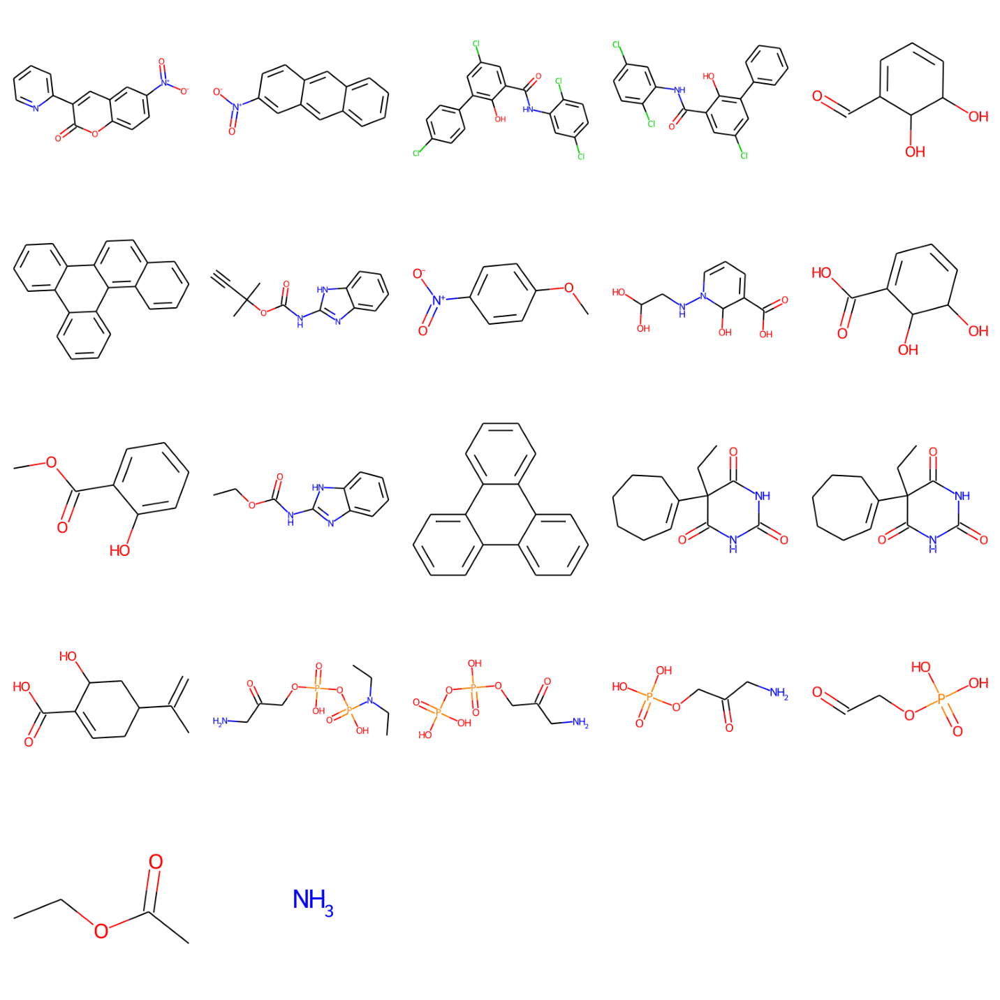

['c1ccc2cc3ccc([N+](=O)[O-])cc3cc2c1'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)CCO)cc1'
 'C(=O)(Nc1cc(Cl)ccc1Cl)c1cc(Cl)cc(-c2ccc(Cl)cc2)c1O'
 'c1(Cl)ccc(Cl)cc1NC(=O)c1cc(Cl)cc(-c2ccccc2)c1O'
 'C(=O)(Nc1cc(Cl)ccc1Cl)c1cc(Cl)cc(-c2ccccc2)c1O' 'C(=O)C1=CC=CC(O)C1O'
 'O=C(O)C1=CC=CN(NCC(O)[O-])C1O' 'c1cc([N+](=O)[O-])ccc1Br'
 'C1(CC)(C2=CCCCCC2)C(=O)C=CNC1=O' 'c1(O)C(C(=O)O)=CC=CC1O'
 'c1(C(=O)O)=CC=CC(O)C1O' 'C(C)OC(=O)Nc1nc2ccccc2[nH]1'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc(C(C)CCCCCC)c1O'
 'CCC1(C2=CCCCCC2)C(=O)NC(=O)NC1=O' 'O(CC)C(=O)Nc1ccccc1'
 'O=C1NC(=O)NC(=O)C1(CC)CC' 'O=C(CN)COP(=O)(O)O'
 'COC(CC(=O)[O-])C[N+](C)(C)C' 'O=C(C)OC(CC(=O)[O-])C'
 'O=C(C)OC(CC(=O)OCC)C' 'CCOC(C)=O' 'N' 'O']
skipped
skipped


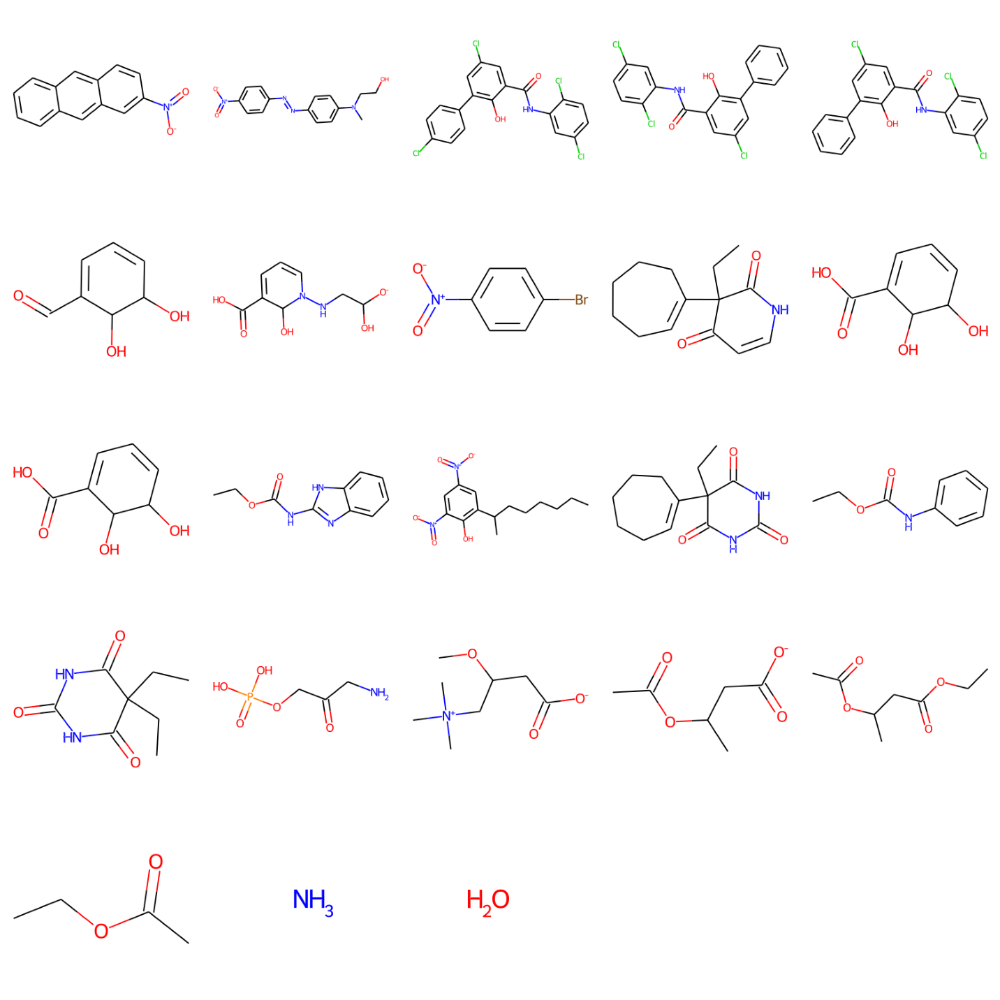

['c1cc([N+](=O)[O-])ccc1N=Nc1ccccc1C' 'c1ccc2cc3ccc([N+](=O)[O-])cc3cc2c1'
 'C(=O)(Nc1cc(Cl)ccc1Cl)c1cc(Cl)cc(-c2ccc(Cl)cc2)c1O'
 'C(=O)(Nc1cc(Cl)ccc1Cl)c1cc(Cl)c(N)cc1OC'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(CCO)CCC#N)cc1'
 'c1ccccc1-c1cc(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c1O'
 'c1cc([N+](=O)[O-])ccc1NCC(=O)O'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1OC'
 'O=C(O)C1=CC=CN(NCC([O-])O)C1O'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)CC)c(C)c1'
 'O=C1C=CNC(=O)C1(CC)C1=CCCCC1' 'C1=C(C2(CC)C(=O)C=CNC2=O)C(O)CC1=O'
 'C1=C(C(=O)O)C(O)CC=C1' 'O=C(O)C1=CC=CN(NCC(O)O)C1O'
 'c1(O)C(C(=O)O)=CC=CC1O' 'OC(=O)C1=CC=CC(N)C1'
 'N1C(=O)NC(=O)C(CC)(C2=CCCCC2)C1=O' 'CCC1(C2=CCCCCC2)C(=O)NC(=O)NC1=O'
 'C1CC=C(C2(CC)C(=O)NC(=O)N(C)C2=O)C1O' 'O=C1NC(=O)NC(=O)C1(CC)CC'
 'C(C(=O)OCC)=O' 'OCC(=O)CN' 'COC(CC(=O)[O-])C[N+](C)(C)C'
 'O=C(C)OC(CC(=O)O)C' 'CC(C[N+](C)(C)C)OC(C)=O']


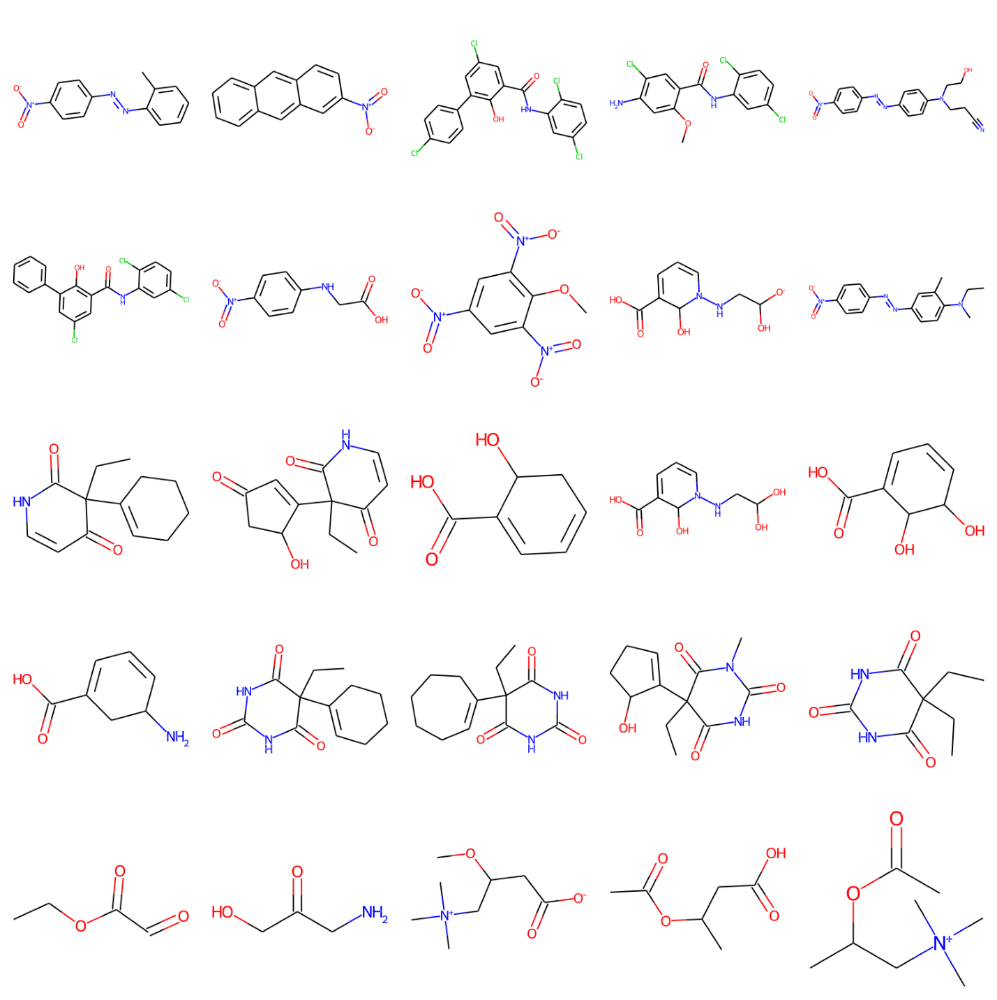

['c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)C)cc1'
 'c1c(N=Nc2ccc([N+](=O)[O-])cc2)ccc(N(C)C)c1Cl'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)CC)cc1'
 'C(=O)(Nc1cc(Cl)ccc1Cl)c1cc(Cl)cc(-c2ccc(Cl)cc2)c1O'
 'c1(Cl)ccc(-c2cc(Cl)cc(C(=O)Nc3cc(Cl)ccc3Cl)c2O)cc1'
 'Clc1ccc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)c1'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc(C(N)=O)c1Cl'
 'C1(C(=O)O)=CC=CC(O)C(OC(N)=O)C(C)=CC(C)C(O)C(OC)CC(C)CC2=C(OC)C(=O)C=C(NC1=O)C2=O'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)CC)c(C)c1'
 'C1=C(C2(CC)C(=O)C=CNC2=O)C(O)CC=C1' 'C1(CC)(C2=CCCCC2)C(=O)C=CNC1=O'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(CC)CCO)c(C)c1' 'c1(O)C(C(=O)O)=CC=CC1O'
 'C1=C(C2(CC)C(=O)NC(=O)N(C)C2=O)C(O)CC1=O'
 'COc1cc(N)c(Cl)cc1C(=O)NC1CCN(Cc2ccccc2)CC1'
 'OC1CC(=O)C=C1C1(CC)C(=O)C=CC2C1C(OC(C)=O)C(=O)C1(C)C2CCC2C(=C(CCC=C(C)C)C(=O)O)C(OC(C)=O)CC21C'
 'O=C1NC(=O)NC(=O)C1(CC)CCC(C)C' 'C(=O)COP(=O)(O)O' 'C(C(=O)O)CN'
 'C(C(=O)OCC)OC(C)=O' 'OC(CC(=O)O)C[N+](C)(C)C'
 'C(CC(=O)[O-])C[N+](C)(C)C' 'C(C)(=O)OC(C)(C)C#N' 'OC(O)CN']
skipped


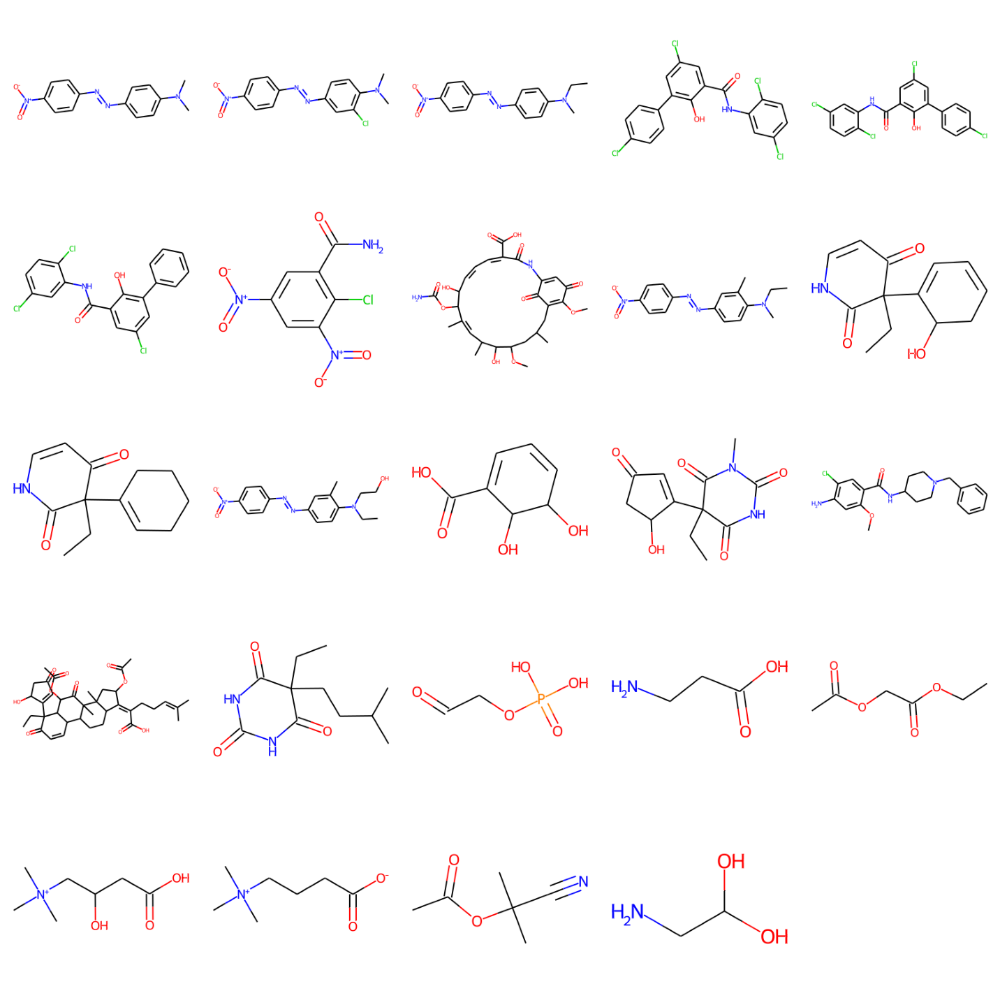

['c1cc(N=Nc2ccc(N(C)C)c(Cl)c2)=C1' 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N)cc1'
 'Clc1cc(C(=O)Nc2cc(Cl)ccc2Cl)c([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)CCC#N)cc1'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)CC)cc1'
 'c1(Cl)ccc(-c2cc(Cl)cc(C(=O)Nc3cc(Cl)ccc3Cl)c2O)cc1'
 'c1(O)c(C(=O)Nc2cc(Cl)ccc2Cl)cc(Cl)cc1-c1ccc(Cl)cc1'
 'c1(Cl)ccc(Cl)cc1NC(=O)c1cc(Cl)cc(-c2ccc(Cl)cc2)c1O'
 'c1cc([N+](=O)[O-])ccc1-c1ccc(Cl)cc1'
 'Clc1ccc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)c1'
 'c1(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c(O)c(-c2ccccc2)c1'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc(C(N)=O)c1Cl'
 'c1c([N+](=O)[O-])cc([N+](=O)[O-])c(Cl)c1Cl'
 'O=[N+]([O-])c1ccc(N=Nc2ccc(N(C)CCO)c(C)c2)cc1'
 'O=C(O)C1=CC=CC(O)C(OC(N)=O)C(C)=CC(C)C(O)C(OC)CC(C)CC2=C(OC)C(=O)C=C(NC(=O)C(C)=CC=CC1OC)C2=O'
 'C1=C(C2(CC)C(=O)C=CNC2=O)C(O)CC=C1' 'C1(CC)(C2=CCCCC2)C(=O)C=CNC1=O'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(CCO)CCO)cc1C'
 'O=[N+]([O-])c1ccc(N=Nc2ccc(N(CC)CCO)c(C)c2)cc1' 'c1(O)C(C(=O)O)=CC=CC1O'
 'C1=C(C2(CC)C(=O)NC(=O)N(C)C2=

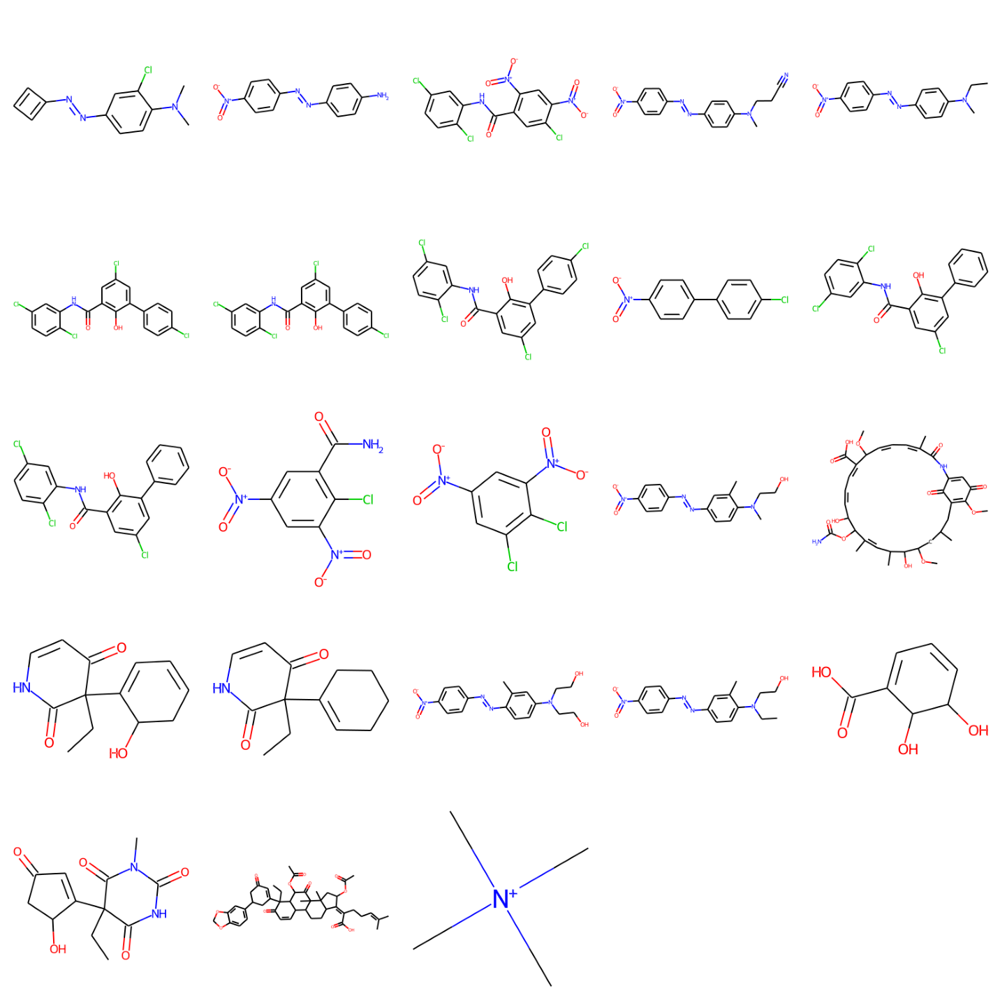

['c1cc(N=Nc2ccc([N+](=O)[O-])cc2)=CC=CC(O)C1O'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1Nc1ccc([N+](=O)[O-])cc1'
 'c1cc([N+](=O)[O-])ccc1N=Nc1cc(C)c(OC)cc1N'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N)cc1'
 'Clc1cc(C(=O)Nc2cc(Cl)ccc2Cl)c([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[N+](=O)([O-])c1ccc(C=C)c(N)c1'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)CC)cc1'
 'O=[N+]([O-])c1ccc(N=Nc2ccc(N(C)CCO)cc2)c2nonc12'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc(C(N)=O)c1O'
 'c1cc(Cl)ccc1-c1cc(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c1O'
 'c1c(Cl)cc(-c2ccc(Cl)cc2)c(O)c1C(=O)Nc1cc(Cl)ccc1OCC(=O)O'
 'c1(-c2ccc(Cl)cc2)cc(Cl)cc(C(=O)Nc2ccc(Cl)c(Cl)c2)c1O'
 'c1(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c(O)c(-c2ccccc2)c1'
 'Oc1c(C(=O)Nc2cc(Cl)ccc2Cl)cc(Cl)cc1-c1ccccc1'
 'Clc1ccc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)c1'
 'c1(Cl)ccc(Cl)cc1NC(=O)c1cc(Cl)cc(Cl)c1O' 'c1cc(Cl)ccc1-c1cc(CCN(C)C)on1'
 'N1C=CC(=O)C(CC)(CC)C1=O'
 'O=[N+]([O-])c1ccc(N=Nc2ccc(N(CC)CCO)c(C)c2)cc1'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(CCO)CCO)c(C)c1'
 'c1(O)C(C(=O)O)=CC=CC1O' 'c1(O)C=CC=C(C(=O

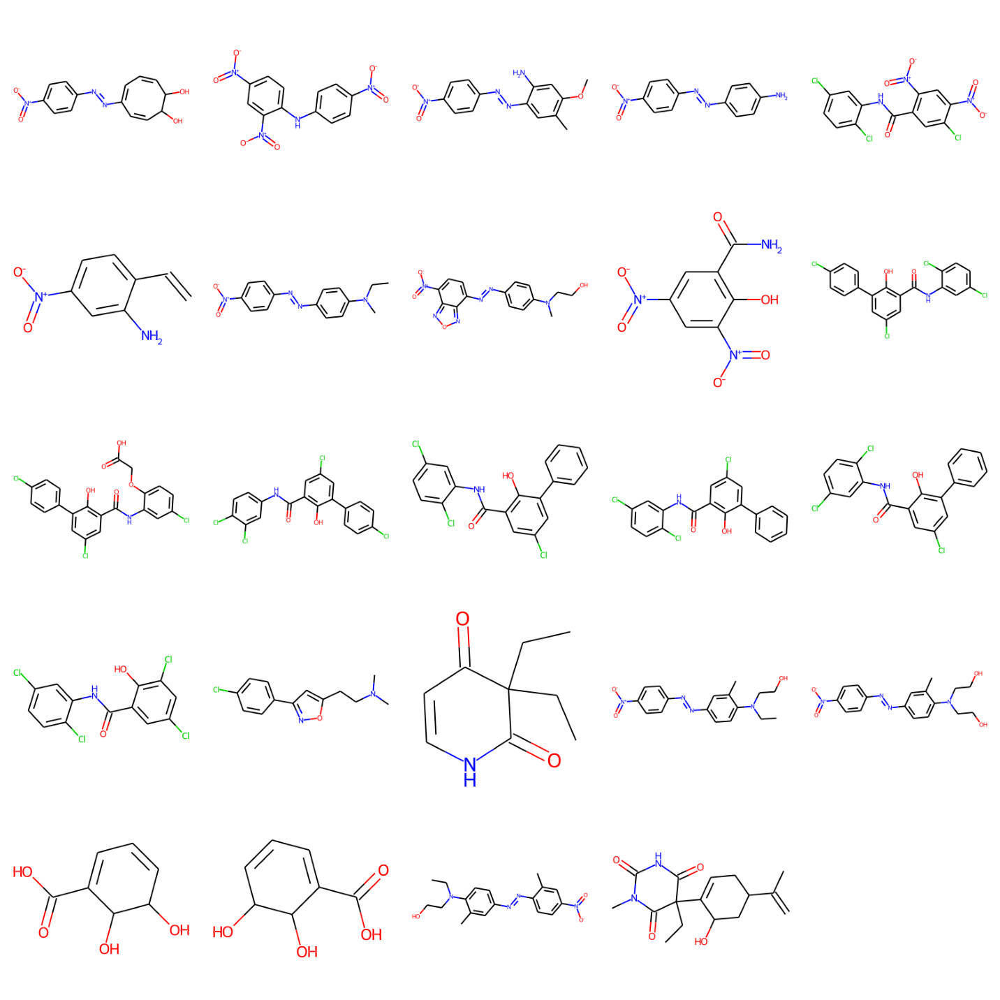

['OC1C=CC=C(N=Nc2ccc([N+](=O)[O-])cc2)C=CC=C(C(=O)O)C1'
 'c1(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)ccc([N+](=O)[O-])cc1'
 'c1cc([N+](=O)[O-])ccc1N=Nc1cc(C)c(OC)cc1N'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1Nc1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)CCC#N)cc1'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc(C(N)=O)c1O'
 'c1(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c(O)c(-c2ccc(Cl)cc2)c1'
 'c1c(Cl)ccc(Cl)c1NC(=O)c1cc(Cl)ccc1O'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])c(N)c([N+](=O)[O-])c1[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc(Cl)ccc1Oc1ccc(Cl)cc1'
 'c1c(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c(O)c1-c1ccccc1'
 'Clc1ccc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)c1'
 'Clc1cc(C(=O)Nc2cc(Cl)ccc2Cl)c(O)c(-c2ccccc2)c1'
 'CCN(CCO)c1ccc(N=Nc2ccc([N+](=O)[O-])cc2)cc1'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1C'
 'c1(Cl)ccc(Cl)cc1NC(=O)c1ccc(Cl)cc1' 'c1(O)C=CC=C(C(=O)O)C1O'
 'c1(O)C(C(=O)O)=CC=CC1O' '[N+](=O)([O-])c1ccc(C=C)o1'
 'c1cc(Cl)=CC=CC(O)C1O'
 'c1cc([N+](=O)[O-])cc(C)c1N=Nc1ccc(N(CC)CCO)c(C)c1'
 'C(=C)(C)C1CC=C(C2(CC)C(=O

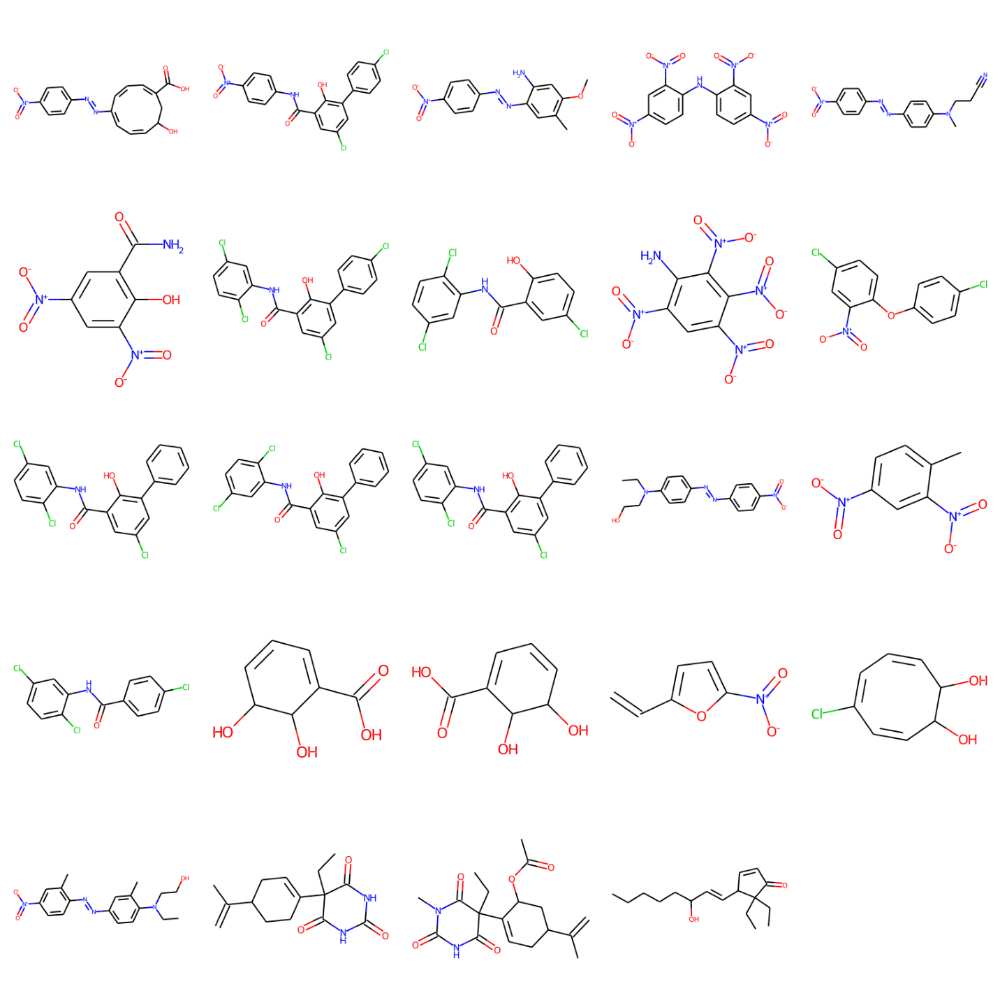

['[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1Nc1cccc(C)c1'
 'O=[N+]([O-])c1ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c([N+](=O)[O-])c1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c([N+](=O)[O-])c1'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)CCC#N)cc1'
 'c1cc(N=Nc2ccc([N+](=O)[O-])cc2)ccc1N(C)CC'
 'c1(O)c(C(=O)Nc2cc(Cl)ccc2Cl)cc(Cl)cc1-c1ccc(Cl)cc1'
 'c1cc([N+](=O)[O-])ccc1N=Nc1ccc(N(C)CCC#N)c(C)c1'
 'c1c(Cl)cc(-c2ccc(Cl)cc2)c(O)c1C(=O)Nc1cc(Cl)cc(Cl)c1O'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])c(N)c([N+](=O)[O-])c1[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc(C(C)(C)C)c1O'
 'Clc1ccc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)c1'
 'c1(-c2ccccc2)cc(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c1O'
 'c1c(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c(O)c1-c1ccccc1'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1CO' 'c1cc([N+](=O)[O-])ccc1N(C)C'
 'CCN(CCO)c1ccc(N=Nc2ccc([N+](=O)[O-])cc2)cc1'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])c(N)c([N+](=O)[O-])c1'
 'c1(O)c(C(=O)Nc2cc(Cl)ccc2Cl)ccc(OC)c1O'
 'O=C(N)c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1'
 'c1c(C

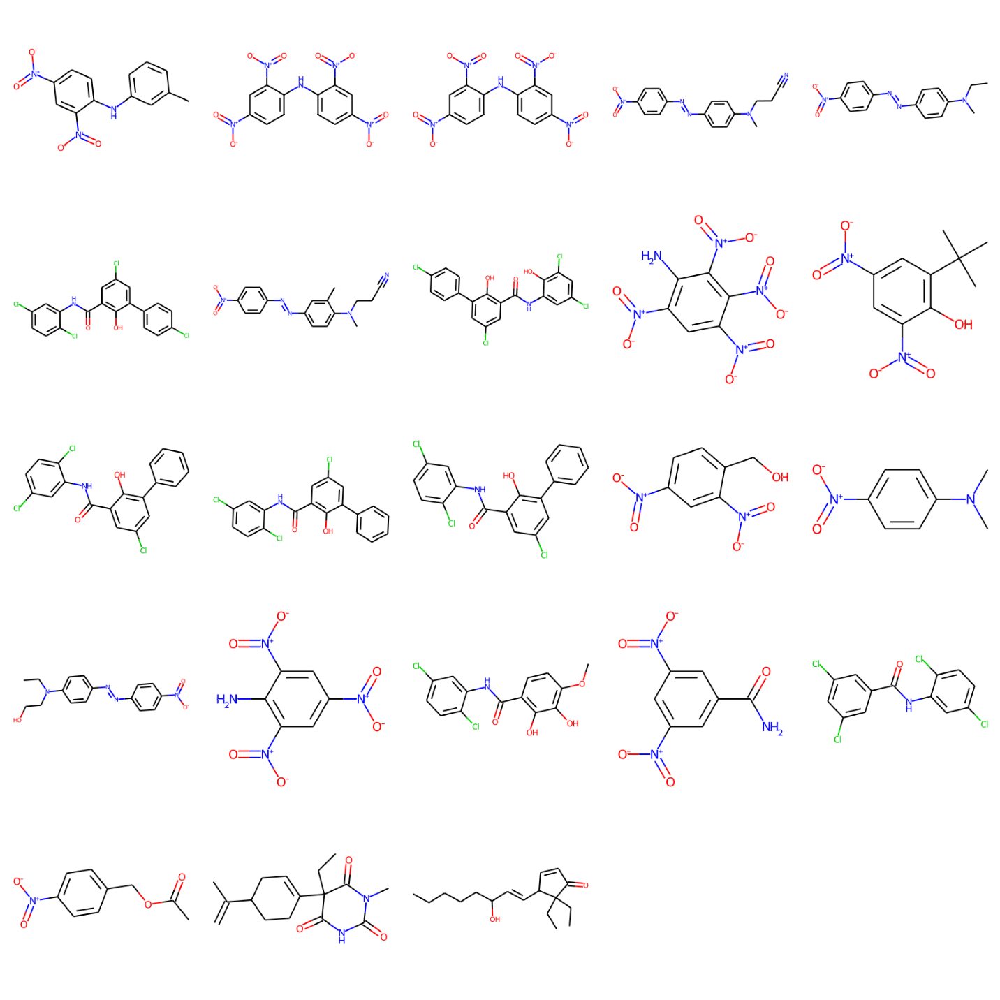

['[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1Nc1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c([N+](=O)[O-])cc1[N+](=O)[O-]'
 'N(=Nc1ccc([N+](=O)[O-])cc1)c1cc([N+](=O)[O-])ccc1F'
 'c1(N(C)CCC#N)ccc(N=Nc2ccccc2C(=O)O)cc1'
 'c1(O)c(C(=O)Nc2cc(Cl)ccc2Cl)cc(Cl)c2cccnc12'
 'O=[N+]([O-])c1ccc(N=Nc2ccc(N(C)CCO)cc2)cc1'
 'Clc1ccc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)c1'
 'c1(O)c(C(=O)Nc2cc(Cl)ccc2Cl)cc(Cl)cc1-c1ccc(Cl)cc1'
 'O=C(Nc1cc(Cl)ccc1Cl)c1cc(Cl)ccc1O'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])c(N)c([N+](=O)[O-])c1[N+](=O)[O-]'
 'c1cc(Cl)cc(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)c1'
 'c1(O)c(C(=O)Nc2cc(Cl)ccc2Cl)cc(Cl)c2c1C(=O)OC(C)C2'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)c(Cl)c1'
 'c1(Cl)ccc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)c1'
 'c1(Cl)cc(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])c([N+](=O)[O-])cc1C'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1N[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1CO'
 'CCN(CCO)c1ccc(N=Nc2ccc([

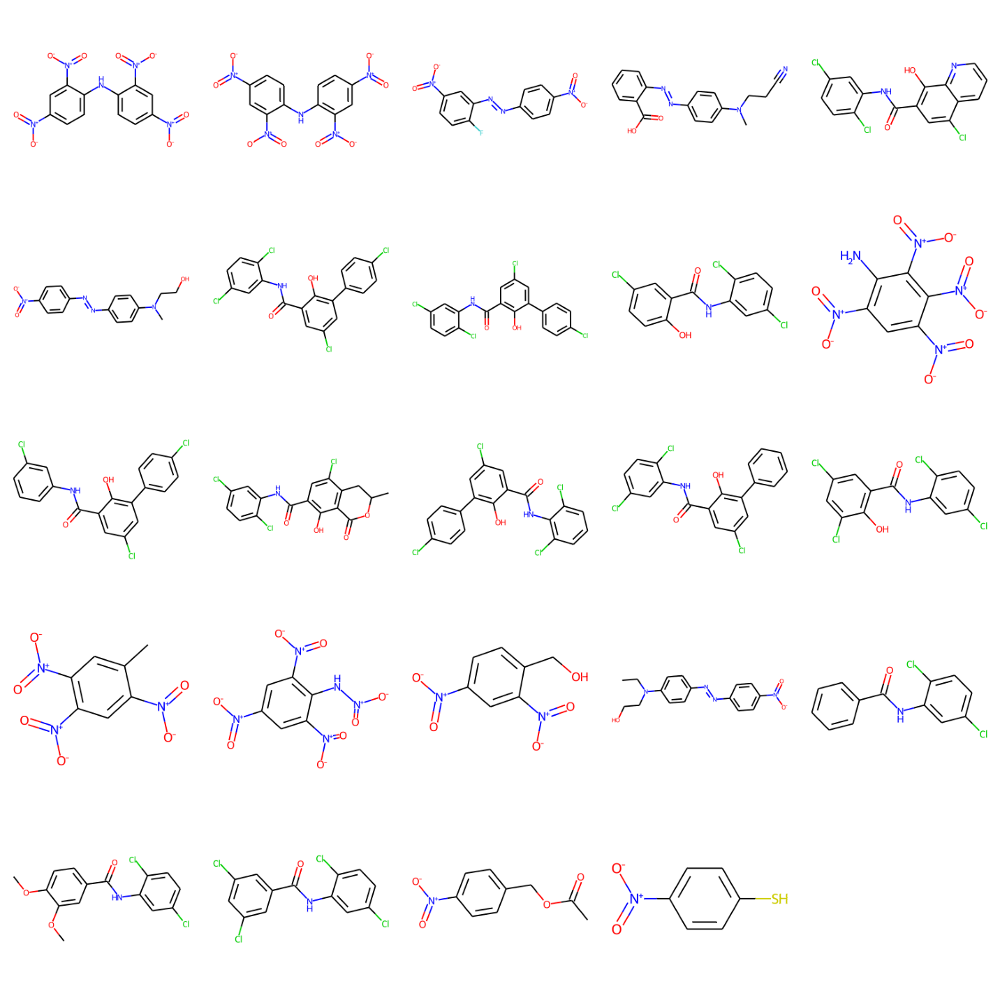

['N(=Nc1ccc([N+](=O)[O-])cc1)c1cc([N+](=O)[O-])ccc1SC(=S)N(C)C'
 'c1c(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c2c1C(=O)C(=C1Sc3c(C)cc(Cl)cc3C1=O)S2'
 'N(=Nc1ccc([N+](=O)[O-])cc1)c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1Nc1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1NN=C(C)c1ccccc1'
 'Clc1cc(C(=O)Nc2cc(Cl)ccc2Cl)c(O)c2ncccc12'
 'c1(-c2cc(Cl)cc(C(=O)Nc3cc(Cl)ccc3Cl)c2O)ccc(Cl)cc1'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])c(N)cc1C'
 'c1cc([N+](=O)[O-])ccc1Sc1ccc(NCC)cc1'
 'c1(C(=O)Nc2cccc(Cl)c2)cc(Cl)cc(-c2ccc(Cl)cc2)c1O'
 'c1cc(Cl)ccc1-c1cc(Cl)cc(C(=O)Nc2ccc(Cl)c(Cl)c2)c1O'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)c(Cl)c1'
 'c1cc(Cl)cc(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)c1Cl'
 'c1(Cl)cc(Cl)cc(C(=O)Nc2ccc(Cl)c(Cl)c2)c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])c([N+](=O)[O-])cc1C'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)cc1CC'
 'C(O)CN(CC)c1ccc(N=Nc2ccc([N+](=O)[

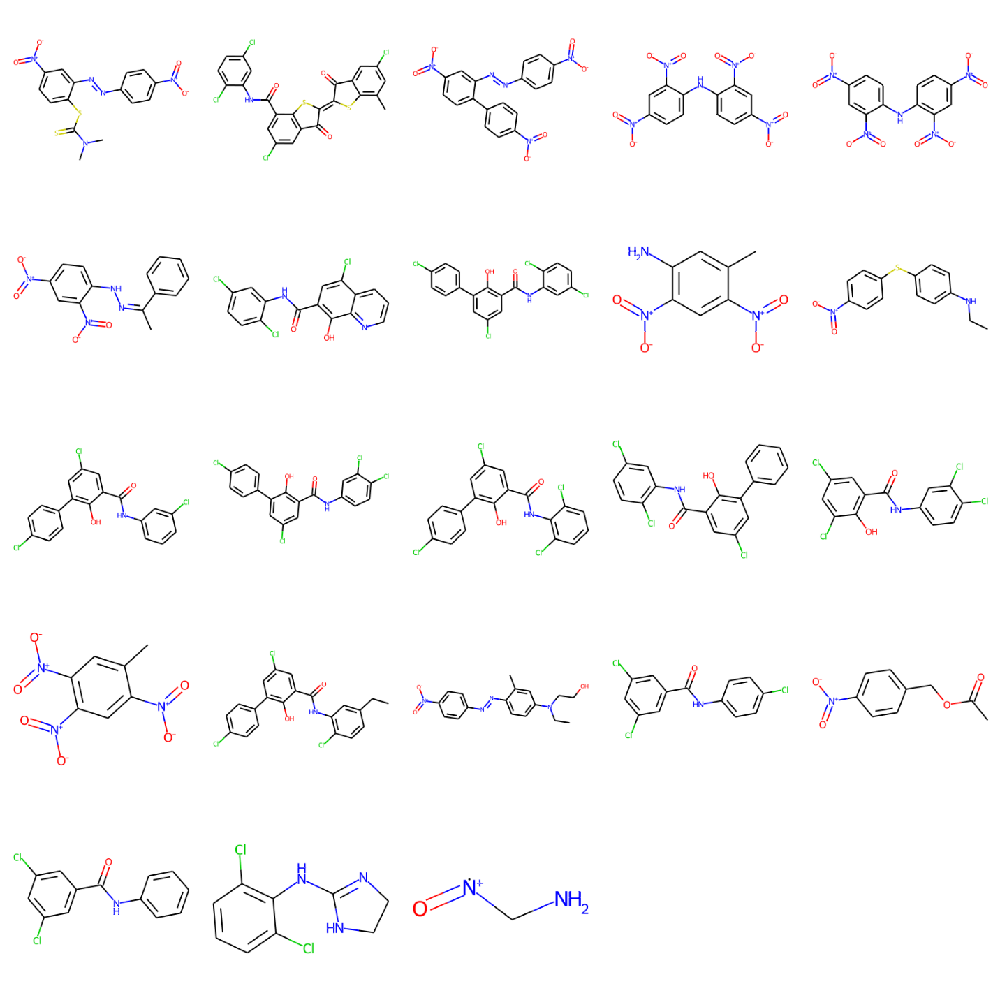

['N(=Nc1ccc([N+](=O)[O-])cc1)c1cc([N+](=O)[O-])ccc1N'
 'c1c(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c2c1C(=O)C(=C1Sc3c(C)cc(Cl)cc3C1=O)S2'
 'c1cc(N=Nc2cc([N+](=O)[O-])ccc2SC(=S)N(C)C)ccc1N=Nc1cccc(C)c1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1cc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1N=Nc1ccc(N(C)C)cc1'
 'c1(-c2cc(Cl)cc(C(=O)Nc3ccc(Cl)c(Cl)c3)c2O)C(C(=O)O)=CC=CC1O'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)cc1Cl'
 'CCNc1ccc(Sc2ccc([N+](=O)[O-])cc2)cc1'
 'N(N=C(C)c1ccccc1)c1ccc([N+](=O)[O-])cc1'
 'c1(Cl)ccc(-c2cc(Cl)cc(C(=O)Nc3ccc(Cl)c(Cl)c3)c2O)cc1'
 'c1cc(Cl)ccc1-c1cc(Cl)cc(C(=O)Nc2ccc(Cl)c(Cl)c2)c1O'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)c(Cl)c1'
 'c1cc(Cl)cc(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)c1Cl'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)c(Cl)c1'
 'C(O)CN(CC)c1ccc(N=Nc2ccc([N+](=O)[O-])cc2)c(C)c1'
 'c1c(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)cc1Cl'
 'c1(Cl)cc(Cl)cc(C(=O)Nc2ccc(Cl)c(Cl)c2)c1'
 

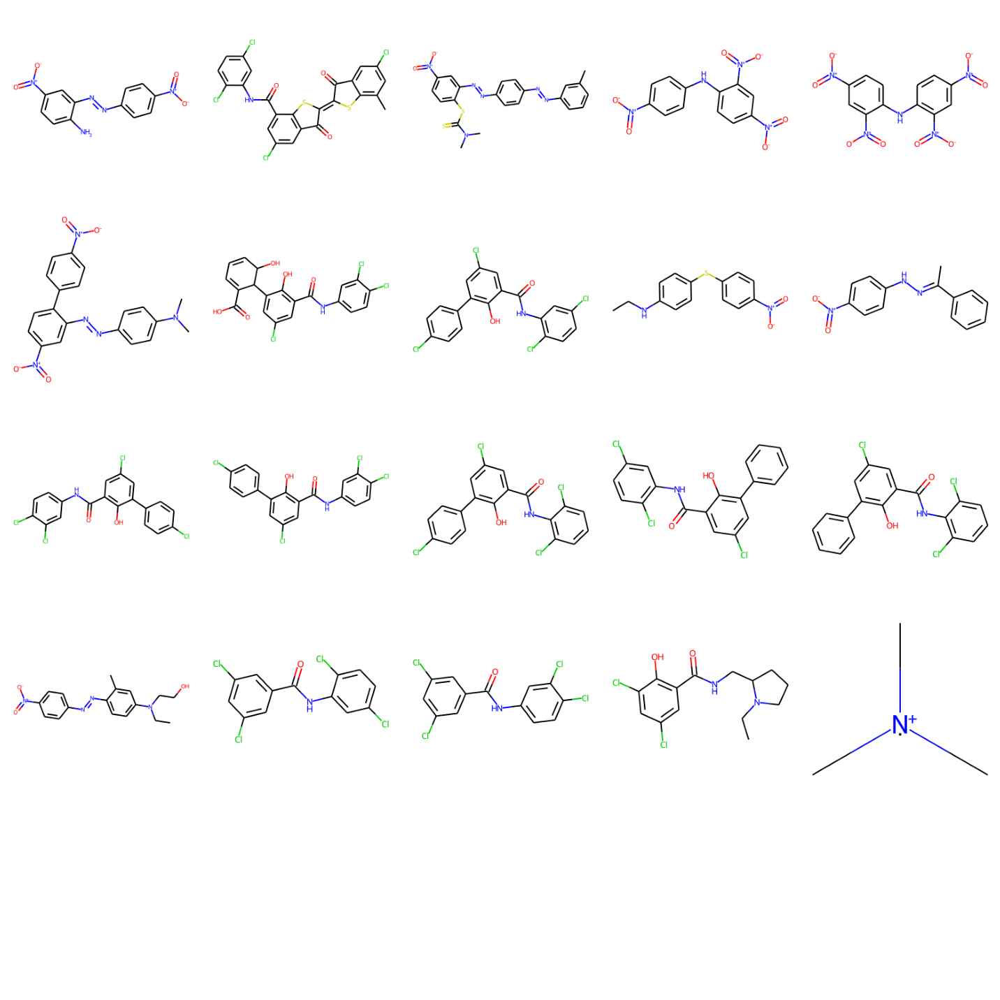

['O=C1C(=C2Sc3c(C(=O)Nc4cc(Cl)ccc4Cl)cc(Cl)cc3C2=O)Scc1Cl'
 'c1cc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'CN(C)c1ccc(N=Nc2cc([N+](=O)[O-])ccc2-c2ccc([N+](=O)[O-])cc2)cc1'
 'c1(-c2cc(Cl)cc(C(=O)Nc3ccc(Cl)c(Cl)c3)c2O)C(C(=O)O)=C1'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)c2nsnc12'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1C(F)(F)F'
 'Clc1ccc(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)cc1'
 'c1cc(Cl)ccc1-c1cc(Cl)cc(C(=O)Nc2cc(Cl)ccc2Cl)c1O'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)cc1Cl'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2)cc1'
 'c1(Cl)ccc(-c2cc(Cl)cc(C(=O)Nc3ccc(Cl)c(Cl)c3)c2O)cc1'
 'c1cc(Cl)ccc1-c1cc(Cl)cc(C(=O)Nc2ccc(Cl)c(Cl)c2)c1O'
 'c1(Cl)ccc(-c2cc(Cl)cc(C(=O)Nc3c(Cl)cccc3Cl)c2O)cc1'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)cc1Cl'
 'c1(C(=O)Nc2cc(Cl)ccc2Cl)cc(Cl)cc(-c2ccccc2)c1O'
 'N(C(=O)c1cc(Cl)cc(-c2ccccc2)c1O)c1cc(Cl)ccc1Cl'
 'Oc1c(C(=O)Nc2cc(Cl)ccc2Cl)cc(Cl)c

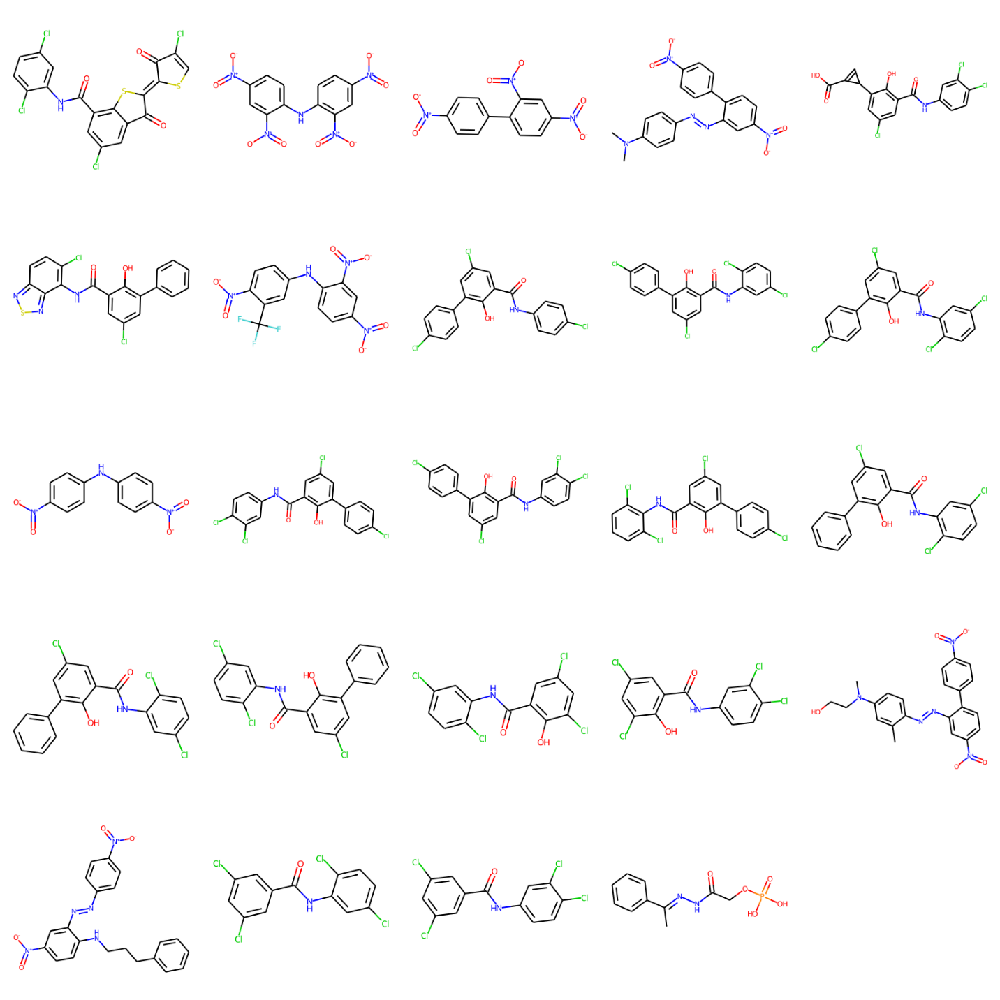

['N(C(=O)c1cc(Cl)cc(-c2ccccc2)c1O)c1cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 '[O-][N+](=O)c1cc([N+](=O)[O-])ccc1Nc1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c([N+](=O)[O-])c1'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'CN(C)c1ccc(N=Nc2cc([N+](=O)[O-])ccc2-c2ccc([N+](=O)[O-])cc2)cc1'
 'c1(Cl)cc(C(=O)Nc2ccc(Cl)c(Cl)c2)c(O)c(C2C=C2C(=O)O)c1'
 'c1(-c2cc(Cl)cc(C(=O)Nc3ccc(Cl)c(Cl)c3)c2O)C(C(=O)O)=C1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1C(F)(F)F'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])o1'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)cc1OC'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)cc1Cl'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)cc1OC'
 'c1(Cl)cc(Cl)c(O)c(C(=O)Nc2ccc(Cl)cc2)c1'
 'c1cc(Cl)ccc1-c1cc(Cl)cc(C(=O)Nc2ccc(Cl)c(Cl)c2)c1O'
 'Oc1c(C(=O)Nc2cc(Cl)ccc2Cl)cc(Cl)c2c1C(=O)OC(C)C2'
 'c1(Cl)ccc(-c2cc(Cl)cc(C(=O)Nc3c

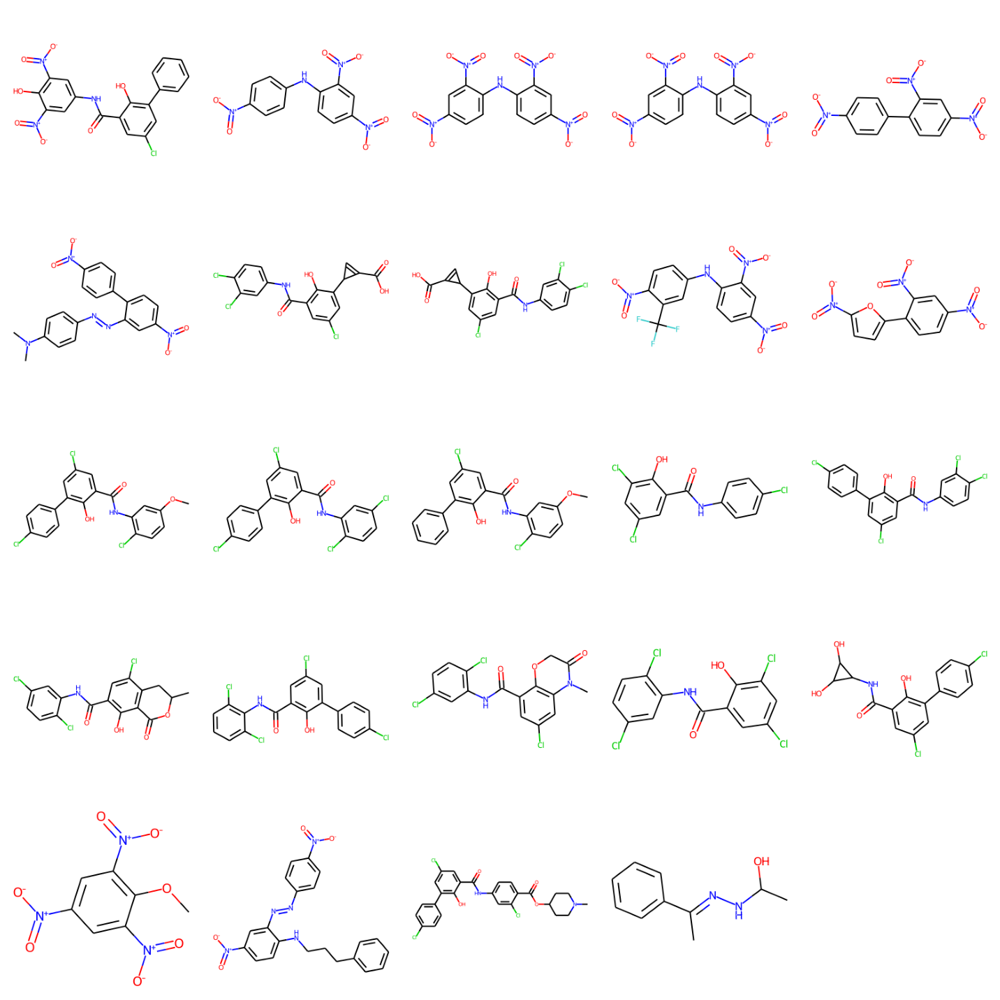

['c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1cc(Nc2ccc([N+](=O)[O-])cc2)c([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c([N+](=O)[O-])c1'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'CN(C)c1ccc(N=Nc2cc([N+](=O)[O-])ccc2-c2ccc([N+](=O)[O-])cc2)cc1'
 'c1(Cl)ccc(NC(=O)c2cc(Cl)cc(C3C=C3C(=O)O)c2O)cc1Cl'
 'c1(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc([N+](=O)[O-])c(C(F)(F)F)c1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1C(F)(F)F'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2)cc1'
 'c1c([N+](=O)[O-])ccc(-c2ccc([N+](=O)[O-])o2)c1[N+](=O)[O-]'
 'C(=O)(O)C1=CC1c1cc(Cl)cc(C(=O)Nc2ccc(Cl)cc2)c1Cl'
 'c1(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)C(O)C=C1'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1C(=O)Cl'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccc(Cl)cc3)c2O)c(Cl)c1'
 'c1cc(Cl)c(NC(=O)c2cc(Cl)cc(-c3ccccc3)c2O)cc1Cl'
 'c1cc(Cl)c(NC(=O)c

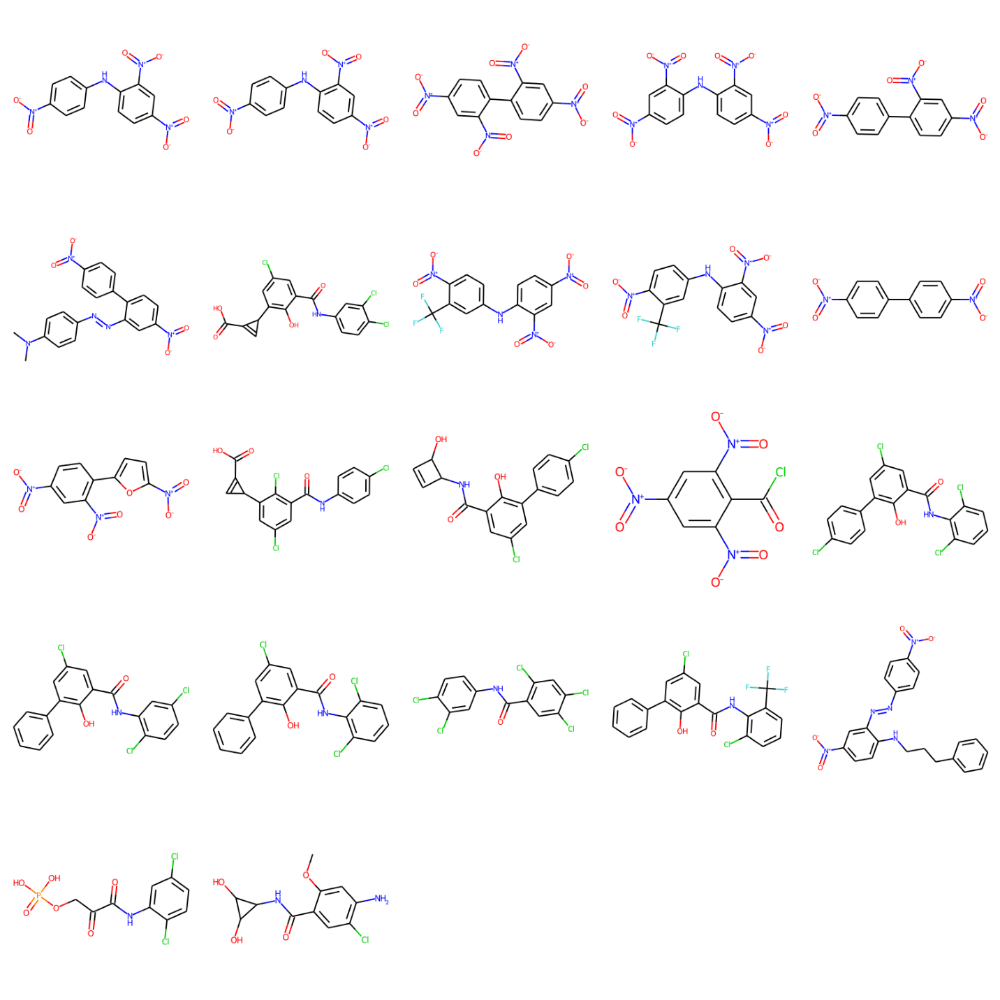

['c1cc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1SC(C)=O'
 '[O-][N+](=O)c1ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c2ccccc12'
 'c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])=C1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2)c([N+](=O)[O-])c1'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1Nc1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc([N+](=O)[O-])ccc1Nc1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2)c([N+](=O)[O-])c1'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc([N+](=O)[O-])c([N+](=O)[O-])c1'
 'CN(C)c1ccc(N=Nc2cc([N+](=O)[O-])ccc2-c2ccc([N+](=O)[O-])cc2)cc1'
 'c1(O)c(C(=O)Nc2ccc(Cl)c(Cl)c2)cc(Cl)c2cccnc12'
 'c1(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc([N+](=O)[O-])c(C(F)(F)F)c1'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2)cc1'
 'c1c([N+](=O)[O-])ccc(-c2ccc([N+](=O)[O-])o2)c1[N+

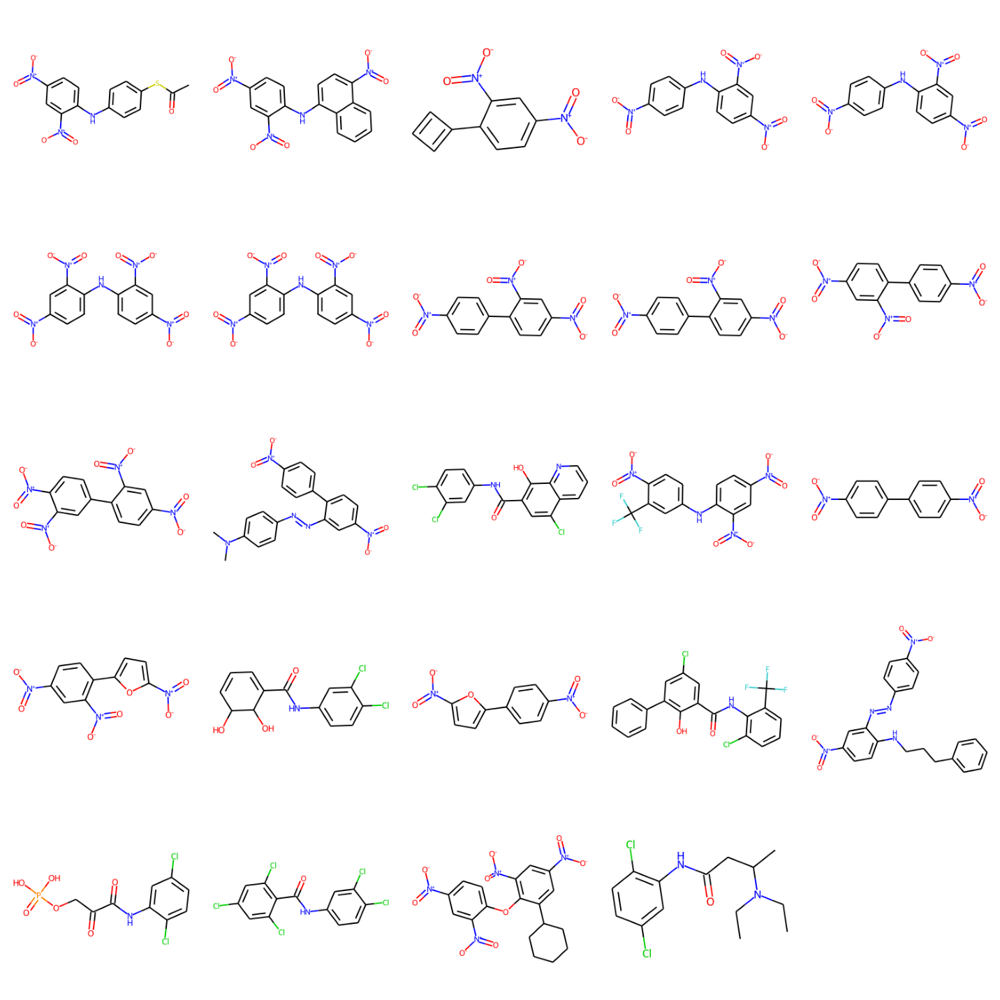

['c1cc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1SC#N'
 'c1(SC(C)=O)ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'N(=Nc1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1)c1ccc([N+](=O)[O-])cc1Cl'
 'c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1Nc1ccc([N+](=O)[O-])cc1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2)c([N+](=O)[O-])c1'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'N(c1ccc([N+](=O)[O-])cc1[N+](=O)[O-])c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2)c([N+](=O)[O-])c1'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'CN(C)c1ccc(N=Nc2cc([N+](=O)[O-])ccc2-c2ccc([N+](=O)[O-])cc2)cc1'
 'c1(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc([N+](=O)[O-])c(C(F)(F)F)c1'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1'


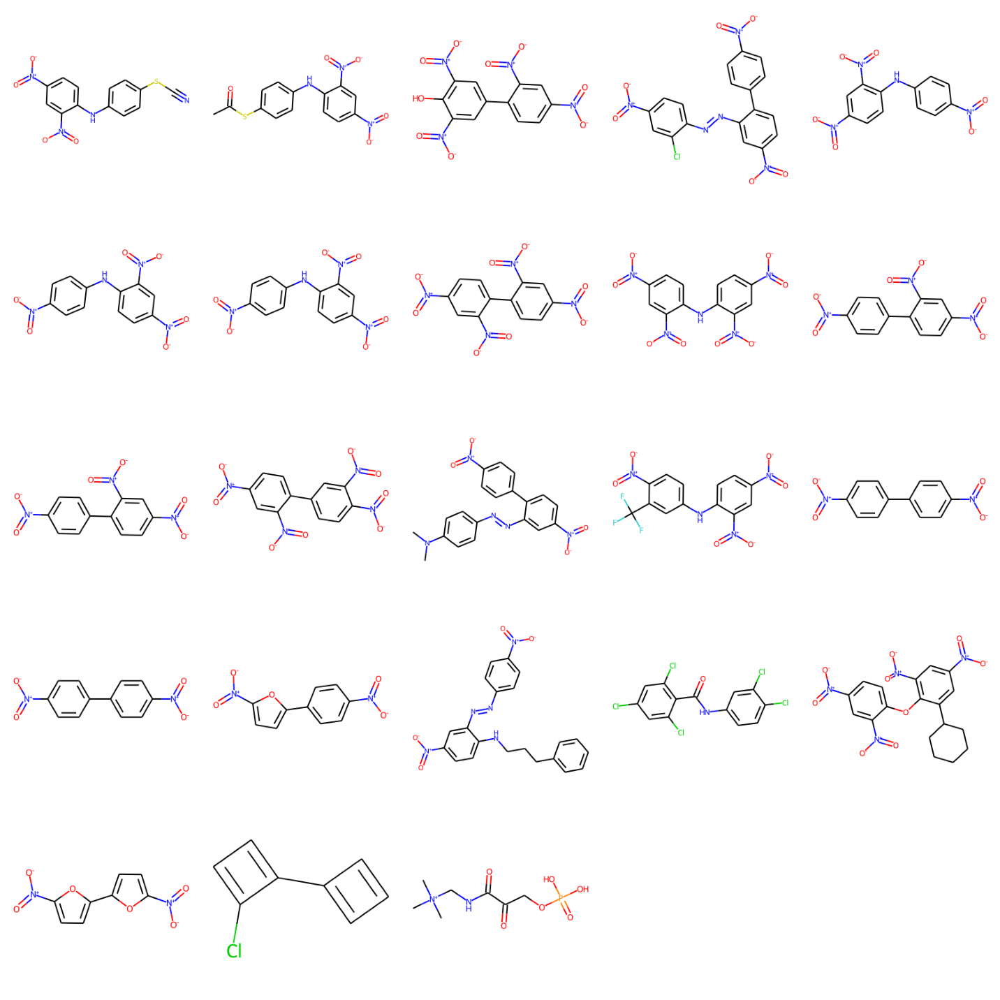

['[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1O'
 'c1(SC(C)=O)ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1cc([N+](=O)[O-])ccc1-c1ccc(C(C)=O)cc1'
 'c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1-c1cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1cc(N=Nc2cc([N+](=O)[O-])ccc2-c2ccc([N+](=O)[O-])cc2)c([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2)c(N=Nc2ccc([N+](=O)[O-])cc2Cl)c1'
 'N(=Nc1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1)c1ccc([N+](=O)[O-])cc1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2)c([N+](=O)[O-])c1'
 '[N+](=O)([O-])c1ccc(Nc2ccc([N+](=O)[O-])cc2)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc([N+](=O)[O-])cc1'
 'CN(C)c1ccc(N=Nc2cc([N+](=O)[O-])ccc2-c2ccc([N+](=O)[O-])cc2)cc1'
 'c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1Nc1cccc(C(F)(F)F)c1'
 'c1(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc([N+](=O)

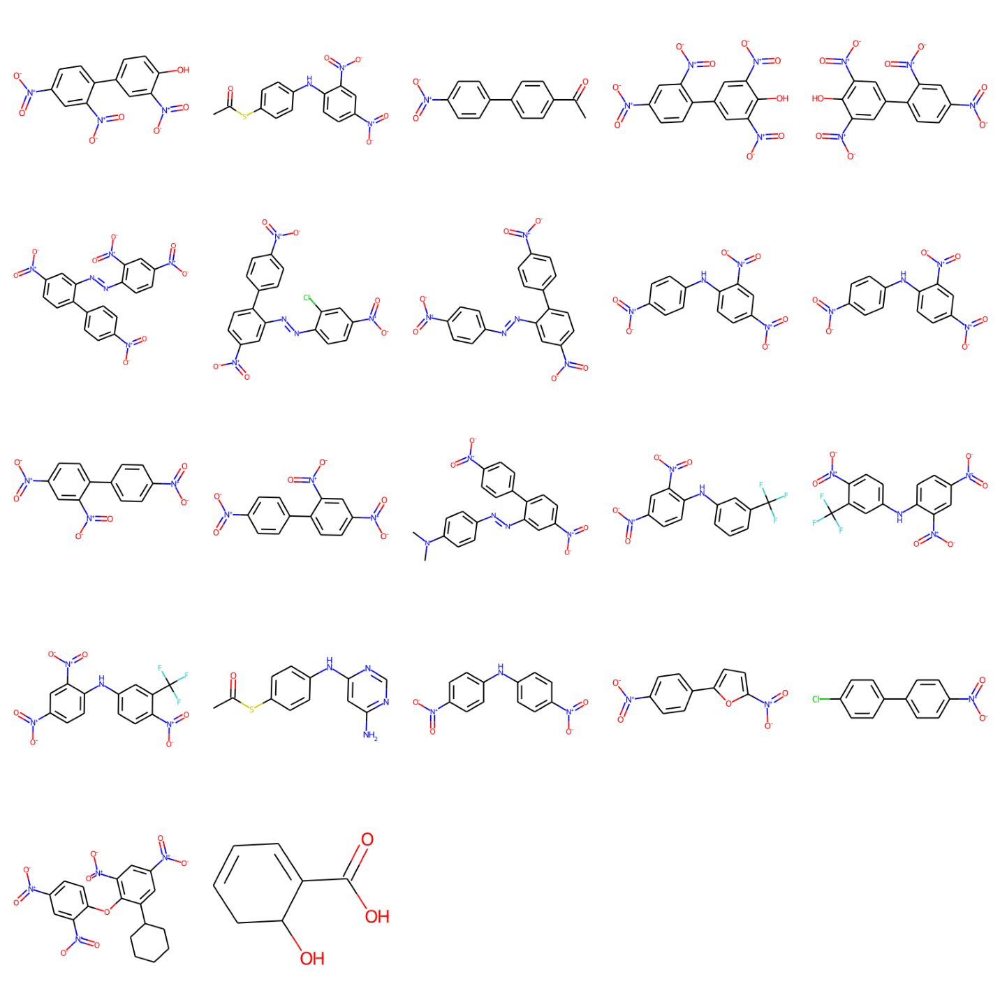

['c1(SC(C)=O)ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc1'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1N=NC(C#N)C#N'
 'c1(Cl)cc([N+](=O)[O-])ccc1N=Nc1cc([N+](=O)[O-])ccc1-c1ccccc1N'
 'N(=Nc1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1)c1ccc([N+](=O)[O-])cc1'
 '[N+](=O)([O-])c1ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(Cl)c1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc([N+](=O)[O-])cc1'
 'c1([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2)c(Cl)c1'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'CN(C)c1ccc(N=Nc2cc([N+](=O)[O-])ccc2-c2ccc([N+](=O)[O-])cc2)cc1'
 'c1(N(C)C)ccc(N=Nc2cc([N+](=O)[O-])ccc2-c2ccc([N+](=O)[O-])cc2)cc1'
 'c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1Nc1cccc(C(F)(F)F)c1'
 '[O-][N+](=O)

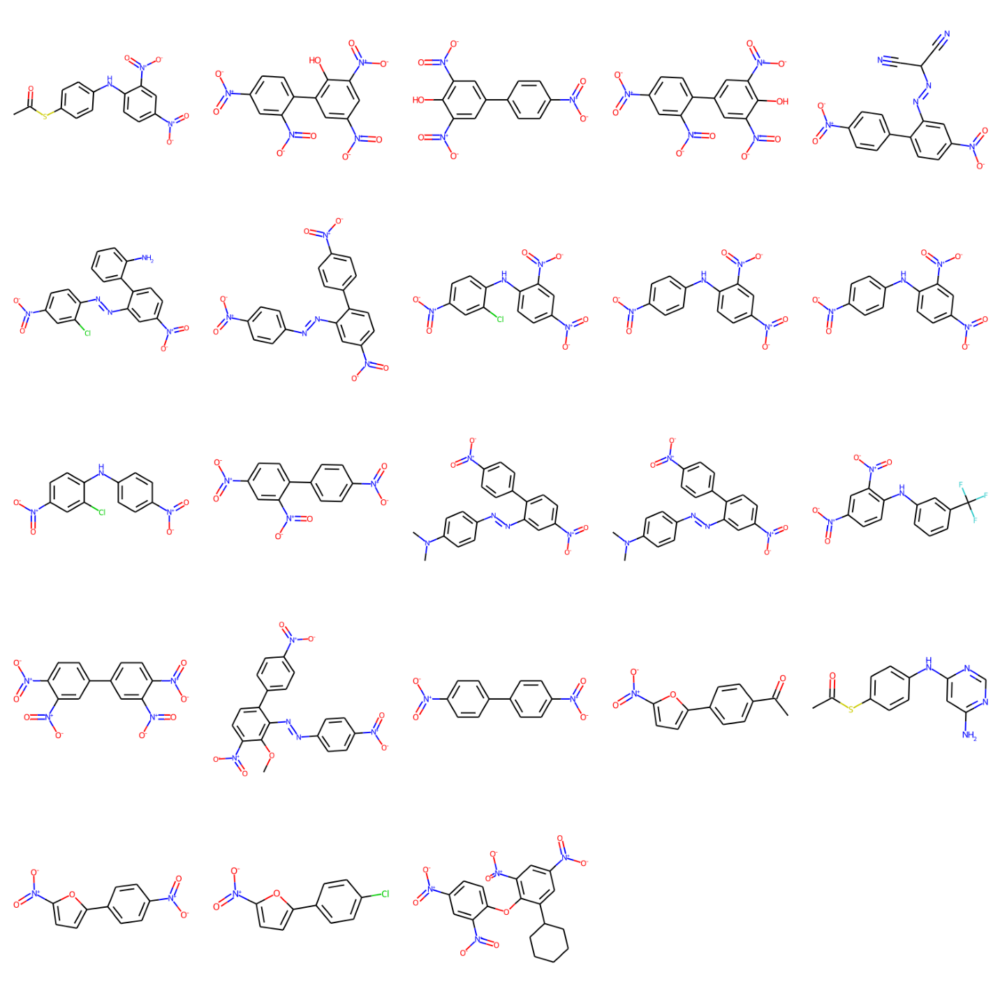

['[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1O'
 'c1(SC(C)=O)ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1c([N+](=O)[O-])cc([N+](=O)[O-])c(O)c1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2)cc([N+](=O)[O-])c1O'
 '[N+](=O)([O-])c1ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c([N+](=O)[O-])c1'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1N=NC(C#N)C#N'
 'C(#N)C(C#N)N=Nc1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1'
 'c1(Cl)cc([N+](=O)[O-])ccc1N=Nc1cc([N+](=O)[O-])ccc1-c1ccccc1N'
 'c1cc([N+](=O)[O-])ccc1-c1ccc(C=NN2CC(=O)NC2=O)cc1'
 'c1(SC(C)=O)ccc(Nc2ccc([N+](=O)[O-])cc2)cc1'
 'c1c([N+](=O)[O-])ccc(Nc2ccc([N+](=O)[O-])cc2)c1[N+](=O)[O-]'
 '[N+](=O)([O-])c1ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1cc([N+](=O)[O-])ccc1Nc1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-]

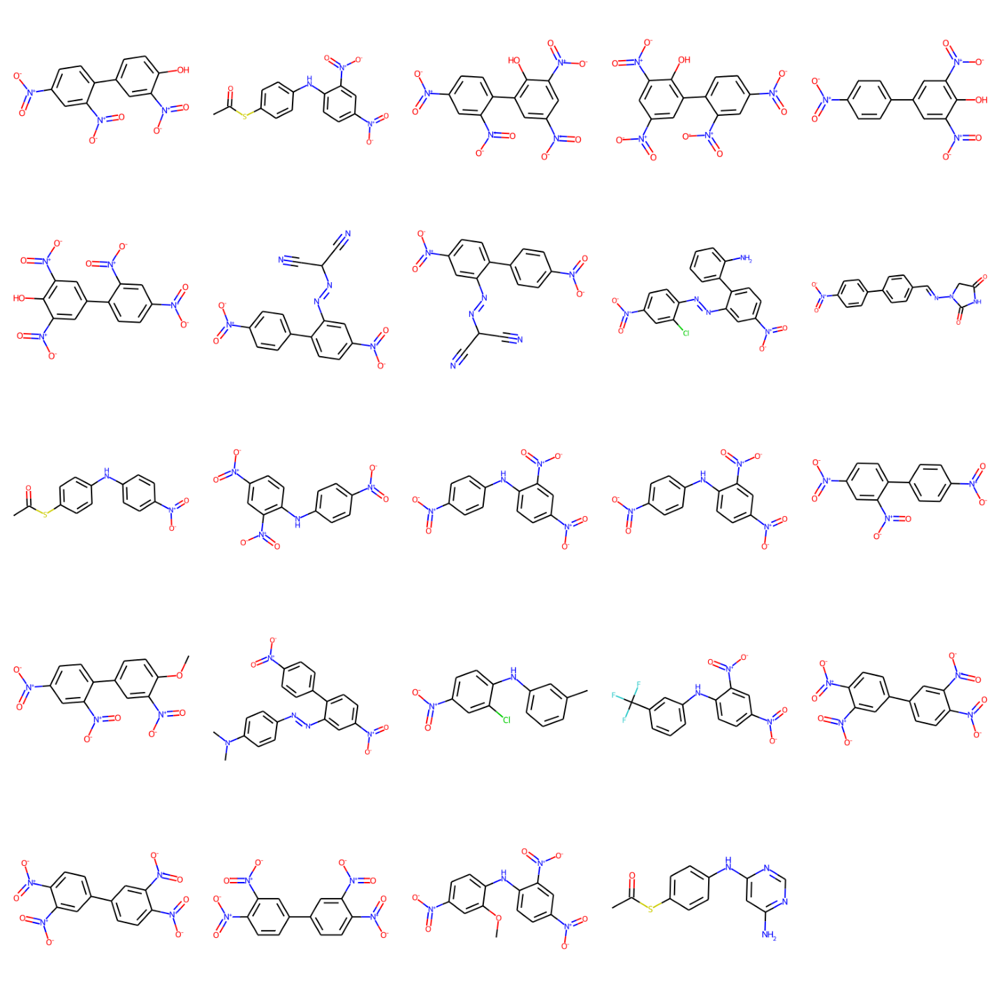

['[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'c1(SC(C)=O)ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[N+](=O)([O-])c1ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c([N+](=O)[O-])c1'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])cc2)ccc1O'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1N=NC(C#N)C#N'
 'c1cc(C=NN2CC(=O)NC2=O)ccc1-c1ccc([N+](=O)[O-])cc1'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)ccc1O'
 'c1(SC(C)=O)ccc(Nc2ccc([N+](=O)[O-])cc2)cc1'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)ccc([N+](=O)[O-])cc1'
 'c1(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)ccc([N+](=O)[O-])c([N+](=O)[O-])c1'


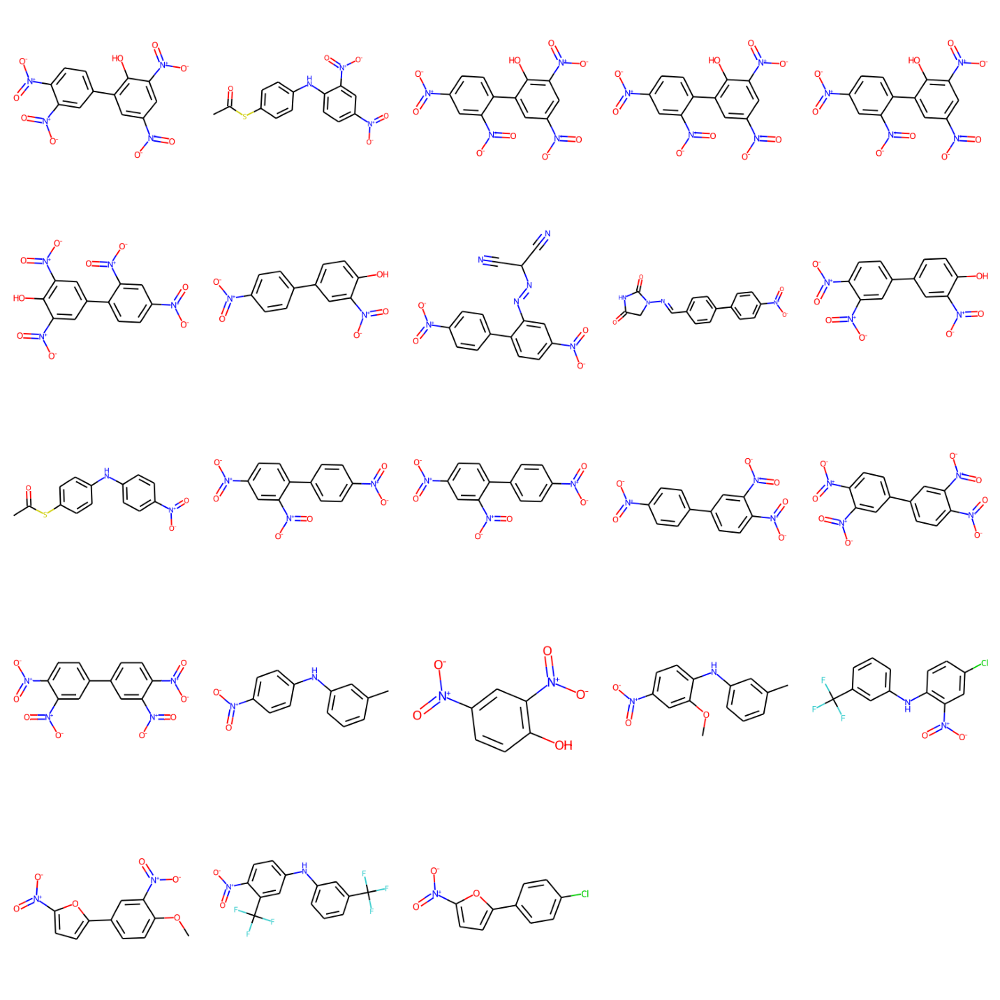

['c1(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1Cl'
 'O=C(C)Sc1ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 '[O-][N+](=O)c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1c([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c1[N+](=O)[O-]'
 '[N+](=O)([O-])c1ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c([N+](=O)[O-])c1'
 'c1c([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c1[N+](=O)[O-]'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1N=NC(C#N)C#N'
 'c1cc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc([N+](=O)[O-])c1'
 'c1(C=NN2CC(=O)NC2=O)ccc(-c2ccc([N+](=O)[O-])cc2)c(F)c1'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)ccc1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccccc2)c1O'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2

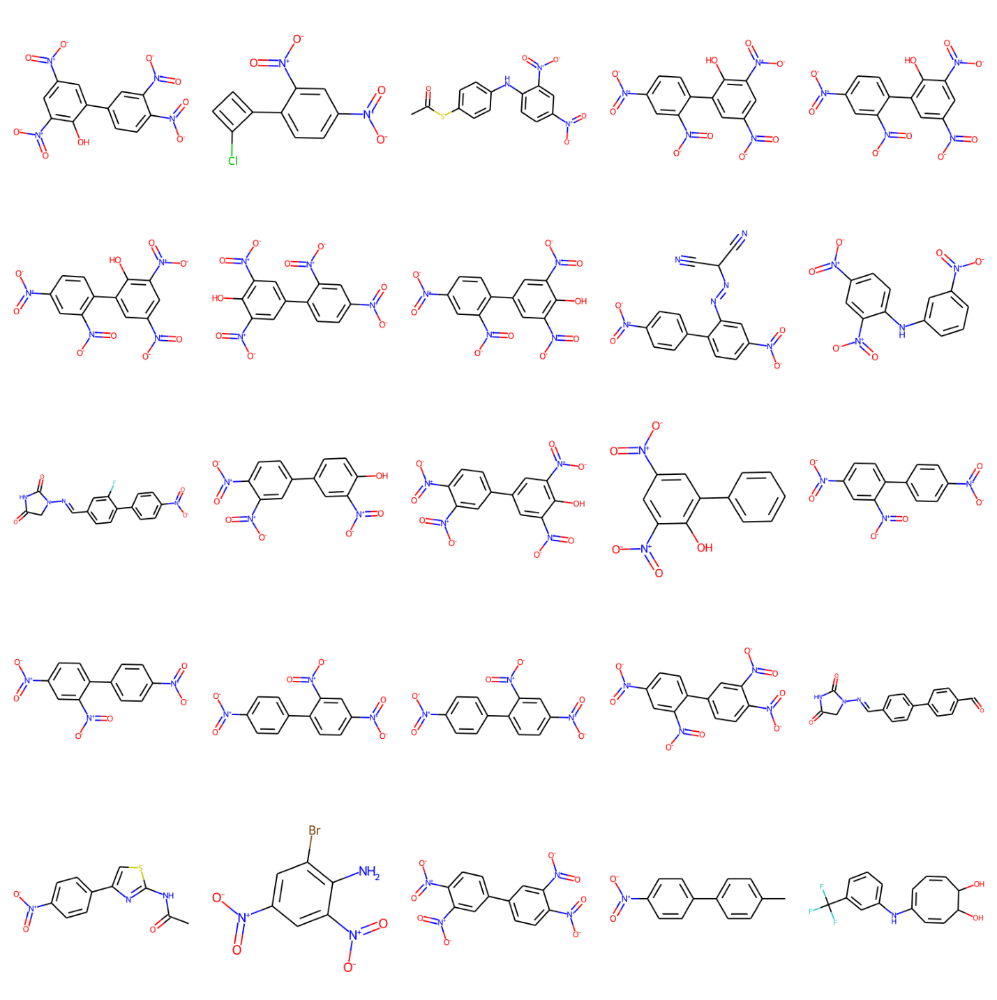

['c1c(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc([N+](=O)[O-])c1[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1O'
 'O=C(C)Sc1ccc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1(O)c(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])=CC=CC1O'
 'c1cc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc([N+](=O)[O-])c1'
 'c1(C=NN2CC(=O)NC2=O)ccc(-c2ccc([N+](=O)[O-])cc2)o1'
 'O=C(C)Sc1ccc(Nc2ccc([N+](=O)[O-])cc2)cc1'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccccc2)c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'c1cc(C=NN2CC(=O)NC2=O)ccc1-c1ccc(C=O)cc1'
 '[N+](=O)([O-])c1ccc(-c2csc(NC(C)=O)n2)cc1'
 '[O-][N+](=O)c1

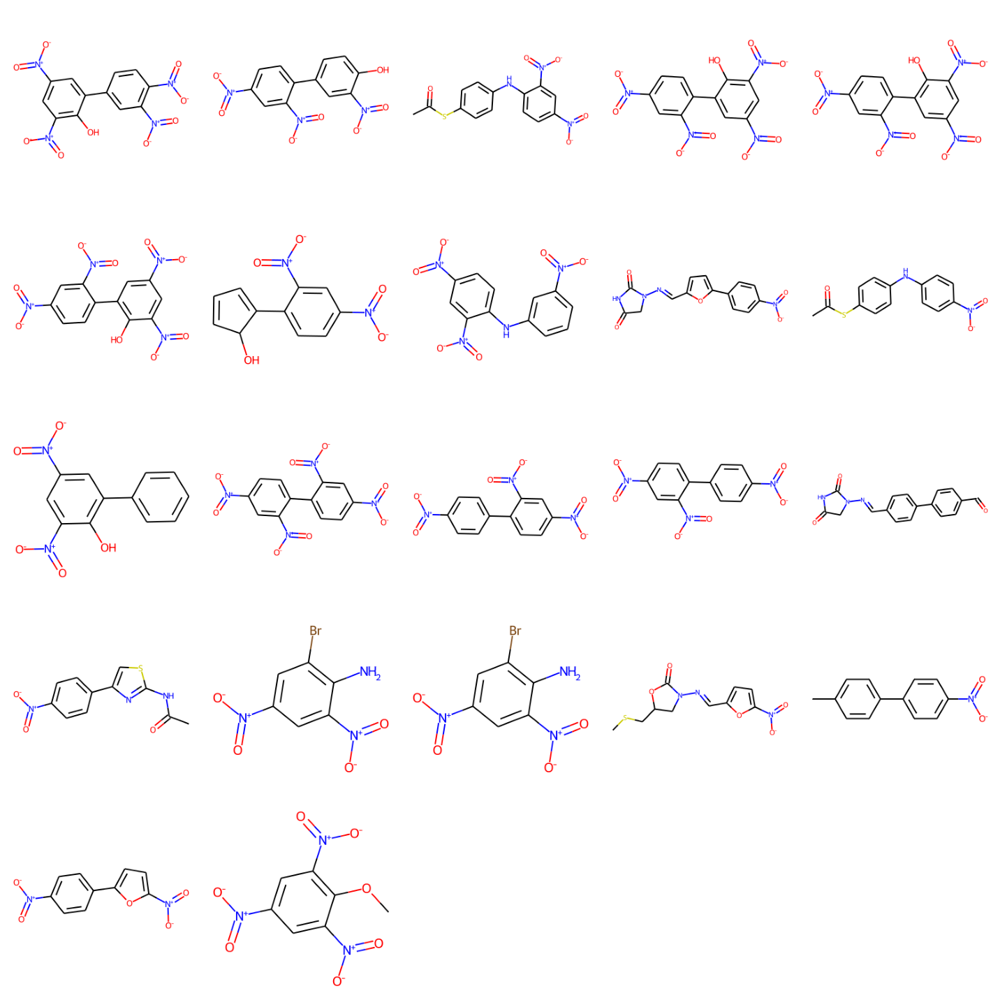

['c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1Nc1ccc(SC(C)=O)cc1'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])=CC=CC(O)C1O'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1c([N+](=O)[O-])cc([N+](=O)[O-])c(O)c1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c([N+](=O)[O-])c1'
 'c1cc(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])=CC=CC1O'
 'C1=C(c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])C(O)C(O)C(O)C1'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccccc2)c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1Nc1ccccc1'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1c([N+](=O)[O-])ccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(Br)c1N'
 'c1c([N+](=O)[O-])cc(Br)c(N)c1[N+](=O)[O-]'
 'c1([N+](=O)[O-])cc(Br)c(N)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1ccc(-c2ccc([N+](=O)[O-])cc2)cc1'
 '[N+](=O)([O-])c1ccc(C=NN2

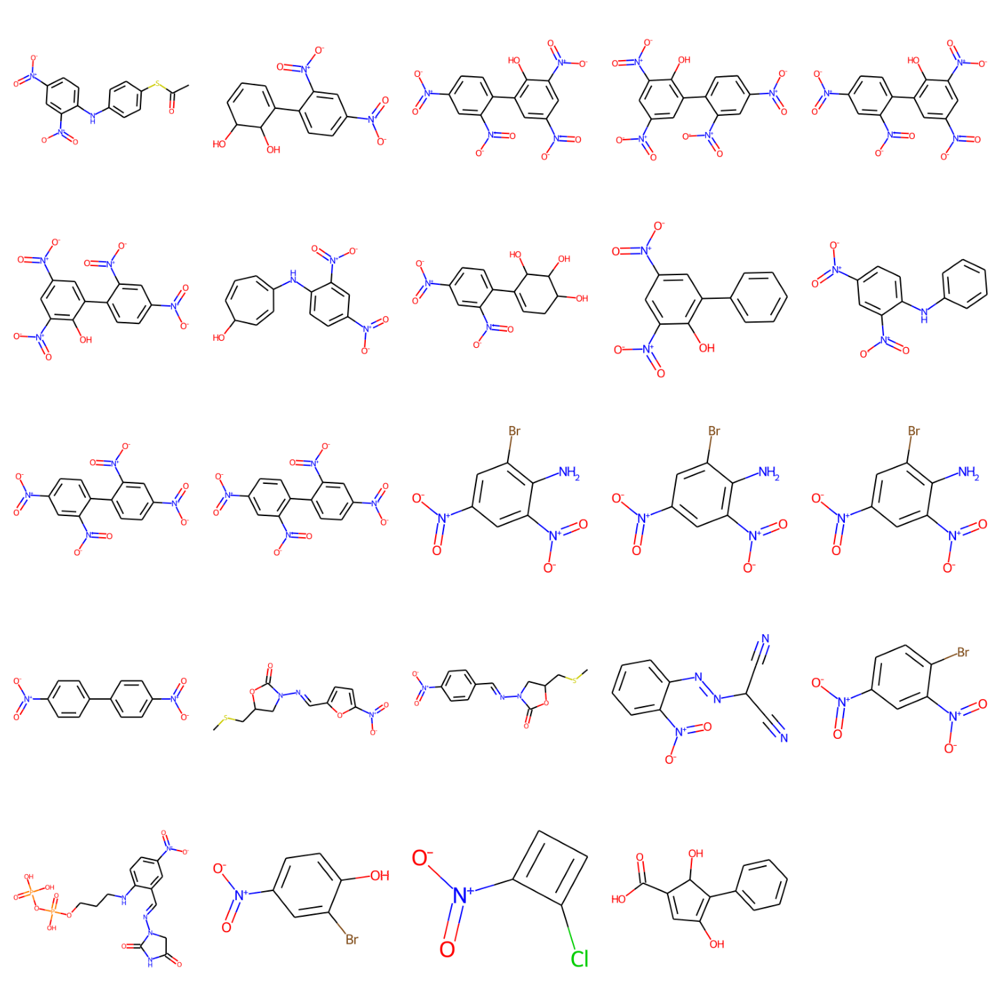

['c1(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)=CC=CC(O)C1O'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1SC(=S)N(C)C'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1O'
 '[N+](=O)([O-])c1ccc(C2=CC=CC(O)C2O)c([N+](=O)[O-])c1'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])=CC=CC(O)C1O'
 'c1c([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'C1(O)C=CC=C(Nc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])C=C1'
 'O=[N+]([O-])c1ccc(C2=CCC(O)C(O)C2O)c([N+](=O)[O-])c1'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccccc2)c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1c([N+](=O)[O-])cc(Br)c(N)c1[N+](=O)[O-]'
 'c1([N+](=O)[O-])cc(Br)c(N)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(Br)c1N'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N

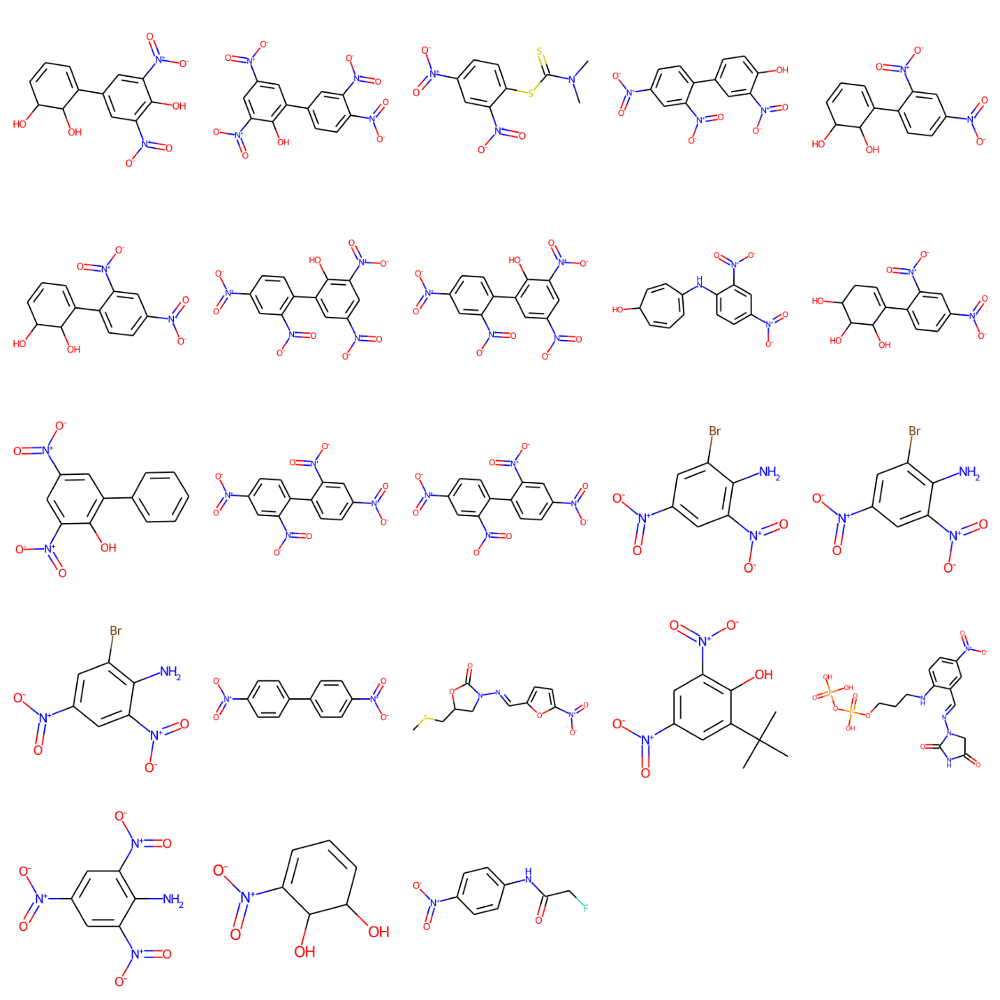

['c1(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)=CC=CC(O)C1O'
 '[N+](=O)([O-])c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc1[N+](=O)[O-]'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1Cl'
 '[O-][N+](=O)c1ccc(C2=CC=CC(O)C2O)c([N+](=O)[O-])c1'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])=CC=CC(O)C1O'
 '[N+](=O)([O-])c1ccc(C2=CC=CC(O)C2O)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1ccc(-c2ccc(O)c([N+](=O)[O-])c2)cc1'
 'O=[N+]([O-])c1ccc(C2=CCC(O)C(O)C2O)c([N+](=O)[O-])c1'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1-c1ccccc1N'
 '[N+](=O)([O-])c1cc([N+]

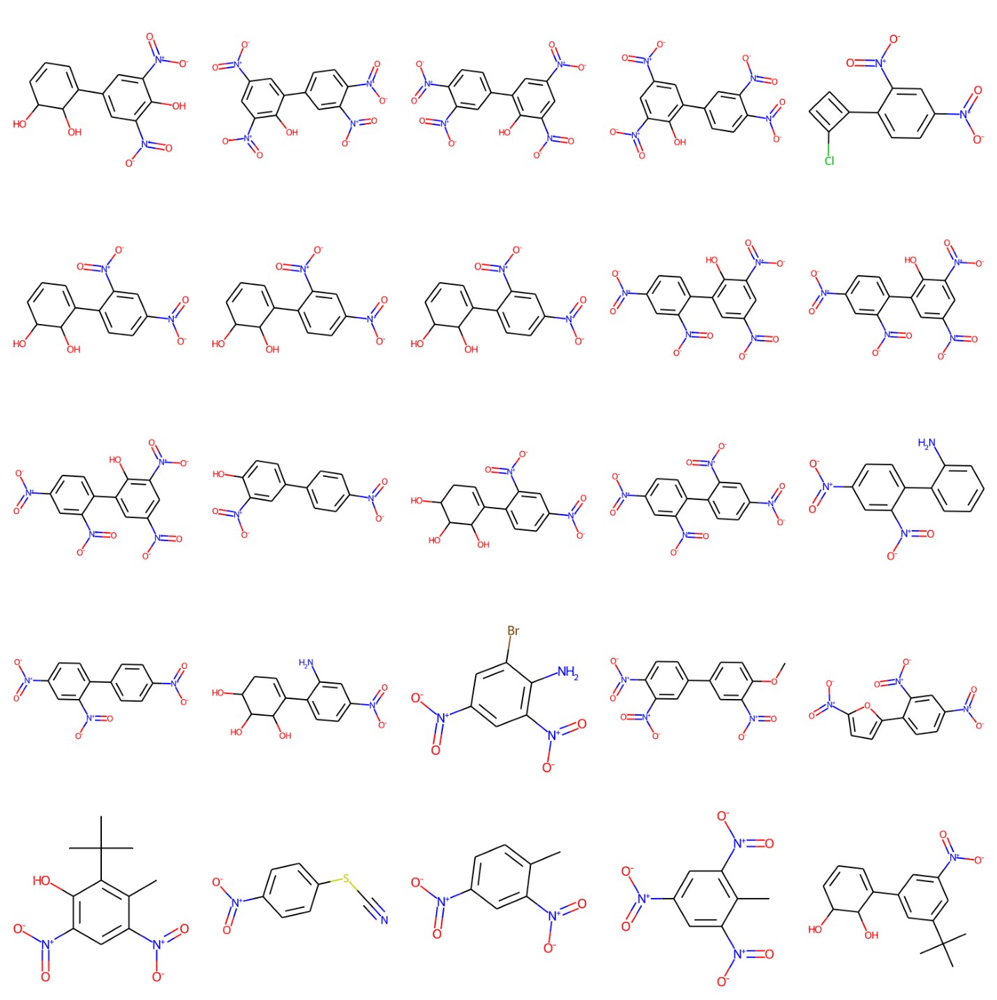

['[N+](=O)([O-])c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc1O'
 'c1cccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1Cl'
 'c1(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)=CC=CC(O)C1O'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1ccc(C2=CC=CC(O)C2O)c([N+](=O)[O-])c1'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])=CC=CC(O)C1O'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c1O'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1ccc(-c2ccc(O)c([N+](=O)[O-])c2)cc1'
 'O=[N+]([O-])c1ccc(C2=CCC(O)C(O)C2O)c([N+](=O)[O-])c1'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1C1=CCC(O)C(O)C=C1'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1[N+](=O)[O-]'
 'O=[N+]([O-])c1ccc(C2=C

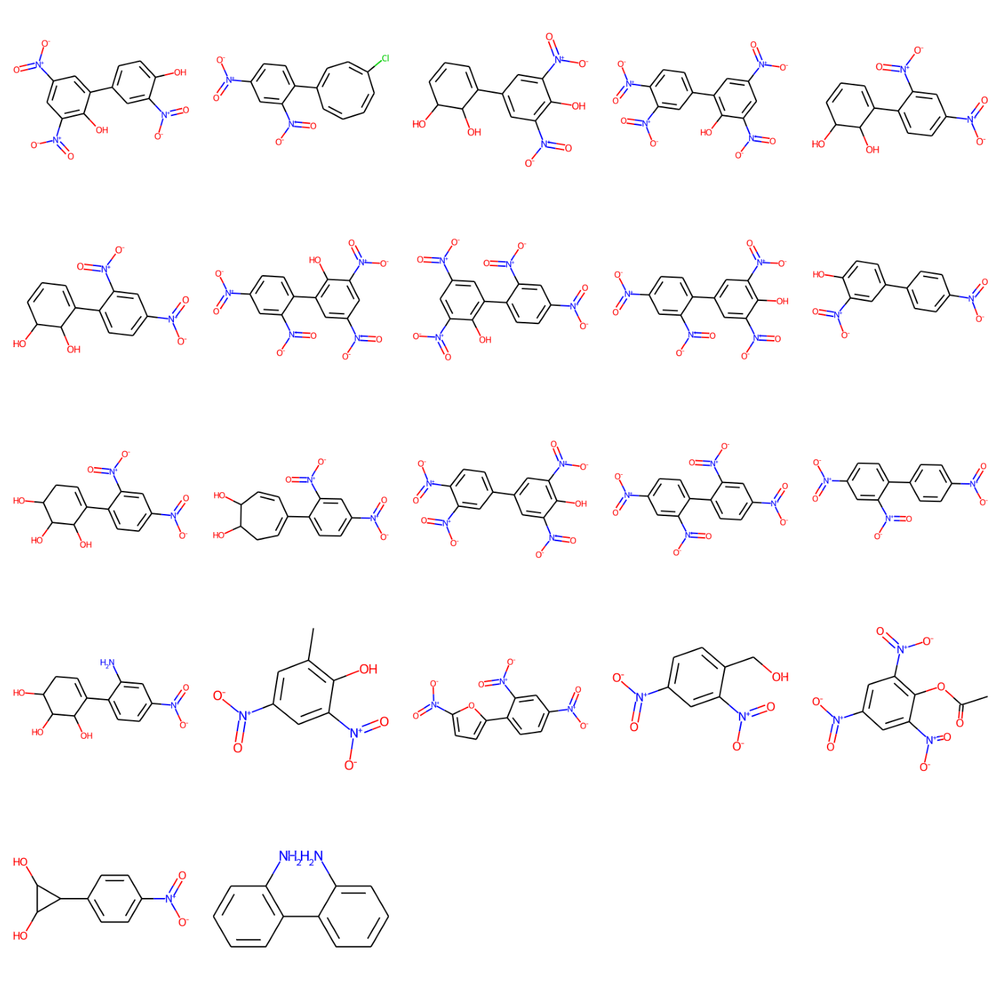

['[N+](=O)([O-])c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc1O'
 'c1cccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1Cl'
 '[O-][N+](=O)c1ccc(-c2ccc(O)c(N)c2)c([N+](=O)[O-])c1'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])=CC=CC(O)C1O'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'c1cc([N+](=O)[O-])ccc1-c1ccc(C(C)=O)cc1'
 '[O-][N+](=O)c1ccc(-c2ccc(O)c([N+](=O)[O-])c2)cc1'
 'c1(-c2ccc([N+](=O)[O-])cc2)ccc1Cl'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1C1=CCC(O)C(O)C=C1'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)ccc1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1ccc(-c2ccc(OC)cc2)c([N+](=O)[O-])c1'
 'O=[N+]

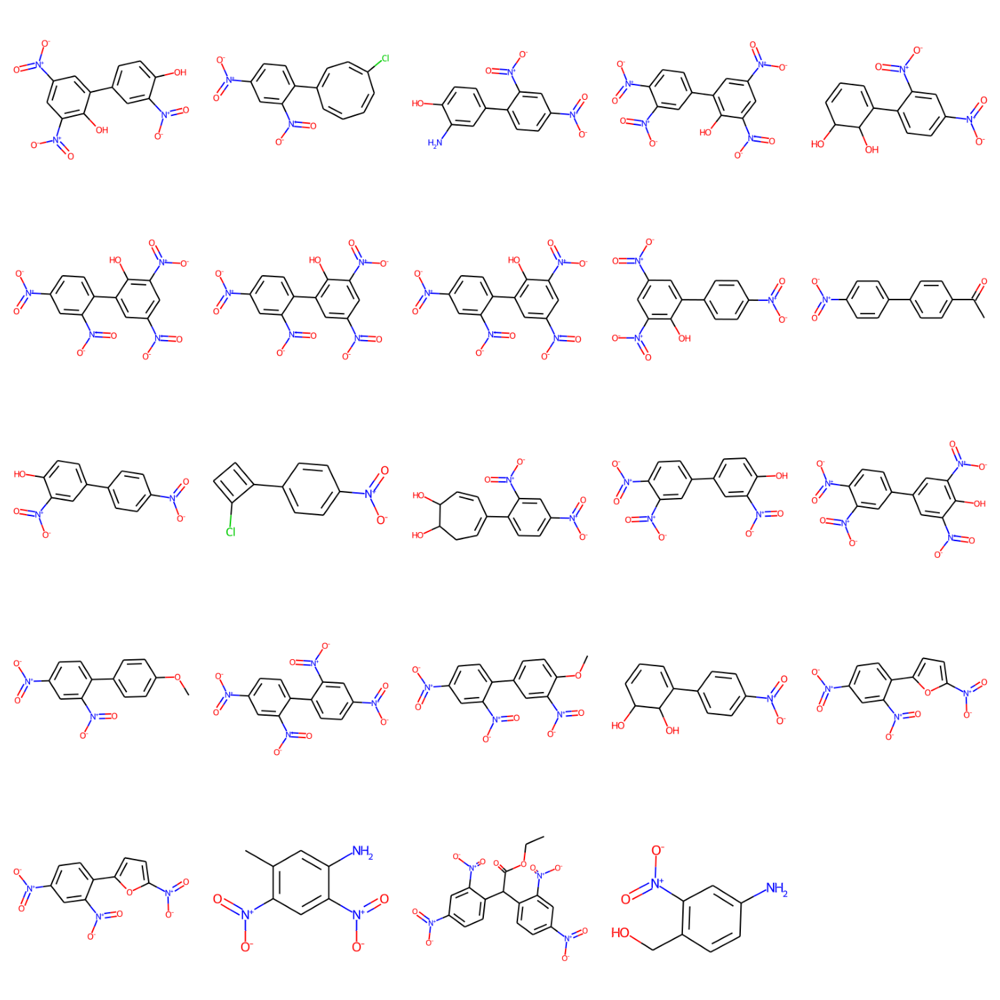

['c1(O)c(-c2ccc(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1Cl'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'C1(c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])=CC=CC(O)C1O'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1(-c2ccc([N+](=O)[O-])cc2)ccc1Cl'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1C1=CCC(O)C(O)C=C1'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1C1=CCC(O)C(O)C=C1'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1OC'
 'C1(O)C=CC=C(c2ccc([N+](=O)[O-])cc2)C(O)C(C(=O)O)C(C)O1'
 'c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])c1[N+](=O)[O-]'
 '[N+](=O)([

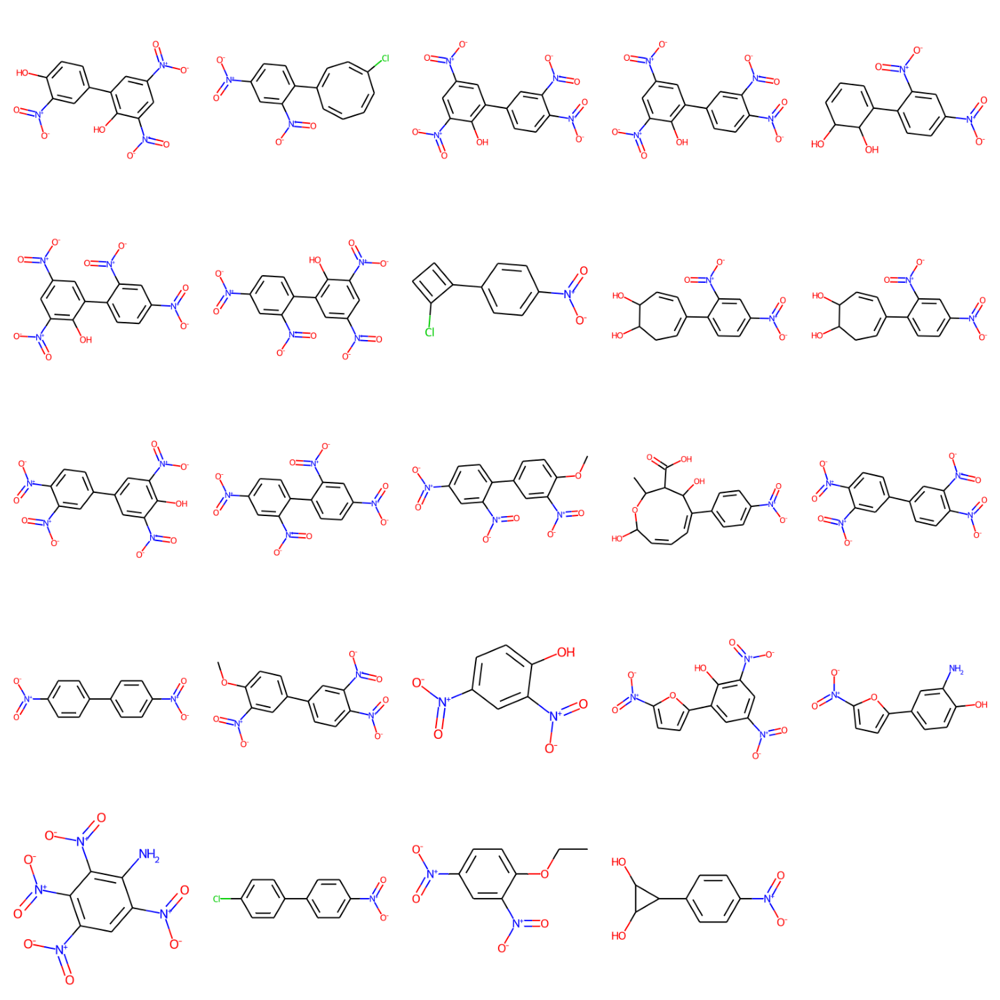

['c1(O)c(-c2ccc(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1Cl'
 'C1=CC(Cl)=CC=C(c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])C(C(=O)O)=C1'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'c1(O)ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1C1=CCC(O)C(O)C=C1'
 'c1(O)c([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc1[N+](=O)[O-]'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc([N+](=O)[O-])cc1'
 'C1(O)C=CC=C(c2ccc([N+](=O)[O-])cc2)C(O)C(C(=O)O)C(C)O1'
 'c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])c1'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-]

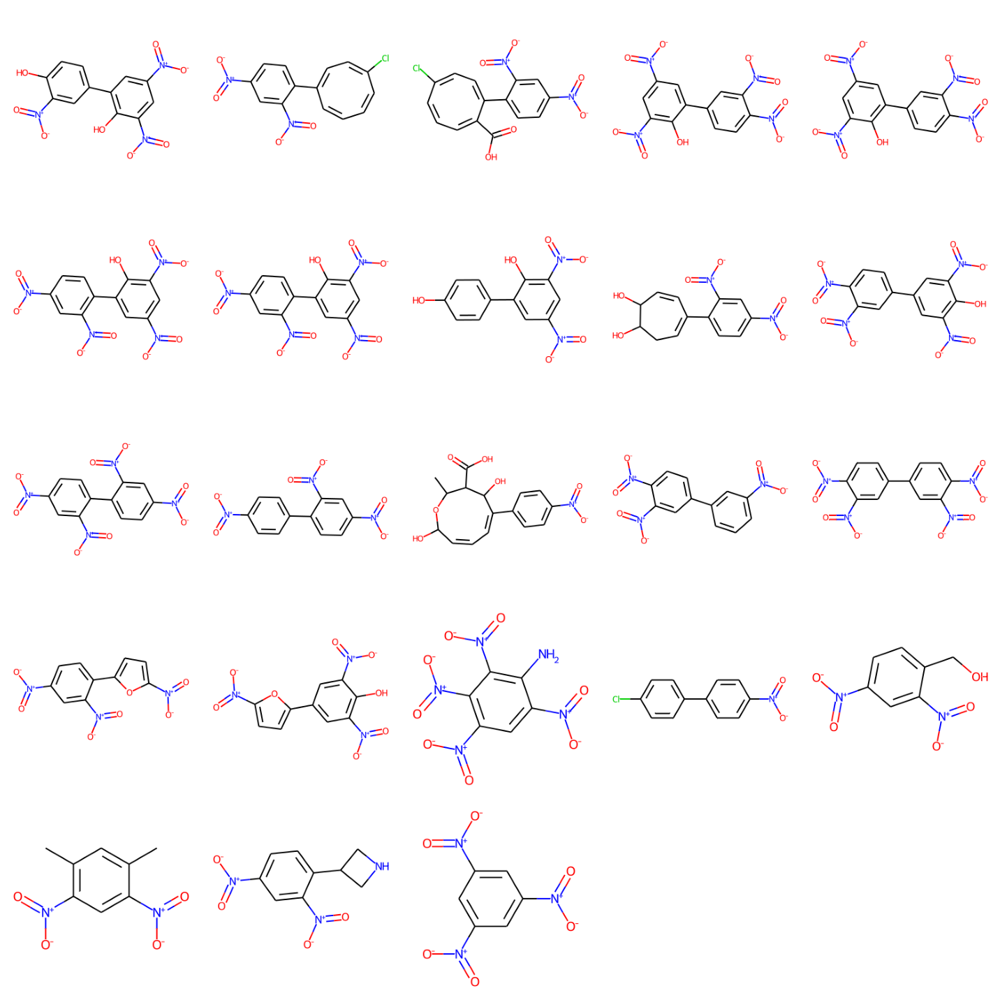

['Oc1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1[N+](=O)[O-]'
 'C(=O)(O)C1=CC=CC(Cl)=CC=C1c1ccc([N+](=O)[O-])cc1'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1cc([N+](=O)[O-])c([N+](=O)[O-])cc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1cc([N+](=O)[O-])ccc1C1=CC=CC(O)C1O'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'c1(O)ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'c1(O)c([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc1[N+](=O)[O-]'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc1[N+](=O)[O-]'
 'O=[N+]([O-])c1cc([N+

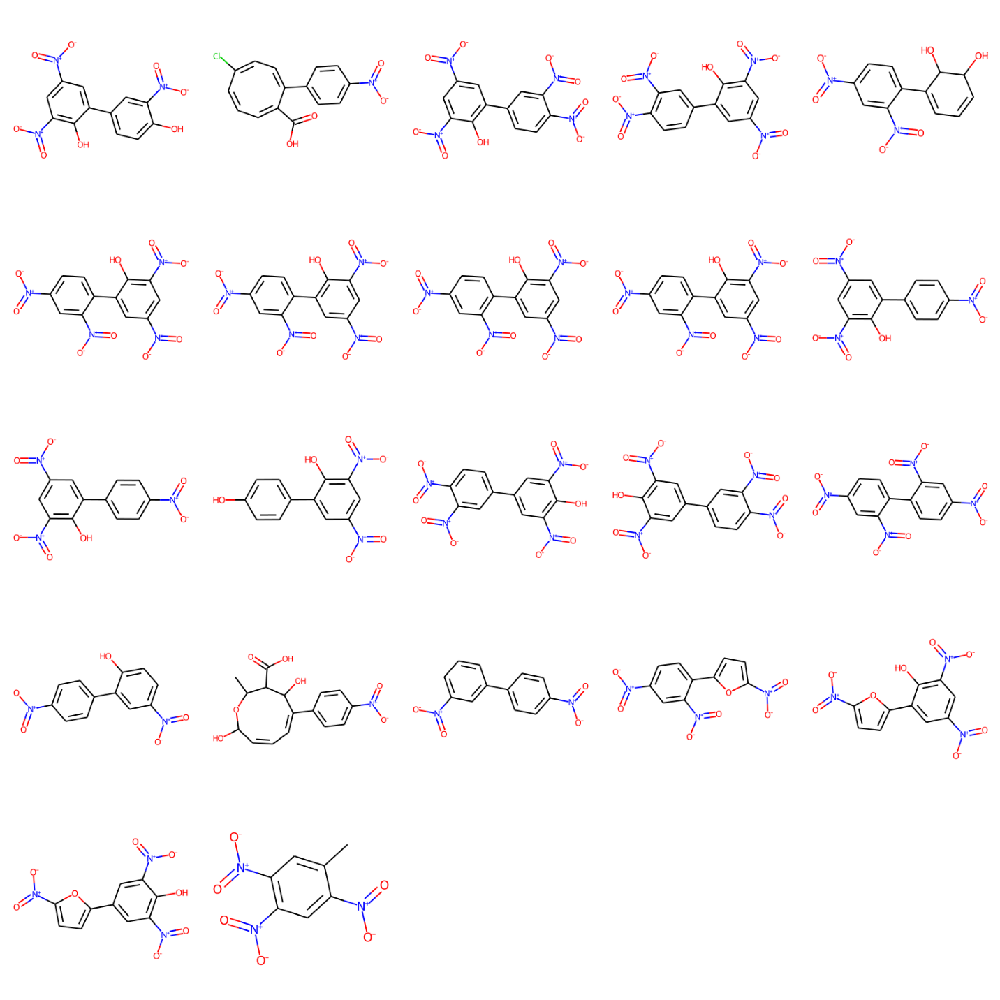

['Oc1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1O'
 '[O-][N+](=O)c1cc([N+](=O)[O-])ccc1C1=CC=CC(O)C1O'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc1'
 'C(=O)(O)C1=CC=CC(Cl)=CC=C1c1cc([N+](=O)[O-])ccc1C(=O)O'
 'c1(O)c([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc1[N+](=O)[O-]'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc1[N+](

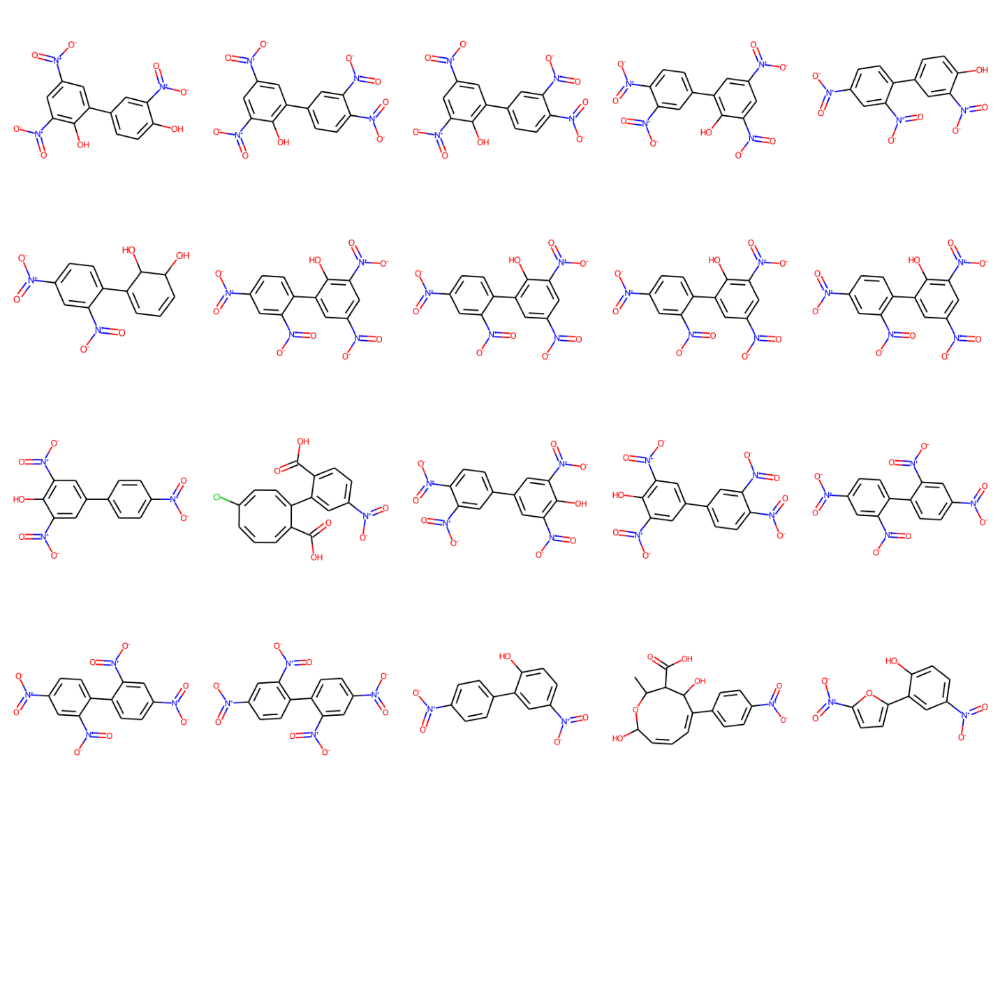

['Oc1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1[N+](=O)[O-]'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1O'
 'c1(O)ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c(O)c1'
 '[O-][N+](=O)c1cc([N+](=O)[O-])ccc1C1=CC=CC(O)C1O'
 'O=[N+]([O-])c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c([N+](=O)[O-])c1'
 'c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c([N+](=O)[O-])c1'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(C(=O)O)=C1'
 'c1cc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])c1'
 'O=[N+]([O-])c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c(O)c([N+](=O)[O-])c1'
 'c1(O)c([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc1[N+](=O)[O-]'
 

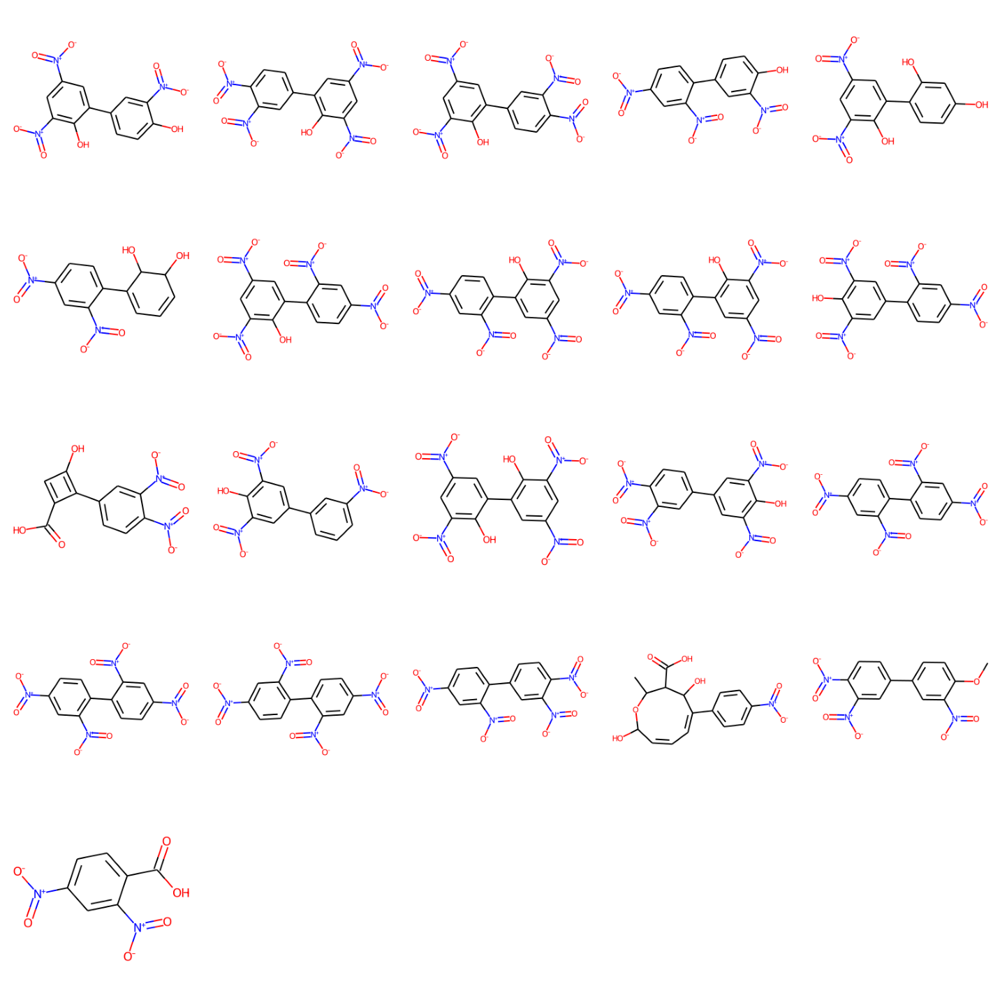

['[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1c([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c1[N+](=O)[O-]'
 'c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(C(=O)O)=C1'
 'O=[N+]([O-])c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc([N+](=O)[O-])c1O'
 'c1cc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])c1'
 'O=[N+]([O-])c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c(O)c([N+](=O)[O-])c1'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(O)C1O'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc1[N+](=O)[O-]'
 'c1cc([N+](=O)[O-])c([N+](=O)[O-])cc1C1=C(O)C1O'
 '[N+](=O)([O-])c1ccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c([N+](=O)[

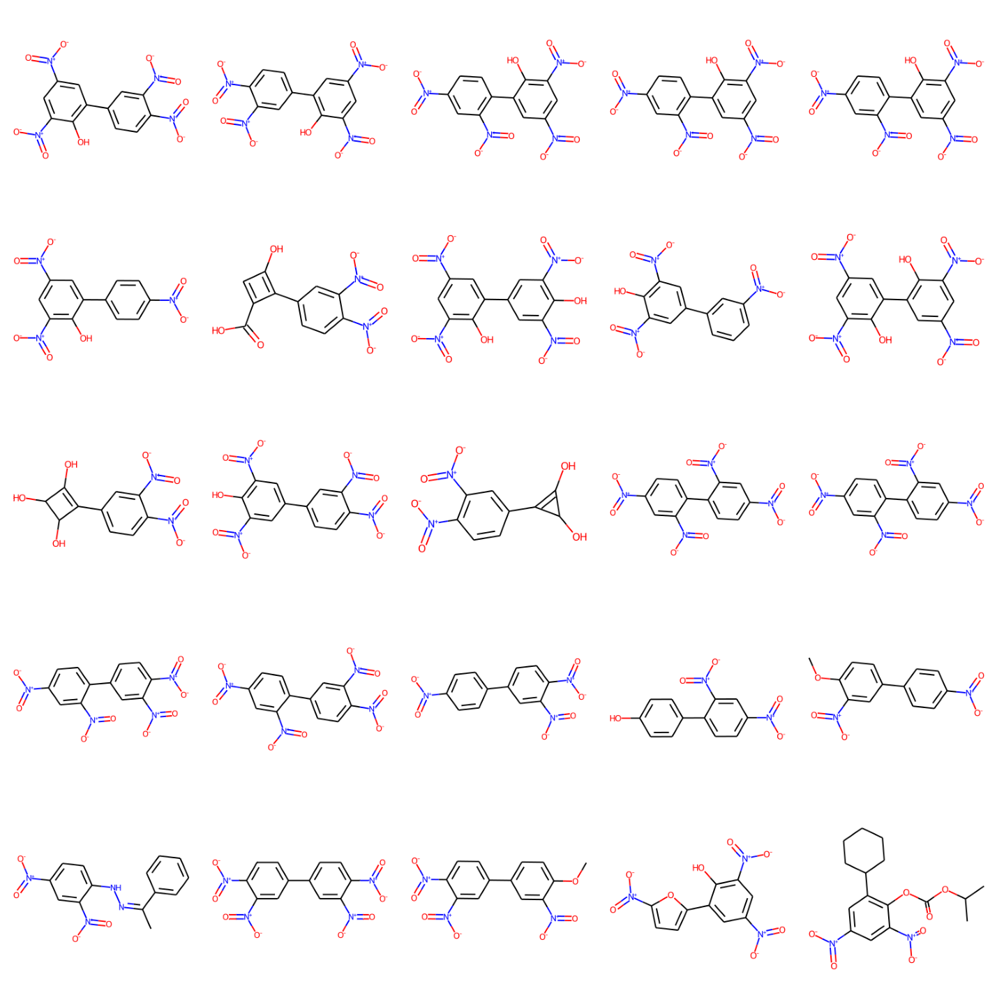

['[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c1O'
 '[N+](=O)([O-])c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'O=[N+]([O-])c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc1'
 'c1(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c1O'
 'O=[N+]([O-])c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc([N+](=O)[O-])c1O'
 'c1c(-c2cccc([N+](=O)[O-])c2)cc([N+](=O)[O-])c(O)c1[N+](=O)[O-]'
 'O=[N+]([O-])c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c(O)c([N+](=O)[O-])c1'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(O)C1O'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc1[N+](=O)[O-]'
 'c1([N+](=O)[O-])ccc(-c2ccc([N+](=O)[O-])

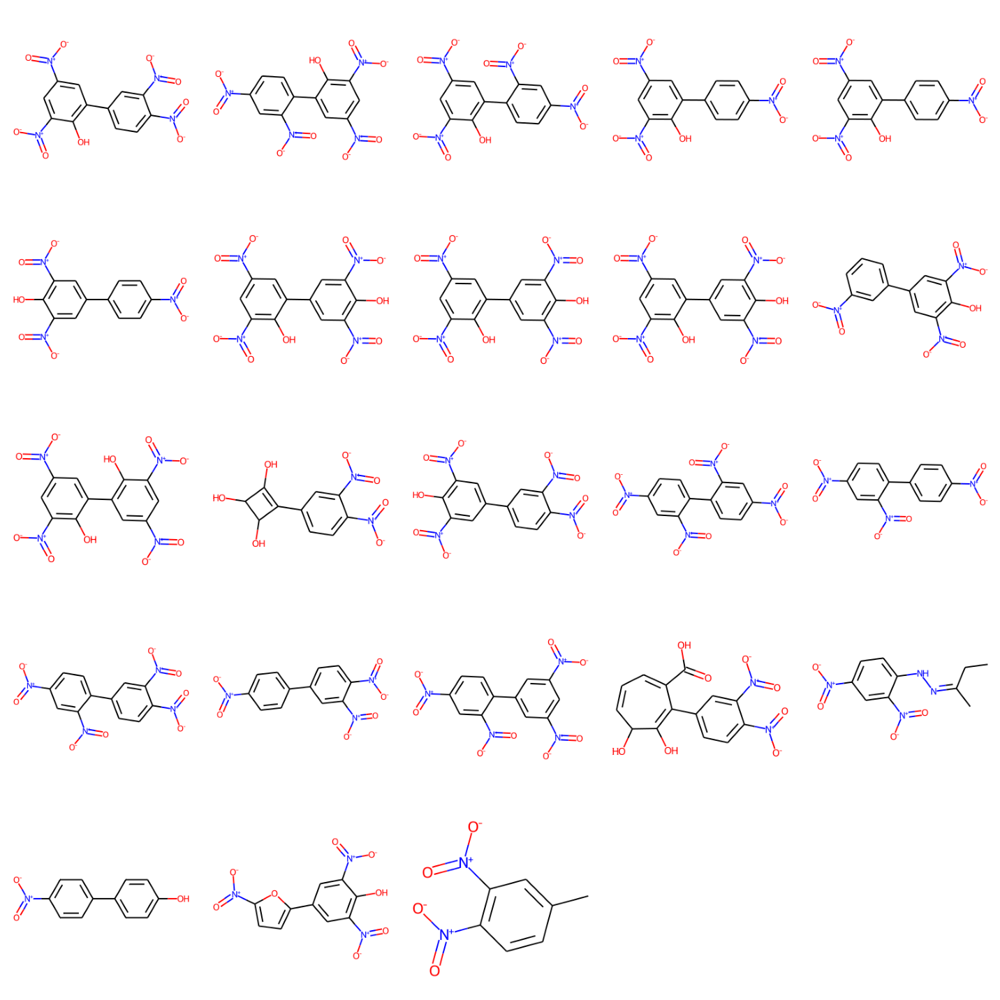

['c1c([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c1[N+](=O)[O-]'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2)c(O)c([N+](=O)[O-])c1'
 'c1cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'Oc1c(-c2ccc([N+](=O)[O-])cc2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc1'
 'c1([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])cc2)cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])cc2)ccc1O'
 'c1(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc([N+](=O)[O-])ccc1O'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(O)C(C(=O)O)=C1'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c1O'
 'c1(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c1O'
 '[O-][N+](=O)c1cc(-c2cccc([N+](=O)[O-])c2)cc([N+](=O)[O-])c1O'
 'c1(O)c(-c2ccc([N+](

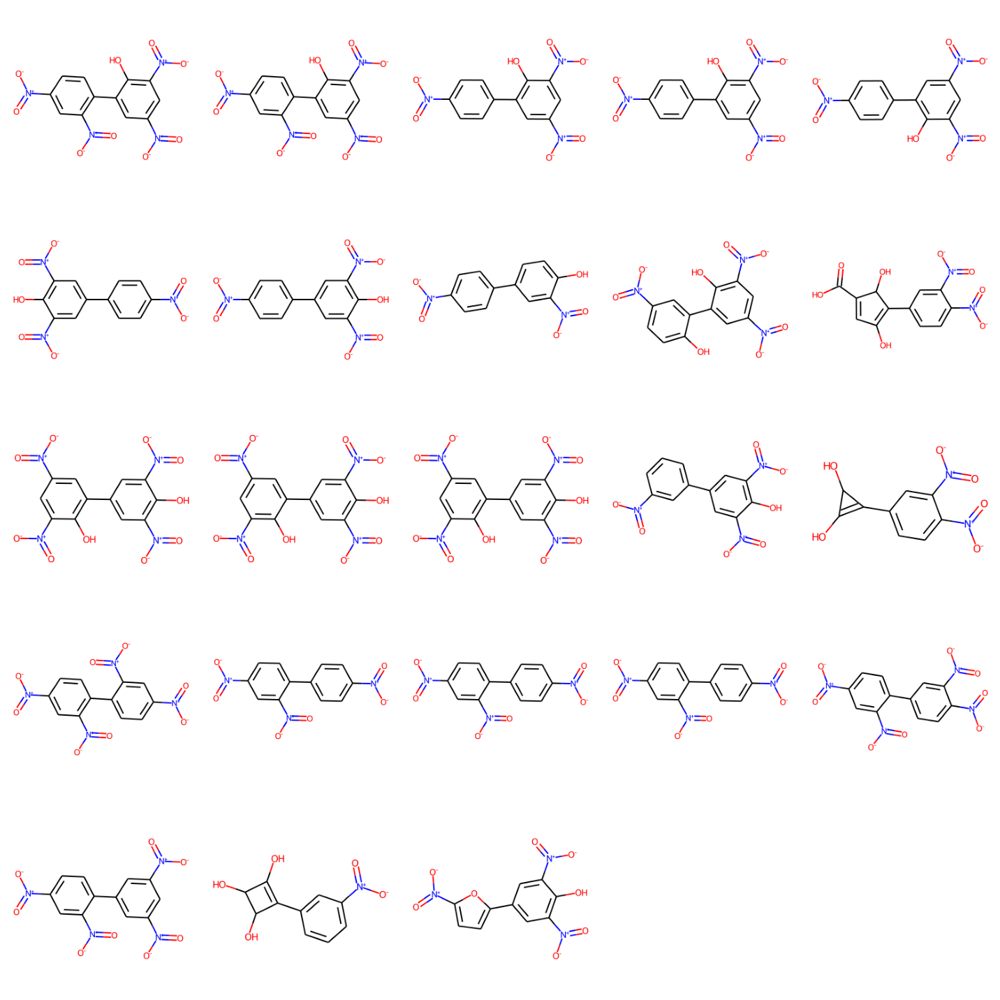

['c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C=CC=C(C(=O)O)C1O'
 'O=[N+]([O-])c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])ccc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'Oc1c(-c2ccc([N+](=O)[O-])cc2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'O=[N+]([O-])c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc1'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])cc2)ccc1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c1O'
 'c1(O)c(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccccc2)c1O'
 'c1([N+](=O)[O-])ccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])cc1'
 'O=[N+]([O-])c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1'
 'c1cc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])ccc1[N+](=O)[O-]'
 'c1([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])cc2)ccc

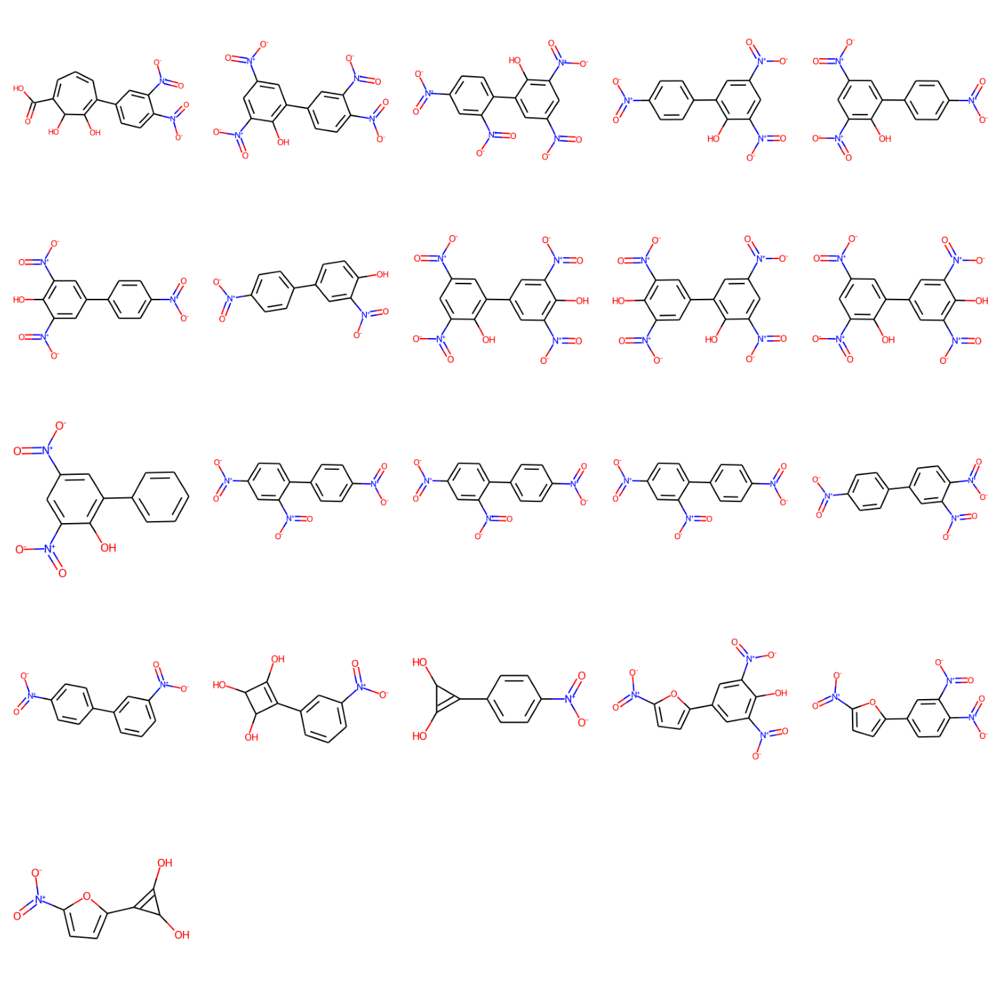

['c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C=CC=C(C(=O)O)C1O'
 'c1c(C2=C(O)C(O)C(C(=O)O)=CC=C2)ccc([N+](=O)[O-])c1[N+](=O)[O-]'
 'O=[N+]([O-])c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1c([N+](=O)[O-])cc([N+](=O)[O-])c(O)c1-c1ccc(O)cc1O'
 'Oc1c(-c2ccc([N+](=O)[O-])cc2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 '[O-][N+](=O)c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'c1c(-c2ccc([N+](=O)[O-])cc2)cc([N+](=O)[O-])c(O)c1[N+](=O)[O-]'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2)cc([N+](=O)[O-])c1O'
 'c1(O)c(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(O)C1O'
 'c1([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])cc2)=C1'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)ccc1O'
 'c1c([N+](=O)[O-])ccc(-c2ccc([N+](=O)[O-])cc2[N+](=O)[O-])c1[N+](=O)[O-]'
 'O=[N+]([O-])c1ccc(-c2cc([N+](=O)[O-])ccc2O)cc1[N+](=O)[O-]'
 'c1cc(-c2ccc([N+](=

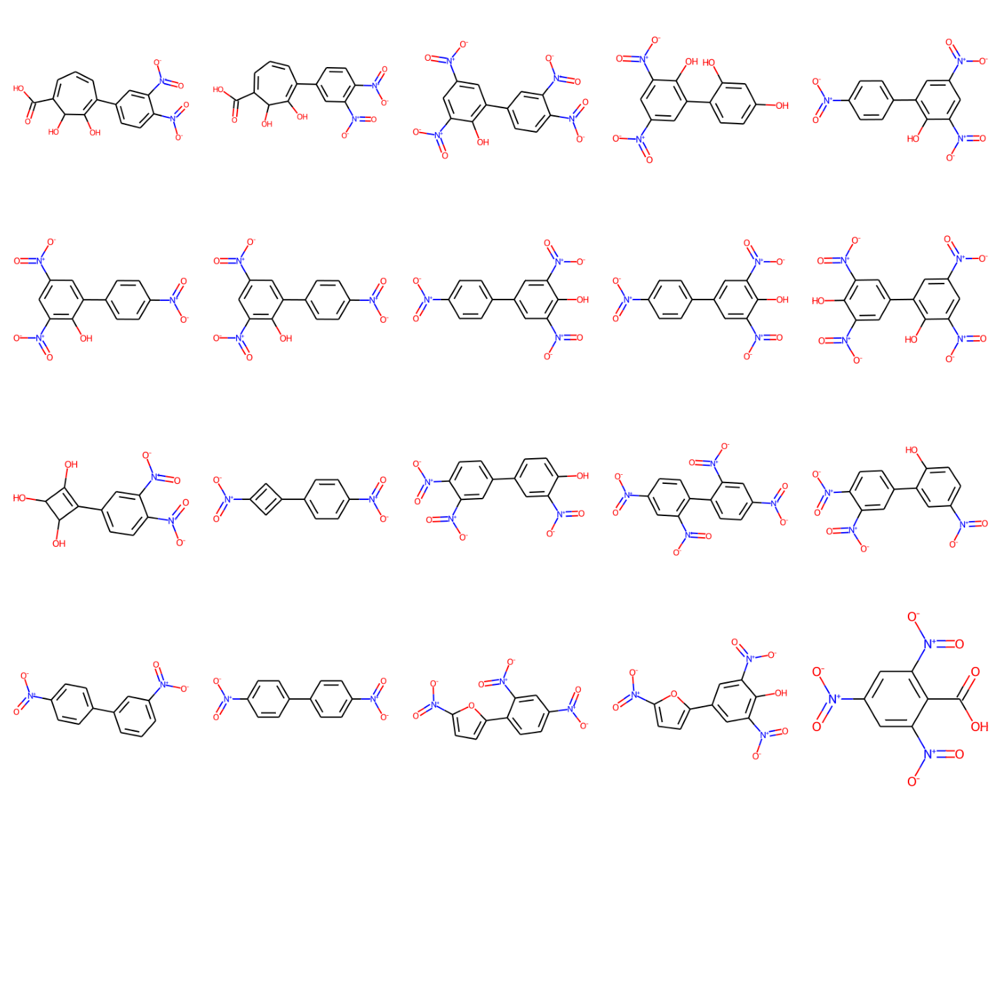

['C(=O)(O)C1=CC=CC(c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)=C(O)C1O'
 'c1c(C2=C(O)C(O)C(C(=O)O)=CC=C2)ccc([N+](=O)[O-])c1[N+](=O)[O-]'
 'C1=CC=C(C(=O)O)C(O)C(O)=C1c1ccc([N+](=O)[O-])c([N+](=O)[O-])c1'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C=CC=C(C(=O)O)C1O'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(O)C=C1'
 'c1c(C2=C(O)C(O)C(C(=O)O)=CC=C2)ccc([N+](=O)[O-])c1C'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1[N+](=O)[O-]'
 'c1cc([N+](=O)[O-])c([N+](=O)[O-])cc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'O=[N+]([O-])c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])cc2)cc([N+](=O)[O-])c1O'
 '[N+](=O)([O-])c1ccc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c([N+](=O)[O-])c1'
 'c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)=CC=CC1O'
 '[O-][N+](=O)c1cc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1ccc(C2=C(O)C(O)C2O)cc1[N+]

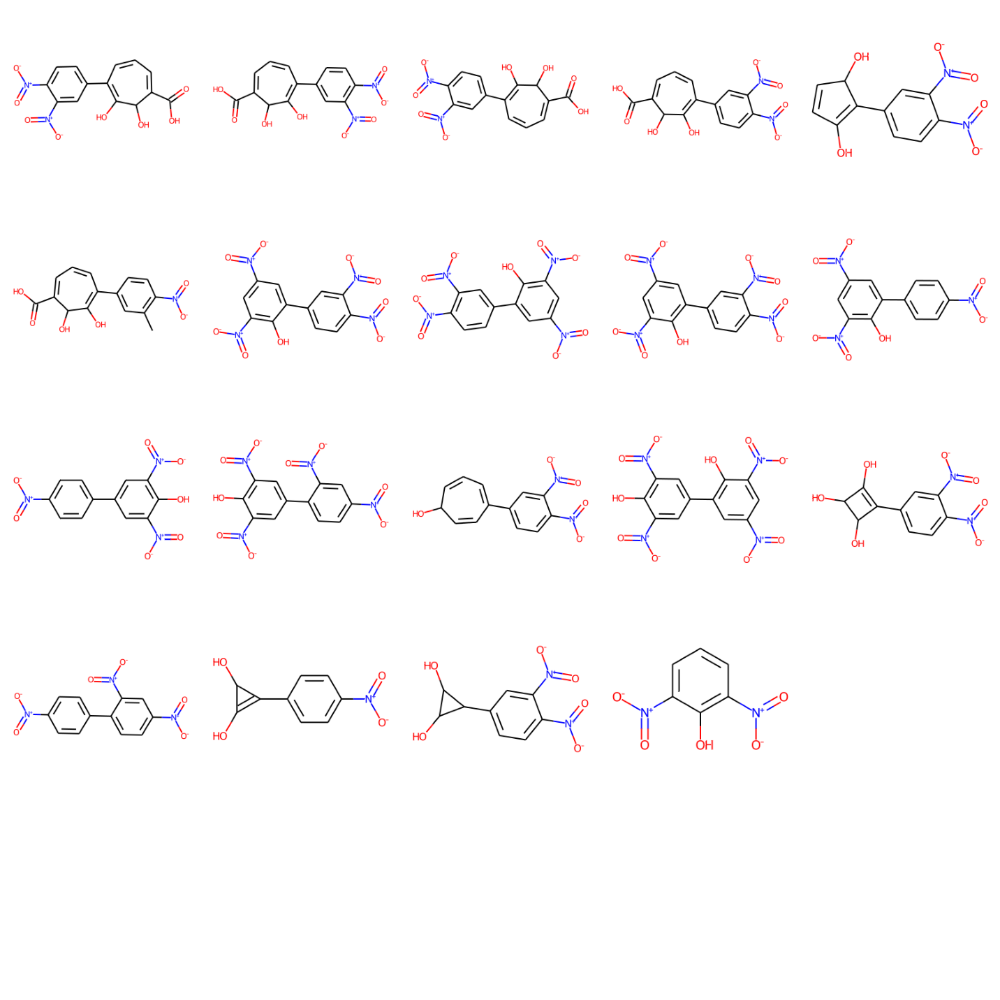

['c1c(C2=C(O)C(O)C(C(=O)O)=CC=C2)ccc([N+](=O)[O-])c1O'
 'C1=CC=C(C(=O)O)C(O)C(O)=C1c1ccc([N+](=O)[O-])cc1'
 'C(=O)(O)C1=CC=CC(c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)=C(O)C1O'
 'c1c(C2=C(O)C(O)C(C(=O)O)=CC=C2)ccc([N+](=O)[O-])c1[N+](=O)[O-]'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C=CC=C(C(=O)O)C1O'
 '[O-][N+](=O)c1cc(C2=C(O)C(O)C(C(=O)O)=CC=C2)cc([N+](=O)[O-])c1'
 'c1c(C2=C(O)C(O)C(C(=O)O)=CC=C2)ccc([N+](=O)[O-])c1C'
 'C1(O)=C(c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(=O)C(O)=C(c2ccccc2)C1=O'
 'O=[N+]([O-])c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'OC1=C(c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C=C1'
 'C1(C(=O)O)=CC=CC(c2ccc([N+](=O)[O-])cc2)C1O'
 '[O-][N+](=O)c1cc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 '[O-][N+](=O)c1ccc(C2=C(O)C(O)C2O)cc1[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc([N+](=O)[O-])cc(-c2ccccc2)c1O'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(C(=O)O)=

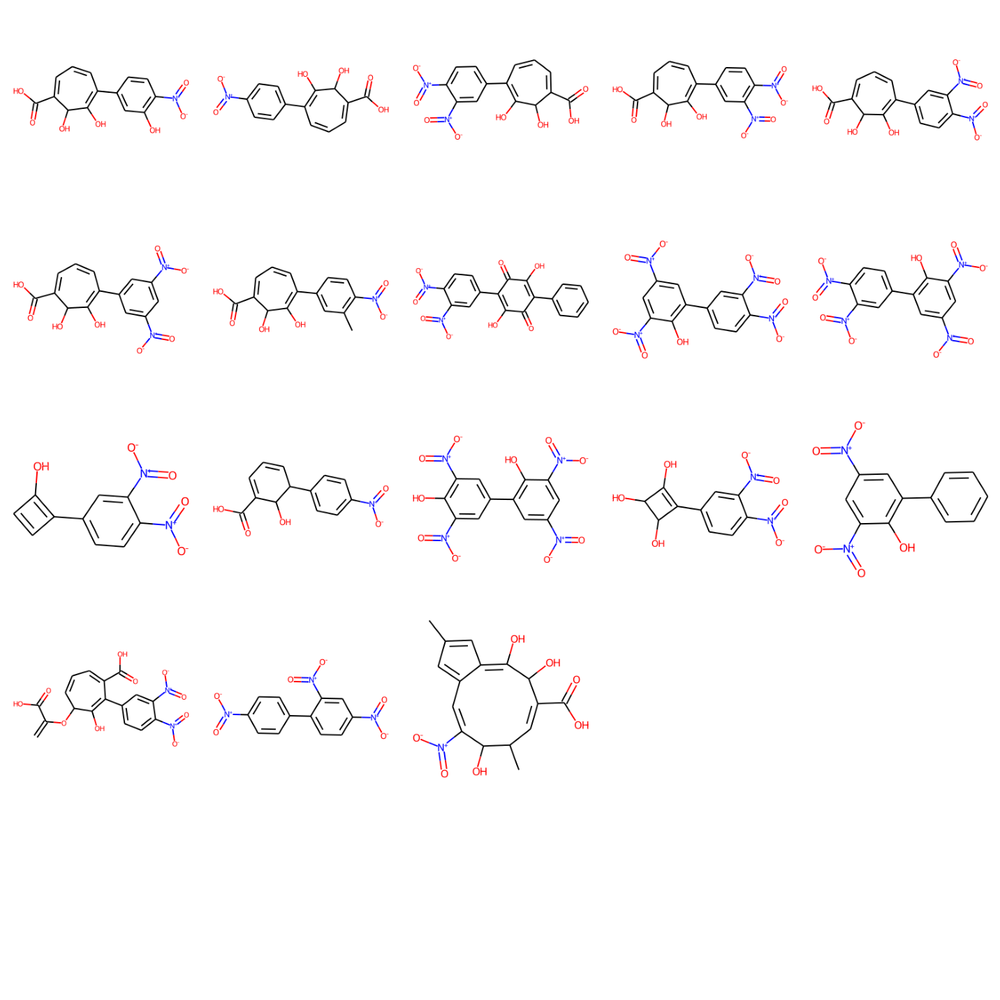

['c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C=CC=C(C(=O)O)C1O'
 'c1c(C2=C(O)C(O)C(C(=O)O)=CC=C2)ccc([N+](=O)[O-])c1C'
 'C1(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 'C1(O)=C(c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(=O)C(O)=C(c2ccccc2)C1=O'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'OC1=C(c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C=C1'
 'c1c(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc([N+](=O)[O-])c(O)c1[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(O)C1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)ccc1O'
 '[O-][N+](=O)c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)cc([N+](=O)[O-])c1O'
 'OC1C(C(=O)O)=CC=CC(c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C1O'
 '[O-][N+](=O)c1cc(C2=C(O)C(OC(=C)C(=O)O)C=CC=C2C(=O)O)ccc1[N+](=O)[O-]'
 'Oc1c(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)C1O'
 'c1cc([N+](=O)[O-])ccc1-c1ccc([N+](=O)[O-])cc1[N+](=O)[

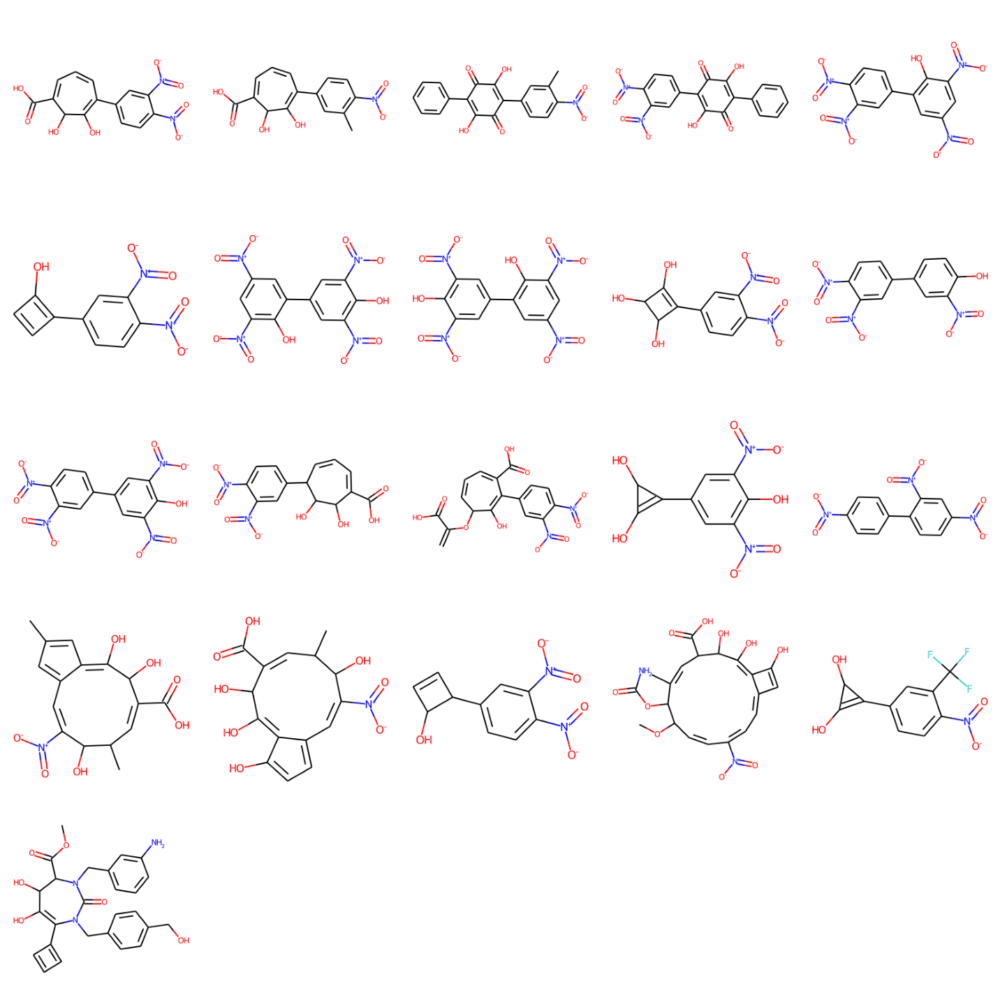

['[O-][N+](=O)c1ccc(C2=C(O)C(O)C(C(=O)O)=CC=C2)cc1'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C=CC=C(C(=O)O)C1O'
 'c1cc(C2=C(O)C(O)C(C(=O)O)=CC=C2)cc([N+](=O)[O-])c1'
 'OC(=O)C1=CC=CC(c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C=CC=C(C(=O)O)C1O'
 'c1c(C2=C(O)C(O)C(C(=O)O)=CC=C2)ccc([N+](=O)[O-])c1C'
 'C1(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 'c1cc([N+](=O)[O-])c([N+](=O)[O-])cc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'c1c(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc([N+](=O)[O-])c(O)c1[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc(-c2cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C(O)C1O'
 'c1cc(C2=C(O)C(OC(=C)C(=O)O)C=CC=C2C(=O)O)cc([N+](=O)[O-])c1'
 'Cc1cc(C2=C(O)C(=O)C(c3ccccc3)=C(O)C2=O)=C1'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C1O'
 'c1(O)c(-c2cc

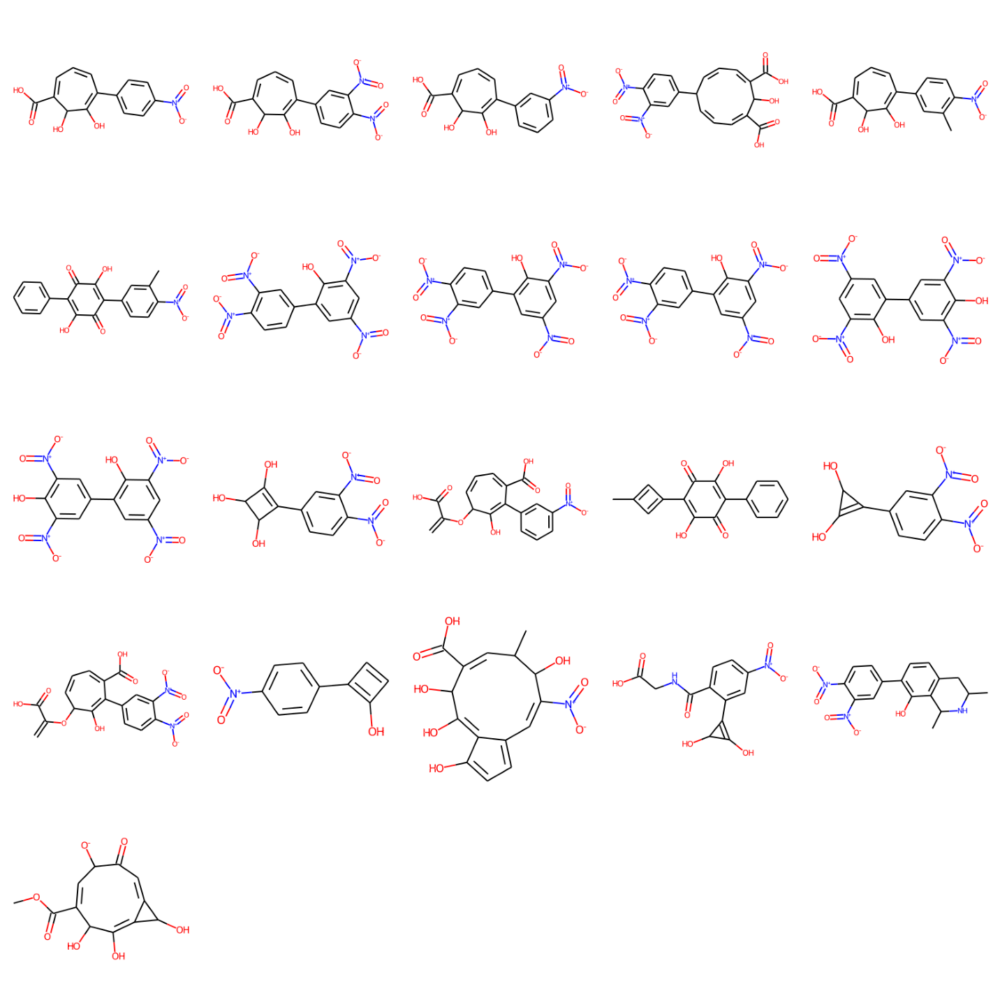

['[O-][N+](=O)c1ccc(C2=C(O)C(O)C(C(=O)O)=CC=C2)cc1'
 'OC1=C(c2ccc([N+](=O)[O-])cc2)C=CC=C(C(=O)O)C1O'
 'c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc([N+](=O)[O-])c1O'
 'c1cc([N+](=O)[O-])ccc1C1=C(O)C(O)C(C(=O)O)=CC=CC1O'
 'C1(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'c1([N+](=O)[O-])ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 'c1([N+](=O)[O-])ccc(C2=C(O)C(=O)C(c3ccccc3)=C(O)C2=O)o1'
 'OC1C(C(=O)O)=CC=CC(c2cccc([N+](=O)[O-])c2)=C1'
 'O=[N+]([O-])c1cc(C2=C(O)C(O)C2O)ccc1O'
 'O=[N+]([O-])c1cccc(C2=C(O)C(OC(=C)C(=O)O)C=CC=C2C(=O)O)c1'
 'C1(O)=C(c2ccccc2)C(=O)C(O)=C(c2ccccc2)C1=O'
 'C1(O)C(C(=O)O)=CC=CC(c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C1O'
 'c1(O)c(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)C1O'
 'c1([N+](=O)[O-])ccc(C2=C(O)C(O)C(C(=O)O)=CC(C)C1O)cc2C'
 '[O-][N+](=O)c1cc(C2=C(O)C(O)C(C(=O)O)=CC(C)C1O)ccc2O'
 'O=C1C(O)=C(C2=CC(C)=C2)C(=O)C(=O)C1=C1C(=O)C(O)=C(C)C(O)=C1O'
 '[O-][N+](=O)c

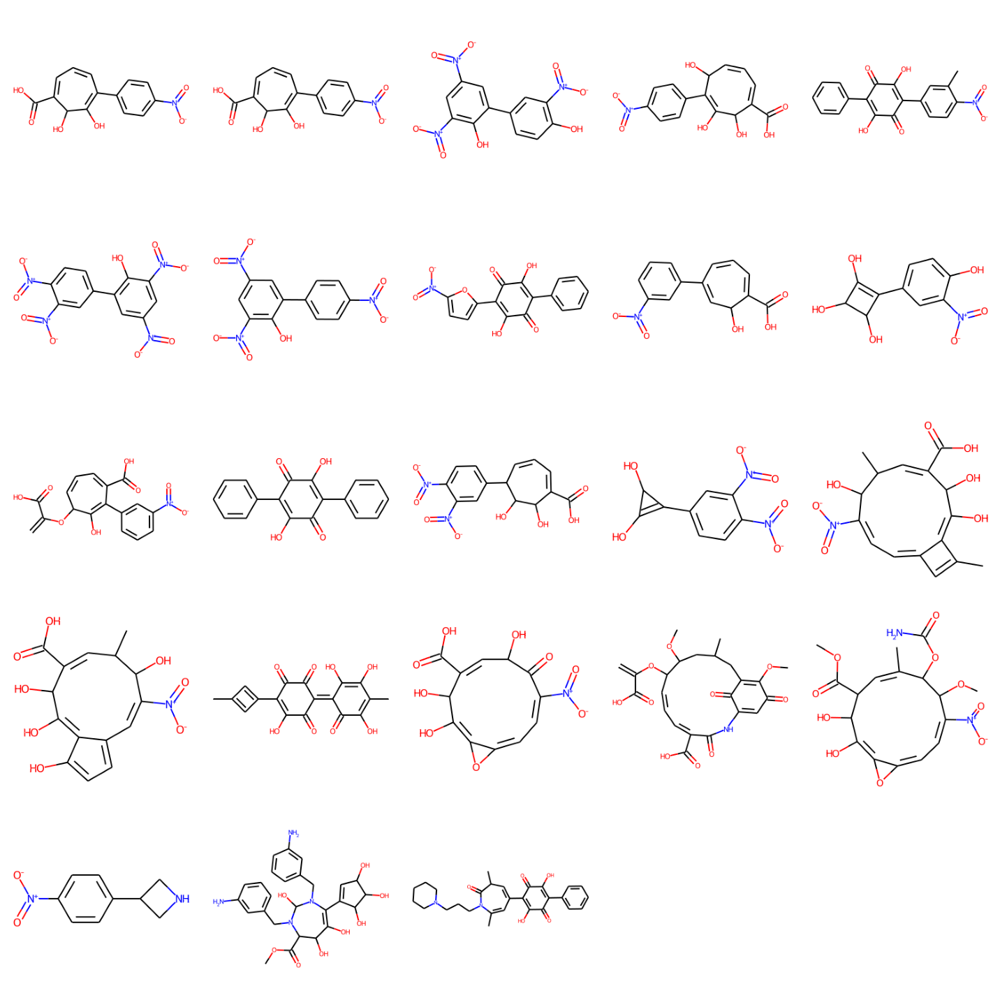

['OC1=C(c2ccc([N+](=O)[O-])cc2)C=CC=C(C(=O)O)C1O'
 '[O-][N+](=O)c1cc(-c2ccc(O)c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'c1([N+](=O)[O-])ccc(C2=C(O)C(=O)C(c3ccccc3)=C(O)C2=O)cc1N'
 'c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc([N+](=O)[O-])c1'
 'C1(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 '[O-][N+](=O)c1cc(C2=C(O)C(O)C(C(=O)OC)O2)c(C)c([N+](=O)[O-])c1'
 'c1([N+](=O)[O-])cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc1[N+](=O)[O-]'
 '[O-][N+](=O)c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1[N+](=O)[O-]'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'c1cc([N+](=O)[O-])ccc1C1=C(O)C(O)C(C(=O)O)=CC=CC1OC(=C)C(=O)O'
 'O=C1C(O)=C(c2ccccc2)C(=O)C(O)=C1c1ccc([N+](=O)[O-])c(C(F)(F)F)c1'
 'OC1C(C(=O)O)=CC=CC(c2cccc([N+](=O)[O-])c2)=C1'
 '[N+](=O)([O-])c1cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)ccc1O'
 'O=[N+]([O-])c1cc(C2=C(O)C(O)C2O)ccc1O'
 'C1(O)=C(c2ccccc2)C(=O)C(O)=C(c2ccccc2)C1=O'
 'c1([N+](=O)[O-])ccc(C2=C(O)C(O)C(C(=O)O)=CC(C)C1O)cc

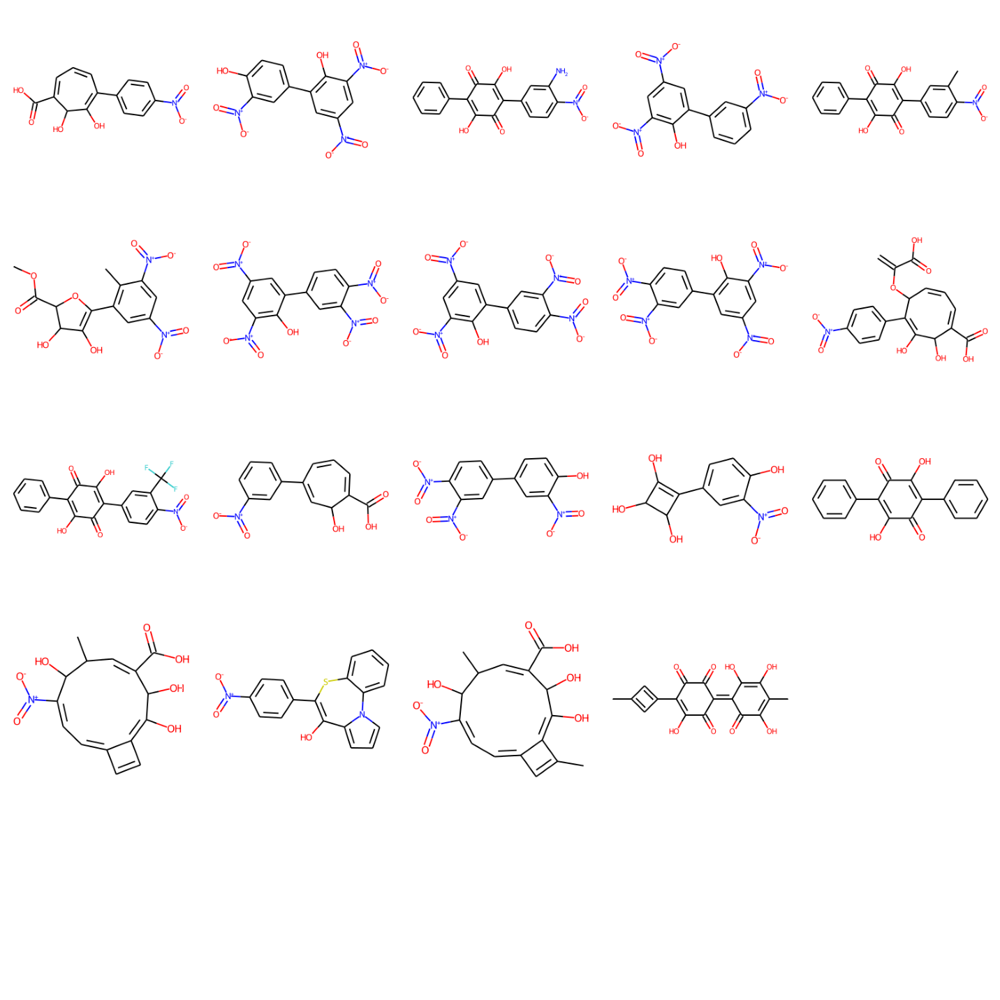

['[O-][N+](=O)c1cc(-c2ccc(O)c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'O=C1C(O)=C(c2ccccc2)C(=O)C(O)=C1c1ccc([N+](=O)[O-])cc1'
 'O=[N+]([O-])c1cc([N+](=O)[O-])cc(-c2cccc([N+](=O)[O-])c2)c1O'
 'c1ccccc1C1=C(O)C(=O)C(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C1=O'
 'C1(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 'c1c(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc([N+](=O)[O-])c1[N+](=O)[O-]'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1([N+](=O)[O-])cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc1[N+](=O)[O-]'
 'c1ccc(C2=C(O)C(=O)C(c3ccc([N+](=O)[O-])c(C)c3)=C(O)C2=O)ccc1=O'
 '[O-][N+](=O)c1ccc(C2=C(O)C(=O)C(c3ccccc3)=C(O)C2=O)o1'
 'OC1C(C(=O)O)=CC=CC(c2cccc([N+](=O)[O-])c2)=CC=CC(O)C1O'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccccc2)c1O'
 'C1(O)=C(c2ccccc2)C(=O)C(O)=C(c2ccccc2)C1=O'
 'O=C1C(O)=C(c2ccccc2)C(=O)C(O)=C1c1ccccc1'
 'c1([N+](=O)[O-])ccc(C2=C(O)C(O)C(C(=O)O)=CC(C)C1O)cc2'
 'C1=CC(OC(=C)C(=O)O)C(c2ccc([N+](=O)[O-])cc2)=C(O)C(C(=O)O)=C1'
 'c1(C

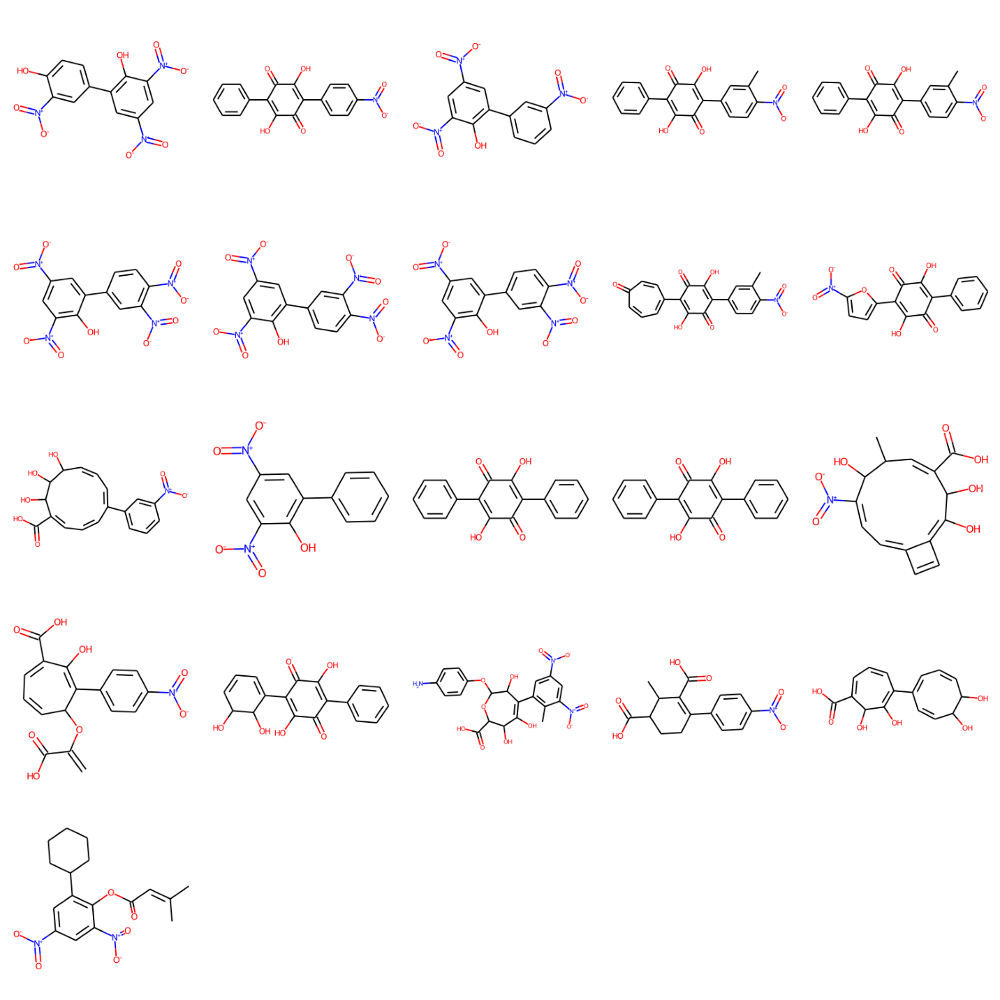

['[O-][N+](=O)c1cc(-c2ccc(O)c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'Oc1c(-c2ccc(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccc(O)c(OC)c2)c1O'
 'O=[N+]([O-])c1cc([N+](=O)[O-])cc(-c2cccc(-c3ccccc3)c2)c1O'
 'O=C1C(O)=C(c2ccc([N+](=O)[O-])c(C)c2)C(=O)C(O)=C1c1ccccc1'
 'c1ccccc1C1=C(O)C(=O)C(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C1=O'
 'C1(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1([N+](=O)[O-])cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc1[N+](=O)[O-]'
 'c1ccc(C2=C(O)C(=O)C(c3ccc([N+](=O)[O-])c(C)c3)=C(O)C2=O)ccc1=O'
 'C1(O)=C(c2ccccc2)C(=O)C(O)=C(c2ccccc2)C1=O'
 'c1cccc(C2=C(O)C(=O)C(c3ccccc3)=C(O)C2=O)=CC=CC1O'
 '[O-][N+](=O)c1cc(-c2ccc(O)c([N+](=O)[O-])c2)ccc1OC'
 'c1(C2=C(O)C(=O)C(c3ccccc3)=C(O)C2=O)=CC=CC(O)C1O'
 'c1c([N+](=O)[O-])cc([N+](=O)[O-])c(C)c1C1=C(O)C(O)C(C(=O)O)OC(Oc2ccc(N)cc2)C1O'
 'c1ccc(C2=C(O)C(=O)C(c3ccc([N+](=O)[O-])o3)=C(O)

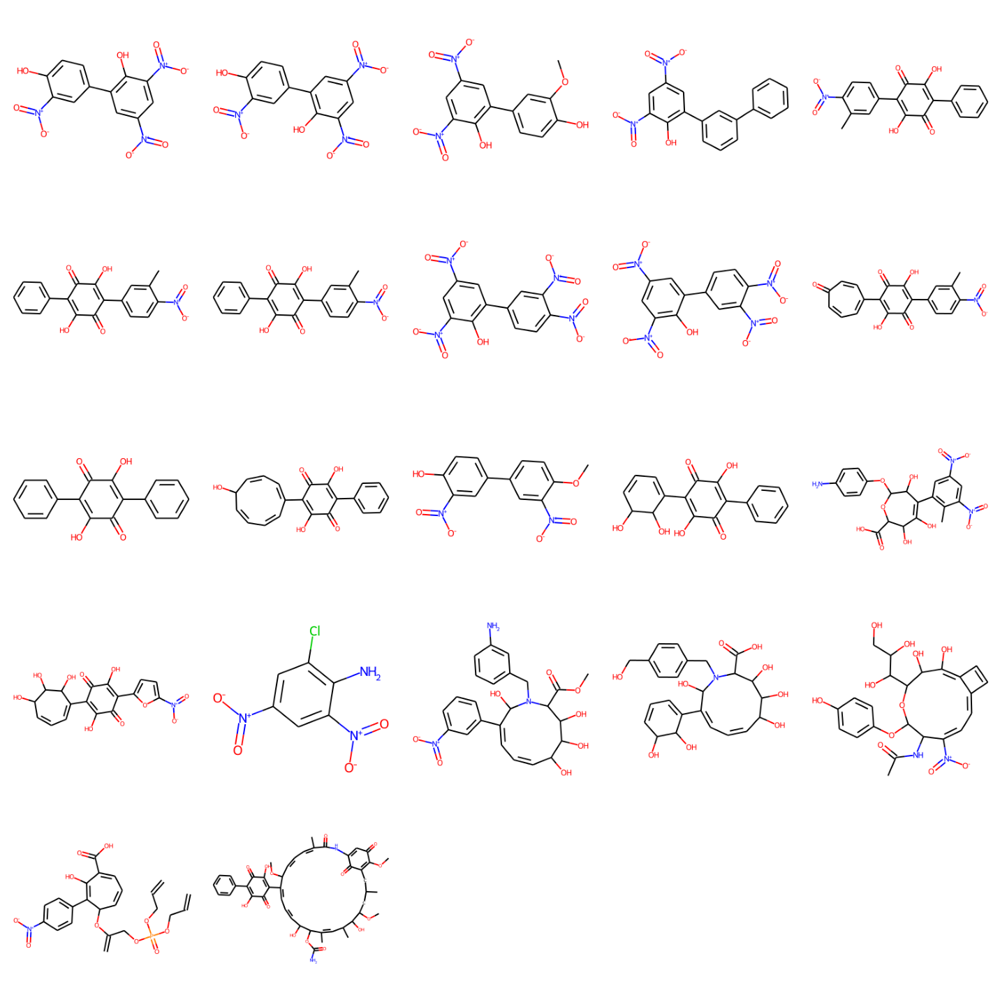

['c1(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc1Cl'
 '[O-][N+](=O)c1cc(-c2ccc(O)c([N+](=O)[O-])c2)c(O)c([N+](=O)[O-])c1'
 'Oc1c(-c2ccc(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cc(O)c(OC)cc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'C1(=O)C(O)=C(c2ccc([N+](=O)[O-])c(C)c2)C(=O)C(O)=C1c1ccccc1'
 'C1(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 'O=C1C(O)=C(c2ccc([N+](=O)[O-])c(C)c2)C(=O)C(O)=C1c1ccccc1'
 'c1ccccc1C1=C(O)C(=O)C(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C1=O'
 'O=[N+]([O-])c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1[N+](=O)[O-]'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 '[N+](=O)([O-])c1ccc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)cc1'
 '[N+](=O)([O-])c1cc(-c2ccc(O)c([N+](=O)[O-])c2)ccc1O'
 'c1(-c2ccc(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])ccc1O'
 'c1([N+](=O)[O-])cc([N+](=O)[O-])cc(-c2ccccc2)c1O'
 'C1(O)=C(c2ccccc2)C(=O)C(O)=C(c2ccccc2)C1=O'
 'c1ccccc1C1=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 'c1c([N+](=O)[O-])cc(-c2cccc(-c3

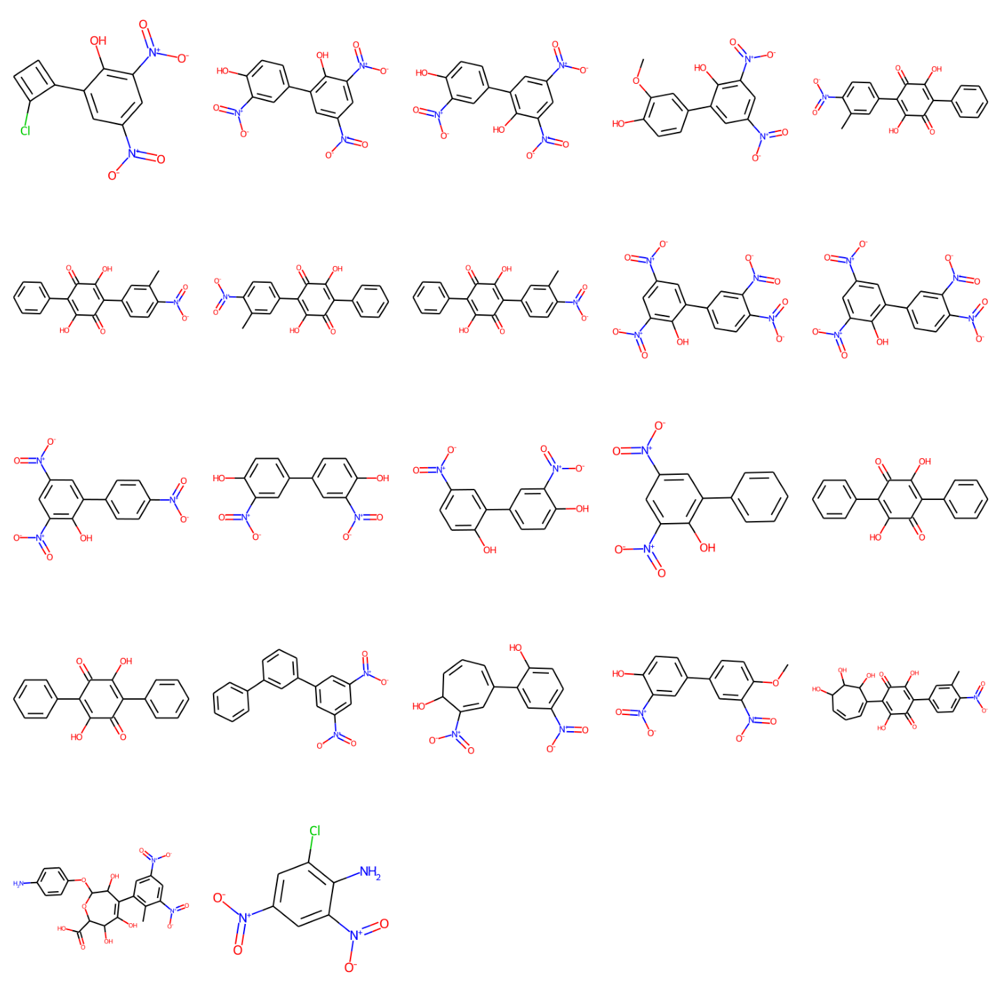

['c1(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc1Cl'
 'Oc1c(-c2ccc(O)c([N+](=O)[O-])c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'Oc1c(-c2ccc(O)c(OC)c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'c1cc(O)c(OC)cc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'O=[N+]([O-])c1ccc(C2=C(O)C(=O)C(c3ccccc3)=C(O)C2=O)cc1'
 'C1(c2ccc([N+](=O)[O-])c(C)c2)=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 'O=C1C(O)=C(c2ccc([N+](=O)[O-])c(C)c2)C(=O)C(O)=C1c1ccccc1'
 'OC1=C(c2ccccc2)C(=O)C(O)=C(c2ccc([N+](=O)[O-])c(C)c2)C1=O'
 'O=C1C(O)=C(c2ccccc2)C(=O)C(O)=C1c1ccc([N+](=O)[O-])c(C(F)(F)F)c1'
 'c1ccccc1C1=C(O)C(=O)C(c2ccc([N+](=O)[O-])c(C(F)(F)F)c2)=C(O)C1=O'
 '[N+](=O)([O-])c1cc(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)c(O)c([N+](=O)[O-])c1'
 'c1ccccc1C1=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 'Oc1c(-c2ccc(O)c([N+](=O)[O-])c2)C1O'
 'c1(O)c(-c2ccc(O)c([N+](=O)[O-])c2)C1O'
 'c1c([N+](=O)[O-])cc([N+](=O)[O-])c(O)c1C(=O)O'
 'C1(O)=C(C2=CC=CC(O)C(O)C2O)C(=O)C(O)=C(c2ccc([N+](=O)[O-])c(C)c2)C1=O'
 'c1(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)C(O)C1O'
 'O=[N

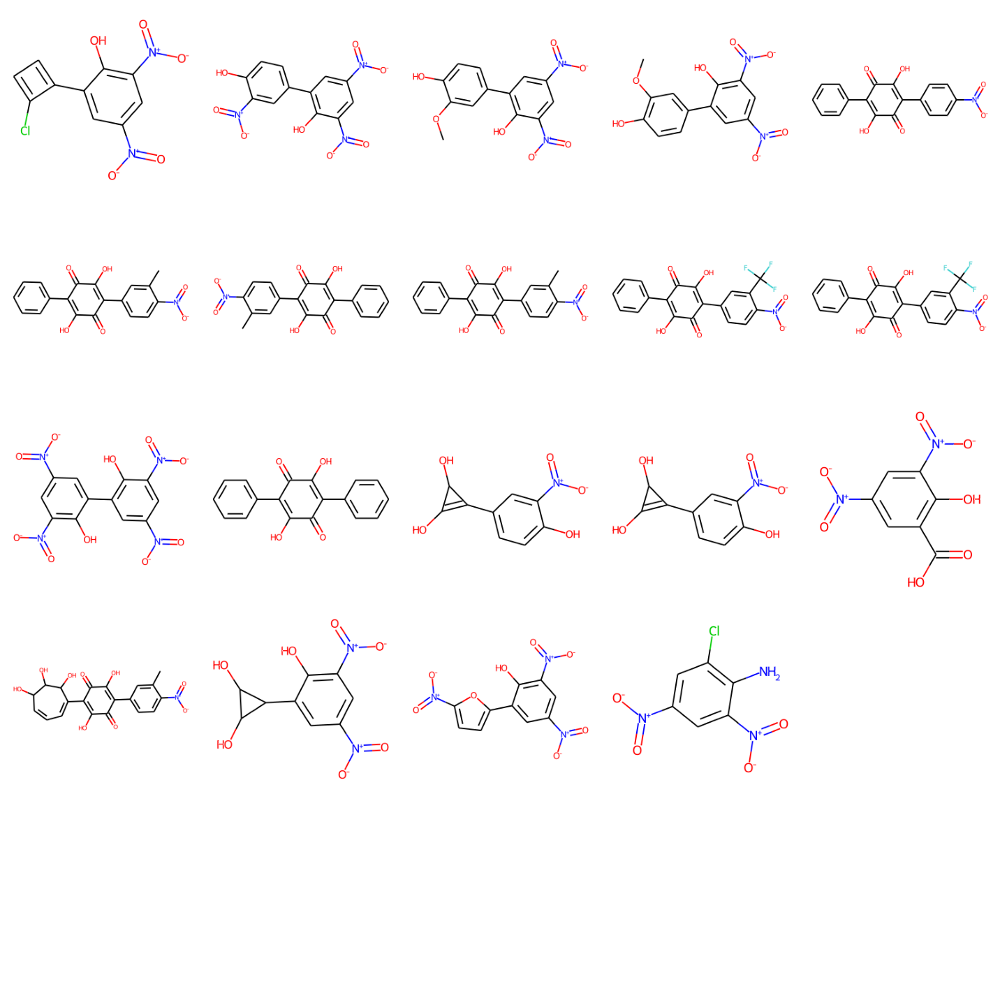

['c1(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)ccc1Cl'
 'c1cc(O)c(OC)cc1-c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1O'
 'c1(O)c(-c2ccc(O)c(OC)c2)cc([N+](=O)[O-])cc1[N+](=O)[O-]'
 'C1(=O)C(O)=C(c2ccccc2)C(=O)C(O)=C1c1ccc([N+](=O)[O-])cc1'
 'O=[N+]([O-])c1ccc(C2=C(O)C(=O)C(c3ccccc3)=C(O)C2=O)cc1'
 'C1(O)=C(c2ccc([N+](=O)[O-])cc2)C(=O)C(O)=C(c2ccccc2)C1=O'
 'c1ccccc1C1=C(O)C(=O)C(c2ccc([N+](=O)[O-])cc2)=C(O)C1=O'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc(O)c(O)c2)c1O'
 'c1(-c2ccc(O)c(OC)c2)cc([N+](=O)[O-])c(O)c([N+](=O)[O-])c1'
 'O=C1C(O)=C(c2ccc([N+](=O)[O-])c(C)c2)C(=O)C(O)=C1c1ccccc1'
 '[O-][N+](=O)c1cc([N+](=O)[O-])cc(-c2ccc([N+](=O)[O-])c([N+](=O)[O-])c2)c1O'
 'c1(-c2cc([N+](=O)[O-])cc([N+](=O)[O-])c2O)C(O)C(C(=O)NC)=C1'
 'O=C1C(O)=C(c2ccc([N+](=O)[O-])c(C(F)(F)F)c2)C(=O)C(O)=C1c1ccccc1'
 'c1ccccc1C1=C(O)C(=O)C(c2ccc([N+](=O)[O-])c(C(F)(F)F)c2)=C(O)C1=O'
 'c1ccccc1C1=C(O)C(=O)C(c2ccccc2)=C(O)C1=O'
 '[O-][N+](=O)c1cc(C2C(O)C2O)c(O)c([N+](=O)[O-])c1'
 'c1(O)c(-c2ccc(O)cc2)C(O)C1O']
skipped
skipp

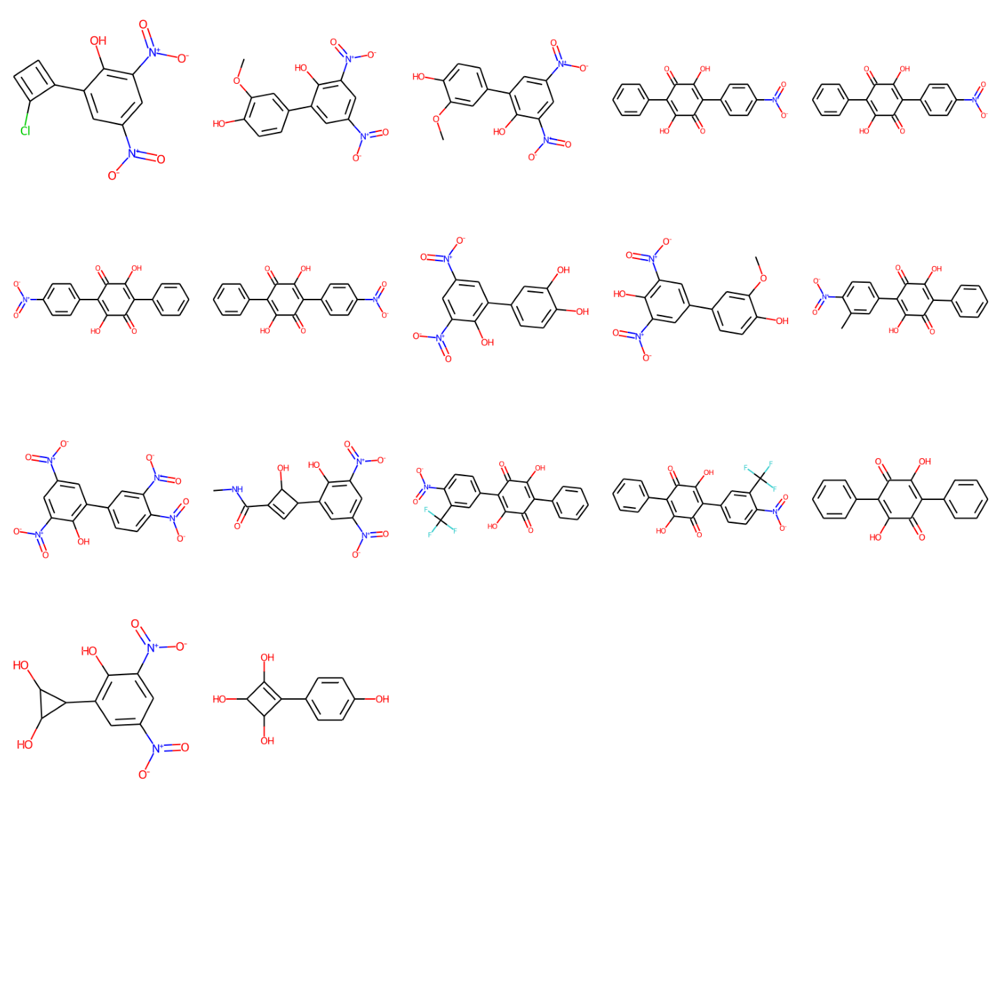

CPU times: user 8min 19s, sys: 27.4 s, total: 8min 47s
Wall time: 8min 11s


In [81]:
%%time

import os

# prepare a folder to save all the figures
ini_dir = './iQSPR_tutorial_smiles/'
if not os.path.exists(ini_dir):
    os.makedirs(ini_dir)

tmp_list = [x.sum(axis = 1, skipna = True).values for x in iqspr_results_reorder["loglike"]]

n_S = 25
for i, smis in enumerate(iqspr_results_reorder['samples']):
    tmp_smis = iqspr_results_reorder['samples'][i][
        np.argsort(tmp_list[i])[::-1]]
    print(tmp_smis)
    fig, ax = plt.subplots(5, 5)
    fig.set_size_inches(20, 20)
    fig.set_tight_layout(True)
    for j in range(n_S):
        xaxis = j // 5
        yaxis = j % 5
        try:
            img = Draw.MolToImage(AllChem.MolFromSmiles(tmp_smis[j]))
            ax[xaxis, yaxis].clear()
            ax[xaxis, yaxis].set_frame_on(False)
            ax[xaxis, yaxis].imshow(img)
        except:
            print("skipped")
            pass
        ax[xaxis, yaxis].set_axis_off()
    fig.savefig(ini_dir+'Step_%02i.png' % i,dpi = 500)
    plt.show()
    #plt.close()

In [82]:
target_smis = [AllChem.MolToSmiles(AllChem.MolFromSmiles(smi)) for i, smi in enumerate(data_ss['SMILES'])
       if ((data_ss['HOMO-LUMO gap'].iloc[i] <= 3) and (data_ss['E'].iloc[i] <= 200))]

In [83]:
print(target_smis)

['O=C1N=c2cc([N+](=O)[O-])c([N+](=O)[O-])cc2=NC1=O', 'O=C1C(O)=C(c2ccccc2)C(=O)C(O)=C1c1ccccc1', 'O=c1ccc2[n+]([O-])c3ccc(O)cc3oc-2c1', 'Nc1ccc2nc3ccccc3nc2c1N', 'Cc1cc(Cl)cc2c1C(=O)C(=C1Sc3cc(Cl)cc(C)c3C1=O)S2', 'Nc1ccc(N)c2c1C(=O)c1c(N)ccc(N)c1C2=O', 'COc1cc(N)c2c(c1N)C(=O)c1ccccc1C2=O', 'Nc1ccc(O)c2c1C(=O)c1ccccc1C2=O', 'CNc1ccc(N(CCO)CCO)cc1[N+](=O)[O-]', 'C1=Cc2c3ccccc3cc3c4c(cc1c23)=CCCC=4', 'O=C(CN1CCOCC1)NN=Cc1ccc([N+](=O)[O-])o1', 'CNc1ccc(O)c2c1C(=O)c1c(O)ccc(NC)c1C2=O', 'O=C1c2c(O)ccc(O)c2C(=O)c2c(O)ccc(O)c21', 'O=C1C=CC(=C2C=CC(=O)C=C2)C=C1', 'c1ccc2c(c1)ccc1c2ccc2ccc3ccccc3c21', 'NC1=NC(=O)C2=C(CNC3C=CC(O)C3O)C=NC2=N1']


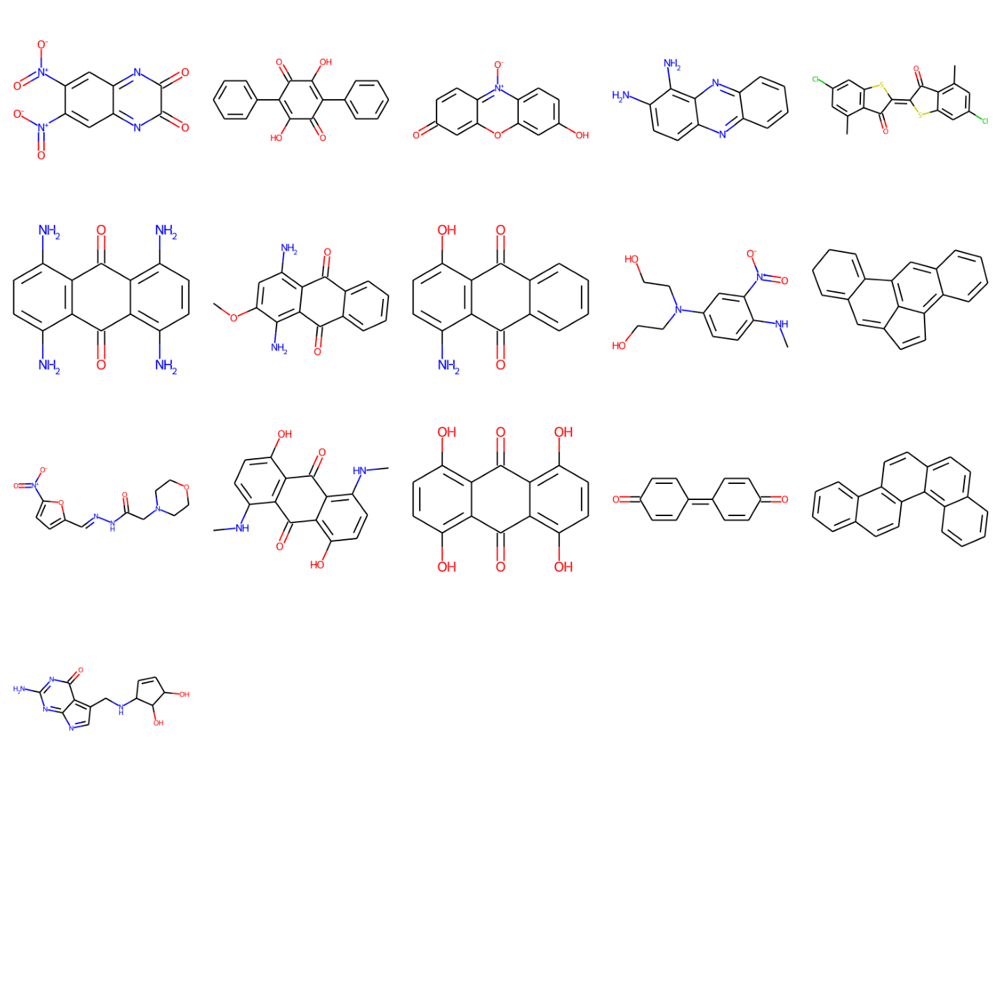

CPU times: user 8.7 s, sys: 568 ms, total: 9.27 s
Wall time: 8.56 s


In [84]:
%%time

import os

# prepare a folder to save all the figures
ini_dir = './iQSPR_tutorial_target_smiles/'
if not os.path.exists(ini_dir):
    os.makedirs(ini_dir)

n_S = 25

fig, ax = plt.subplots(5, 5)
fig.set_size_inches(20, 20)
fig.set_tight_layout(True)
for j in range(n_S):
    xaxis = j // 5
    yaxis = j % 5
    try:
        img = Draw.MolToImage(AllChem.MolFromSmiles(target_smis[j]))
        ax[xaxis, yaxis].clear()
        ax[xaxis, yaxis].set_frame_on(False)
        ax[xaxis, yaxis].imshow(img)
    except:
        pass
    ax[xaxis, yaxis].set_axis_off()
fig.savefig(ini_dir+'target_region.png',dpi = 500)
plt.show()
plt.close()

In [85]:
import os

In [89]:
image_folder = 'iQSPR_tutorial_smiles'
images = [img for img in os.listdir(image_folder) if img.endswith(".png")]
print(images)

['Step_38.png', 'Step_09.png', 'Step_20.png', 'Step_29.png', 'Step_02.png', 'Step_31.png', 'Step_06.png', 'Step_33.png', 'Step_01.png', 'Step_23.png', 'Step_12.png', 'Step_42.png', 'Step_25.png', 'Step_32.png', 'Step_10.png', 'Step_24.png', 'Step_14.png', 'Step_46.png', 'Step_48.png', 'Step_00.png', 'Step_45.png', 'Step_37.png', 'Step_35.png', 'Step_03.png', 'Step_18.png', 'Step_22.png', 'Step_44.png', 'Step_40.png', 'Step_16.png', 'Step_34.png', 'Step_17.png', 'Step_26.png', 'Step_28.png', 'Step_49.png', 'Step_08.png', 'Step_36.png', 'Step_15.png', 'Step_05.png', 'Step_47.png', 'Step_11.png', 'Step_07.png', 'Step_41.png', 'Step_19.png', 'Step_21.png', 'Step_30.png', 'Step_27.png', 'Step_43.png', 'Step_04.png', 'Step_39.png', 'Step_13.png']


In [91]:
import cv2
import os

image_folder = 'iQSPR_tutorial_prd'
video_name = 'video.avi'

images = [img for img in os.listdir(image_folder) if img.endswith(".png")]
frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape

video2 = cv2.VideoWriter(video_name, 0, 1, (width,height))

for image in images:
    video2.write(cv2.imread(os.path.join(image_folder, image)))

cv2.destroyAllWindows()
video2.release()

In [2]:
print(image)

['Step34.png', 'Step19.png', 'Step0.png', 'Step40.png', 'Step15.png', 'Step2.png', 'Step18.png', 'Step3.png', 'Step17.png', 'Step6.png', 'Step38.png', 'Step8.png', 'Step14.png', 'Step39.png', 'Step11.png', 'Step20.png', 'Step24.png', 'Step43.png', 'Step10.png', 'Step23.png', 'Step22.png', 'Step37.png', 'Step5.png', 'Step25.png', 'Step33.png', 'Step35.png', 'Step1.png', 'Step7.png', 'Step16.png', 'Step30.png', 'Step28.png', 'Step27.png', 'Step4.png', 'Step42.png', 'Step36.png', 'Step29.png', 'Step12.png', 'Step9.png', 'Step26.png', 'Step44.png', 'Step21.png', 'Step32.png', 'Step31.png', 'Step49.png', 'Step41.png']


In [1]:
import cv2
import os

image_folder = 'iQSPR_tutorial'
video_name = 'video_tutorial.avi'

images = [img for img in os.listdir(image_folder) if img.endswith(".png")]
frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape

video = cv2.VideoWriter(video_name, 0, 1, (width,height))

for image in images:
    video.write(cv2.imread(os.path.join(image_folder, image)))

cv2.destroyAllWindows()
video.release()

In [ ]:
import numpy as np

In [ ]:
np.__version__

In [ ]:
from xenonpy.descriptor import Fingerprints

RDKit_FPs = Fingerprints(featurizers=['ECFP', 'MACCS'], input_type='smiles')

In [ ]:
tmp_FPs = RDKit_FPs.transform(data['SMILES'])
print(tmp_FPs.head())


In [ ]:
from xenonpy.inverse.iqspr import GaussianLogLikelihood

# write down list of property name(s) for forward models and decide the target region
# (they will be used as a key in whole iQSPR run)
prop = ['E','HOMO-LUMO gap']
target_range = {'E': (0,200), 'HOMO-LUMO gap': (-np.inf, 3)}

# import descriptor class to iQSPR and set the target of region of the properties
prd_mdls = GaussianLogLikelihood(descriptor=RDKit_FPs, targets = target_range)

# train forward models inside iQSPR
prd_mdls.fit(data['SMILES'], data[prop])

# target region can also be updated afterward
prd_mdls.update_targets(reset=True,**target_range)

In [ ]:
prd_mdls['E']

In [ ]:
%%time

pred = prd_mdls.predict(data['SMILES'])
print(pred.head())

In [ ]:
merged = pd.read_csv("merge_example_2.0_melting_temp_merged_with_deleted.csv")
first_trial = merged[['Polymer_ID','Melting_Temperature','Glass_Temperature','Mol_File_SMILES_y']]

In [ ]:
first_trial

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(first_trial['Glass_Temperature'],first_trial['Melting_Temperature'],s=15,c='b',alpha = 0.1)
plt.title('iQSPR data')
plt.xlabel('Glass_temperature')
plt.ylabel('Melting_temperature')
plt.show()

In [ ]:
tmp_FPs = RDKit_FPs.transform(first_trial['Mol_File_SMILES_y'])
print(tmp_FPs.head())

In [ ]:
%%time

# Forward model template in XenonPy-iQSPR
from xenonpy.inverse.iqspr import GaussianLogLikelihood

# write down list of property name(s) for forward models and decide the target region
# (they will be used as a key in whole iQSPR run)
prop = ['Glass_Temperature','Melting_Temperature']
target_range = {'Glass_Temperature': (200,300), 'Melting_Temperature': (400, 500)}

# import descriptor class to iQSPR and set the target of region of the properties
prd_mdls = GaussianLogLikelihood(descriptor=RDKit_FPs, targets = target_range)

# train forward models inside iQSPR
prd_mdls.fit(first_trial['Mol_File_SMILES_y'],first_trial[prop])

# target region can also be updated afterward
prd_mdls.update_targets(reset=True,**target_range)

In [ ]:
prd_mdls['Glass_Temperature']

In [ ]:
%%time

pred = prd_mdls.predict(first_trial['Mol_File_SMILES_y'])
print(pred.head())
pred.info()
pred.max()

In [ ]:
%%time

# calculate log-likelihood for a given target property region
tmp_ll = prd_mdls(first_trial['Mol_File_SMILES_y'], **target_range)
#remove those values with np.inf or -np.if 
tmp_ll = tmp_ll.replace([np.inf, -np.inf], np.nan).dropna(axis=0)
print(tmp_ll.head())

In [ ]:
tmp_ll.info()

In [ ]:
tmp_ll.min()

In [ ]:
# plot histogram of log-likelihood values
tmp = tmp_ll.sum(axis = 1, skipna = True)
k = tmp.replace([np.inf, -np.inf], np.nan).dropna(axis=0)
plt.figure(figsize=(8,5))
plt.hist(k,bins = 100)
plt.title('ln(likelihood) for SMILES in the data set')
plt.xlabel('ln(likelihood)')
plt.ylabel('Counts')
plt.show()

# plot histogram of likelihood values
plt.figure(figsize=(8,5))
plt.hist(np.exp(k), bins=50)
plt.title('Likelihood for SMILES in the data set')
plt.xlabel('Likelihood')
plt.ylabel('Counts')
plt.show()


#try removing those predicted values with inconsistency check np.inf and write code to remove those indexes

In [ ]:
# check the predicted likelihood
dot_scale = 0.1
l_std = np.sqrt(pred['Melting_Temperature: std']**2+pred['Glass_Temperature: std']**2)

plt.figure(figsize=(6,5))
rectangle = plt.Rectangle((0,0),200,3,fc='y',alpha=0.1)
plt.gca().add_patch(rectangle)
im = plt.scatter(pred['Melting_Temperature: mean'], pred['Glass_Temperature: mean'], s=l_std*dot_scale, c=np.exp(tmp),alpha = 0.2,cmap=plt.get_cmap('cool'))
plt.title('Pubchem data')
plt.xlabel('Melting_Temperature')
plt.ylabel('Glass_Temperature')
plt.colorbar(im)
plt.show()

In [ ]:
print(first_trial.shape[0])

In [ ]:
%%time

# forward model library from scikit-learn
#from sklearn.ensemble import RandomForestRegressor
#from sklearn.linear_model import ElasticNetCV
from sklearn.ensemble import GradientBoostingRegressor
#from sklearn.linear_model import ElasticNet
# xenonpy library for data splitting (cross-validation)
from xenonpy.datatools import Splitter

np.random.seed(201906)

# property name will be used as a reference for calling models
prop = ['Melting_Temperature','Glass_Temperature']

# prepare indices for cross-validation data sets
sp = Splitter(first_trial.shape[0], test_size=0, k_fold=10)

# initialize output variables
y_trues, y_preds = [[] for i in range(len(prop))], [[] for i in range(len(prop))]
y_trues_fit, y_preds_fit = [[] for i in range(len(prop))], [[] for i in range(len(prop))]
mdls = {key: [] for key in prop}

# cross-validation test
for iTr, iTe in sp.cv():
    x_train = first_trial['Mol_File_SMILES_y'].iloc[iTr]
    x_test = first_trial['Mol_File_SMILES_y'].iloc[iTe]

    fps_train = RDKit_FPs.transform(x_train)
    fps_test = RDKit_FPs.transform(x_test)

    y_train = first_trial[prop].iloc[iTr]
    y_test = first_trial[prop].iloc[iTe]
    for i in range(len(prop)):
        #mdl = RandomForestRegressor(500, n_jobs=-1, max_features='sqrt')
        #mdl = ElasticNetCV(cv=5)
        mdl = GradientBoostingRegressor(loss='ls')
        #mdl = ElasticNet(alpha=0.5)

        mdl.fit(fps_train, y_train.iloc[:,i])
        prd_train = mdl.predict(fps_train)
        prd_test = mdl.predict(fps_test)

        y_trues[i].append(y_test.iloc[:,i].values)
        y_trues_fit[i].append(y_train.iloc[:,i].values)
        y_preds[i].append(prd_test)
        y_preds_fit[i].append(prd_train)

        mdls[prop[i]].append(mdl)


In [ ]:
# plot results
for i, x in enumerate(prop):
    y_true = np.concatenate(y_trues[i])
    y_pred = np.concatenate(y_preds[i])
    y_true_fit = np.concatenate(y_trues_fit[i])
    y_pred_fit = np.concatenate(y_preds_fit[i])
    xy_min = min(np.concatenate([y_true,y_true_fit,y_pred,y_pred_fit]))*0.95
    xy_max = max(np.concatenate([y_true,y_true_fit,y_pred,y_pred_fit]))*1.05
    xy_diff = xy_max - xy_min

    plt.figure(figsize=(5,5))
    plt.scatter(y_pred_fit, y_true_fit, c='b', alpha=0.1, label='train')
    plt.scatter(y_pred, y_true, c='r', alpha=0.2, label='test')
    plt.text(xy_min+xy_diff*0.7,xy_min+xy_diff*0.05,'MAE: %5.2f' % np.mean(np.abs(y_true - y_pred)),fontsize=12)
    plt.title('Property: ' + x)
    plt.xlim(xy_min,xy_max)
    plt.ylim(xy_min,xy_max)
    plt.legend(loc='upper left')
    plt.xlabel('Prediction')
    plt.ylabel('Observation')
    plt.plot([xy_min,xy_max],[xy_min,xy_max],ls="--",c='k')
    plt.show()

In [ ]:
class bootstrap_fcn():
    def __init__(self, ms, var):
        self.Ms = ms
        self.Var = var
    def predict(self, x):
        val = np.array([m.predict(x) for m in self.Ms])
        return np.mean(val, axis = 0), np.sqrt(np.var(val, axis = 0) + self.Var)

# include basic measurement noise
c_var = {'Melting_Temperature': 600,'Glass_Temperature': 300}

# generate a dictionary for the final models used to create the likelihood
custom_mdls = {key: bootstrap_fcn(value, c_var[key]) for key, value in mdls.items()}

# import descriptor calculator and forward model to iQSPR
prd_mdls = GaussianLogLikelihood(descriptor=RDKit_FPs, targets=target_range, **custom_mdls)

In [ ]:
%%time

pred = prd_mdls.predict(first_trial['Mol_File_SMILES_y'])
print(pred.head())

# calculate log-likelihood for a given target property region
tmp_ll = prd_mdls.log_likelihood(first_trial['Mol_File_SMILES_y'])
tmp = tmp_ll.sum(axis = 1, skipna = True)

# plot histogram of likelihood values
plt.figure(figsize=(8,5))
plt.hist(np.exp(tmp), bins=50)
plt.title('Likelihood for SMILES in the data subset')
plt.xlabel('Likelihood')
plt.ylabel('Counts')
plt.show()

In [ ]:
# check the predicted likelihood
dot_scale = 0.5
l_std = np.sqrt(pred['Melting_Temperature: std']**2+pred['Glass_Temperature: std']**2)

plt.figure(figsize=(6,5))
rectangle = plt.Rectangle((200,400),100,100,fc='y',alpha=0.1)
plt.gca().add_patch(rectangle)
im = plt.scatter(pred['Glass_Temperature: mean'], pred['Melting_Temperature: mean'], s=l_std*dot_scale, c=np.exp(tmp),alpha = 0.2,cmap=plt.get_cmap('cool'))
plt.title('Trial_Data')
plt.xlabel('Glass_Temperature')
plt.ylabel('Melting_Temperature')
plt.colorbar(im)
plt.show()

In [ ]:
prior = pd.read_csv("Prior_model.csv")

In [ ]:
%%time
from xenonpy.inverse.iqspr import NGram
#default NGram model is 10, setting_train_order = 5 
#sample_order = 5 default
#default lower_bound to train_order and sample_order as =1 use atleast
#one character as a reference for generating the next character. 

n_gram = NGram()
n_gram.fit(prior['Mol_File_SMILES'], train_order = 10)

#add reorder probability and do a check!

In [ ]:
%%time
from xenonpy.inverse.iqspr import NGram
#default NGram model is 10, setting_train_order = 5 
#sample_order = 5 default
#default lower_bound to train_order and sample_order as =1 use atleast
#one character as a reference for generating the next character. 

n_gram_reorder = NGram(reorder_prob = 0.5)
n_gram_reorder.fit(prior['Mol_File_SMILES'], train_order = 10)

##try with the data provided by the authors

In [ ]:
with open('ngram_pubchem_ikebata_reO15_O10.obj', 'rb') as f:
    n_gram = pk.load(f)

# load a pre-trained n-gram from the pickle file
with open('ngram_pubchem_ikebata_reO15_O11to20.obj', 'rb') as f:
    n_gram2 = pk.load(f)

n_gram.merge_table(n_gram2)

In [ ]:
np.random.seed(201906) # fix the random seed
cans = [Chem.MolToSmiles(Chem.MolFromSmiles(smi)) for i, smi in enumerate(data_ss['SMILES'])
       if (data_ss['HOMO-LUMO gap'].iloc[i] > 4)]
init_samples = np.random.choice(cans, 25)
print(init_samples)


In [ ]:
import pickle as pk
with open('ngram.obj', 'wb') as f:
    pk.dump(n_gram, f)

In [ ]:
np.random.seed(201903) # fix the random seed

# perform pure iQSPR molecule generation starting with 5 initial molecules
n_loop = 5
tmp = data_ss['SMILES'][:5]
for i in range(n_loop):
    tmp = n_gram.proposal(tmp)
    print('Round %i' % i,tmp)

In [ ]:
n_gram.set_params(del_range=[1,10],max_len=500, reorder_prob=0.5)

np.random.seed(201906) # fix the random seed

# perform pure iQSPR molecule generation starting with 10 PG molecules
n_loop = 5
tmp = prior['Mol_File_SMILES'][:5]
for i in range(n_loop):
    tmp = n_gram.proposal(tmp)
    print('Round %i' % i,tmp)

In [ ]:
from rdkit.Chem import AllChem

In [ ]:
np.random.seed(201906) # fix the random seed
cans = [smi for i, smi in enumerate(first_trial['Mol_File_SMILES_y'])
       if (first_trial['Melting_Temperature'].iloc[i] > 200)]
init_samples = np.random.choice(cans, 1000)
print(init_samples)


In [ ]:
# set up annealing schedule in iQSPR
beta = np.hstack([np.linspace(0.01,0.2,20),np.linspace(0.21,0.4,10),np.linspace(0.4,1,10),np.linspace(1,1,10)])
print('Number of steps: %i' % len(beta))
print(beta)

In [ ]:
%%time

# library for running iQSPR in XenonPy-iQSPR
from xenonpy.inverse.iqspr import IQSPR

# update NGram parameters for this exampleHOMO-LUMO gap
n_gram.set_params(del_range=[1,20],max_len=500, reorder_prob=0.5, sample_order=(1,20))

# set up likelihood and n-gram models in iQSPR
iqspr_reorder = IQSPR(estimator=prd_mdls, modifier=n_gram,r_ESS =1)

np.random.seed(201906) # fix the random seed
# main loop of iQSPR
#iqspr_samples1, iqspr_loglike1, iqspr_prob1, iqspr_freq1 = [], [], [], []
#for s, ll, p, freq in iqspr_reorder(init_samples, beta, yield_lpf=True):
    #iqspr_samples1.append(s)
    #iqspr_loglike1.append(ll)
    #iqspr_prob1.append(p)
    #iqspr_freq1.append(freq)
# record all outputs
#iqspr_results_reorder = {
    #"samples": iqspr_samples1,
    #"loglike": iqspr_loglike1,
    #"prob": iqspr_prob1,
    #"freq": iqspr_freq1,
    #"beta": beta
#}
# save results
#with open('iQSPR_results_reorder.obj', 'wb') as f:
    #pk.dump(iqspr_results_reorder, f)

In [ ]:
from xenonpy.inverse.iqspr import IQSPR

In [ ]:
iqspr_reorder = IQSPR(estimator=prd_mdls, modifier=n_gram,r_ESS = 1)

In [ ]:
iqspr_reorder

In [ ]:
iqspr_samples1, iqspr_loglike1, iqspr_prob1, iqspr_freq1 = [], [], [], []
for s, ll, p, freq in iqspr_reorder(init_samples,beta,yield_lpf = True):
    iqspr_samples1.append(s)
    iqspr_loglike1.append(ll)
    iqspr_prob1.append(p)
    iqspr_freq1.append(freq)

In [ ]:
iqspr_reorder.resample()

In [ ]:
iqspr_reorder

# XenonpyMDL

In [ ]:
from xenonpy.mdl import MDL

In [ ]:
mdl = MDL()
mdl

In [ ]:
query = mdl('glass')
query

In [ ]:
query.queryable